In [1]:
# Load necessary libraries
import sys
import os
import anndata as ad
import pandas as pd
import scanpy as sc
import seaborn as sns; sns.set(color_codes=True)



In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white', dpi_save=200)

scanpy==1.9.1 anndata==0.7.8 umap==0.5.3 numpy==1.22.3 scipy==1.9.3 pandas==1.5.1 scikit-learn==1.1.3 statsmodels==0.13.2 python-igraph==0.10.2 pynndescent==0.5.7


In [3]:
sc.logging.print_header()

scanpy==1.9.1 anndata==0.7.8 umap==0.5.3 numpy==1.22.3 scipy==1.9.3 pandas==1.5.1 scikit-learn==1.1.3 statsmodels==0.13.2 python-igraph==0.10.2 pynndescent==0.5.7


In [4]:
import glob
inFiles = glob.glob('McmExport/*GliaID.csv')
inFiles

['McmExport/10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6_1796_GliaID.csv',
 'McmExport/10122021_BaharehNP_ADCortex_EDTA_3196_GliaID.csv',
 'McmExport/10202021_BaharehNP_2997-ADCortex_EDTA_2997_GliaID.csv',
 'McmExport/10222021_BaharehNP_1873_CtrlCortex_1873_GliaID.csv',
 'McmExport/11092021_BaharehNP_3026CtlCorte_3026_GliaID.csv',
 'McmExport/11162021_Bahareh-3155_EDTA_3155_GliaID.csv',
 'McmExport/12032021-Bahareh_3280_Alz_3280_GliaID.csv',
 'McmExport/12252021_Bahareh-3628-Cntr_3628_GliaID.csv']

In [5]:
detDF = pd.read_csv('McmExport/detection_measurements_post_threshold_IDs.tsv',sep='\t')
detDF

,Image,Name,Class,Parent,ROI,Centroid X µm,Centroid Y µm,Distance to annotation PlaquesA µm,Area µm^2,Length µm,...,ROI: 0.38 µm per pixel: ApoE: Mean,ROI: 0.38 µm per pixel: P2Rx7: Mean,ROI: 0.38 µm per pixel: S100B: Mean,ROI: 0.38 µm per pixel: Trem2: Mean,ROI: 0.38 µm per pixel: GalMac3: Mean,Distance to annotation Other µm,ROI: 0.38 µm per pixel: E5: Mean,Distance to annotation Cells µm,ROI: 0.38 µm per pixel: Olig-2: Mean,ROI: 0.38 µm per pixel: PSD95: Mean
0,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,7977.7,3020.70,0.0,36.6754,31.7712,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,7321.6,6200.20,0.0,111.0254,81.4677,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,5551.9,245.48,0.0,759.0207,270.2663,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,2838.1,856.15,0.0,401.0899,134.0395,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,6927.1,598.48,0.0,91.2984,51.7777,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999797,10222021_BaharehNP_1873_CtrlCortex.qptiff - re...,Cells,Cells,White Matter,Polygon,7519.7,2665.20,NaN,NaN,NaN,...,4.1276,NaN,29.3601,45.3392,17.3088,NaN,NaN,NaN,NaN,NaN
999798,10222021_BaharehNP_1873_CtrlCortex.qptiff - re...,Cells,Cells,White Matter,Polygon,7482.0,2672.60,NaN,NaN,NaN,...,7.0301,NaN,30.4052,53.1583,23.1544,NaN,NaN,NaN,NaN,NaN
999799,10222021_BaharehNP_1873_CtrlCortex.qptiff - re...,Cells,Cells,White Matter,Polygon,7521.0,2680.60,NaN,NaN,NaN,...,6.0295,NaN,23.9912,50.8257,33.4617,NaN,NaN,NaN,NaN,NaN
999800,10222021_BaharehNP_1873_CtrlCortex.qptiff - re...,Cells,Cells,White Matter,Polygon,7465.3,2679.50,NaN,NaN,NaN,...,7.0924,NaN,45.4848,47.0565,25.5871,NaN,NaN,NaN,NaN,NaN


In [6]:
neuDF = detDF[detDF.Class=='Neurons']
neuDF = neuDF[neuDF.Parent!='Image']
neuDF[['Image','Parent']].groupby(['Image','Parent']).size()

Image                                                                Parent      
10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.qptiff - resolution #1  Grey Matter     13982
                                                                     White Matter      623
10122021_BaharehNP_ADCortex_EDTA.qptiff - resolution #1              Grey Matter     14814
                                                                     White Matter      675
10202021_BaharehNP_2997-ADCortex_EDTA.qptiff - resolution #1         Grey Matter     17208
                                                                     White Matter      745
10222021_BaharehNP_1873_CtrlCortex.qptiff - resolution #1            Grey Matter     12389
                                                                     White Matter      905
11092021_BaharehNP_3026CtlCorte.qptiff - resolution #1               Grey Matter     17583
                                                                     White Matter     1280
11162021

In [7]:
gliaDF = detDF[detDF.Class=='Glia']
print(gliaDF.shape)
gliaDF = gliaDF[gliaDF.numCellCentroids>0]
print(gliaDF.shape)
gliaDF = gliaDF[gliaDF['Area µm^2'] >=50]
gliaDF = gliaDF[gliaDF['Area µm^2']<=1500]

print(gliaDF.shape)
for im in gliaDF.Image.unique():
    print(gliaDF[gliaDF.Image==im].ID.values[:10])


(143996, 83)
(55686, 83)
(55624, 83)
[ 6.  7.  8. 10. 12. 15. 17. 18. 20. 23.]
[ 4.  7.  8. 11. 12. 13. 15. 16. 17. 18.]
[ 2.  5.  8.  9. 12. 14. 18. 19. 20. 23.]
[ 42.  46.  55.  59.  66.  67.  92. 263. 366. 440.]
[ 1.  2.  3.  4.  6.  8.  9. 10. 16. 17.]
[23. 26. 27. 29. 32. 34. 37. 46. 48. 52.]
[ 6.  8. 11. 13. 14. 15. 18. 19. 21. 23.]
[ 2.  3.  4.  7. 11. 13. 14. 19. 23. 25.]


In [8]:
imageIDMapQP = {'10202021_BaharehNP_2997-ADCortex_EDTA.qptiff - resolution #1':'2997',
       '11162021_Bahareh-3155_EDTA.qptiff - resolution #1':'3155',
       '10122021_BaharehNP_ADCortex_EDTA.qptiff - resolution #1':'3196',
       '12032021-Bahareh_3280_Alz.qptiff - resolution #1':'3280',
       '10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.qptiff - resolution #1':'1796',
       '12252021_Bahareh-3628-Cntr.qptiff - resolution #1':'3628',
       '11092021_BaharehNP_3026CtlCorte.qptiff - resolution #1':'3026',
       '10222021_BaharehNP_1873_CtrlCortex.qptiff - resolution #1':'1873'}
imageTypeMapQP = {'10202021_BaharehNP_2997-ADCortex_EDTA.qptiff - resolution #1':'AD',
       '11162021_Bahareh-3155_EDTA.qptiff - resolution #1':'AD',
       '10122021_BaharehNP_ADCortex_EDTA.qptiff - resolution #1':'AD',
       '12032021-Bahareh_3280_Alz.qptiff - resolution #1':'AD',
       '10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.qptiff - resolution #1':'Ctl',
       '12252021_Bahareh-3628-Cntr.qptiff - resolution #1':'Ctl',
       '11092021_BaharehNP_3026CtlCorte.qptiff - resolution #1':'Ctl',
       '10222021_BaharehNP_1873_CtrlCortex.qptiff - resolution #1':'Ctl'}

gliaDF.loc[:,'ImageID'] = gliaDF.Image.map(imageIDMapQP)
gliaDF.ID = gliaDF.ID.astype(int)

In [9]:
#gliaDF=gliaDF.dropna(axis=1)
gliaDF['Distance to annotation PlaquesA µm']

548       41.7411
549       56.7361
550       35.1756
552       79.0293
554       56.0247
           ...   
980532        NaN
980533        NaN
980534        NaN
980535        NaN
980538        NaN
Name: Distance to annotation PlaquesA µm, Length: 55624, dtype: float64

In [10]:
gliaDF.columns

Index(['Image', 'Name', 'Class', 'Parent', 'ROI', 'Centroid X µm',
       'Centroid Y µm', 'Distance to annotation PlaquesA µm', 'Area µm^2',
       'Length µm', 'Circularity', 'Solidity', 'Max diameter µm',
       'Min diameter µm', 'ROI: 0.38 µm per pixel: DAPI_1: Mean',
       'ROI: 0.38 µm per pixel: Neurofilament: Mean',
       'ROI: 0.38 µm per pixel: Vimentin: Mean',
       'ROI: 0.38 µm per pixel: CD31: Mean',
       'ROI: 0.38 µm per pixel: Claudin5: Mean',
       'ROI: 0.38 µm per pixel: SMA: Mean',
       'ROI: 0.38 µm per pixel: AQP4: Mean',
       'ROI: 0.38 µm per pixel: A-Beta: Mean',
       'ROI: 0.38 µm per pixel: HLA-A: Mean',
       'ROI: 0.38 µm per pixel: GFAP: Mean',
       'ROI: 0.38 µm per pixel: iNOS: Mean',
       'ROI: 0.38 µm per pixel: CD8: Mean',
       'ROI: 0.38 µm per pixel: CD44: Mean',
       'ROI: 0.38 µm per pixel: CD14: Mean',
       'ROI: 0.38 µm per pixel: P2Rx7(Park7): Mean',
       'ROI: 0.38 µm per pixel: P2Ry12: Mean',
       'ROI: 0.38 µm pe

In [11]:
gliaDF.loc[:,'ImageID_CellID'] = gliaDF.ImageID +'_'+ gliaDF.ID.astype(str)
gliaDF

,Image,Name,Class,Parent,ROI,Centroid X µm,Centroid Y µm,Distance to annotation PlaquesA µm,Area µm^2,Length µm,...,ROI: 0.38 µm per pixel: S100B: Mean,ROI: 0.38 µm per pixel: Trem2: Mean,ROI: 0.38 µm per pixel: GalMac3: Mean,Distance to annotation Other µm,ROI: 0.38 µm per pixel: E5: Mean,Distance to annotation Cells µm,ROI: 0.38 µm per pixel: Olig-2: Mean,ROI: 0.38 µm per pixel: PSD95: Mean,ImageID,ImageID_CellID
548,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Glia,Glia,Image,Polygon,6579.3,8080.800,41.7411,573.8603,176.4470,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2997,2997_6
549,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Glia,Glia,Image,Polygon,6605.3,8070.300,56.7361,79.2602,65.1971,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2997,2997_7
550,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Glia,Glia,Image,Polygon,6288.1,8056.400,35.1756,149.4831,62.6967,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2997,2997_8
552,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Glia,Glia,Image,Polygon,6599.4,8039.700,79.0293,88.8064,46.2195,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2997,2997_10
554,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Glia,Glia,Image,Polygon,6322.4,8026.800,56.0247,72.8513,46.4030,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2997,2997_12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
980532,10222021_BaharehNP_1873_CtrlCortex.qptiff - re...,Glia,Glia,White Matter,Polygon,6040.7,7.758,NaN,110.7424,49.8645,...,28.3811,29.2916,7.2890,NaN,NaN,NaN,NaN,NaN,1873,1873_12690
980533,10222021_BaharehNP_1873_CtrlCortex.qptiff - re...,Glia,Glia,White Matter,Polygon,5997.4,6.154,NaN,173.1964,85.7746,...,24.0230,33.6059,100.2742,NaN,NaN,NaN,NaN,NaN,1873,1873_12691
980534,10222021_BaharehNP_1873_CtrlCortex.qptiff - re...,Glia,Glia,White Matter,Polygon,3555.3,8.878,NaN,69.9335,53.4707,...,47.0524,14.4879,0.2097,NaN,NaN,NaN,NaN,NaN,1873,1873_12692
980535,10222021_BaharehNP_1873_CtrlCortex.qptiff - re...,Glia,Glia,White Matter,Polygon,3783.6,6.239,NaN,164.2249,67.4995,...,73.3517,30.0121,73.9767,NaN,NaN,NaN,NaN,NaN,1873,1873_12693


In [12]:
ID_ParentDict = pd.Series(gliaDF.Parent.values,index=gliaDF.ImageID_CellID).to_dict()
Dist_ParentDict = pd.Series(gliaDF['Distance to annotation PlaquesA µm'].values,index=gliaDF.ImageID_CellID).to_dict()
ID_AreaDict = pd.Series(gliaDF['Area µm^2'].values,index=gliaDF.ImageID_CellID).to_dict()
ID_numCellCentrDict = pd.Series(gliaDF['numCellCentroids'].values,index=gliaDF.ImageID_CellID).to_dict()


In [13]:
imageIDMap = {x:x.split('_')[-2] for x in inFiles}
imageIDMap

{'McmExport/10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6_1796_GliaID.csv': '1796',
 'McmExport/10122021_BaharehNP_ADCortex_EDTA_3196_GliaID.csv': '3196',
 'McmExport/10202021_BaharehNP_2997-ADCortex_EDTA_2997_GliaID.csv': '2997',
 'McmExport/10222021_BaharehNP_1873_CtrlCortex_1873_GliaID.csv': '1873',
 'McmExport/11092021_BaharehNP_3026CtlCorte_3026_GliaID.csv': '3026',
 'McmExport/11162021_Bahareh-3155_EDTA_3155_GliaID.csv': '3155',
 'McmExport/12032021-Bahareh_3280_Alz_3280_GliaID.csv': '3280',
 'McmExport/12252021_Bahareh-3628-Cntr_3628_GliaID.csv': '3628'}

In [14]:
imageTypeMap = {}
for x in inFiles:
    if ('AD' in x) or ('3155' in x) or ('Alz' in x):
        imageTypeMap[x] = 'AD'
    else:
        imageTypeMap[x] = 'Ctl'

In [15]:
imageTypeMap

{'McmExport/10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6_1796_GliaID.csv': 'Ctl',
 'McmExport/10122021_BaharehNP_ADCortex_EDTA_3196_GliaID.csv': 'AD',
 'McmExport/10202021_BaharehNP_2997-ADCortex_EDTA_2997_GliaID.csv': 'AD',
 'McmExport/10222021_BaharehNP_1873_CtrlCortex_1873_GliaID.csv': 'Ctl',
 'McmExport/11092021_BaharehNP_3026CtlCorte_3026_GliaID.csv': 'Ctl',
 'McmExport/11162021_Bahareh-3155_EDTA_3155_GliaID.csv': 'AD',
 'McmExport/12032021-Bahareh_3280_Alz_3280_GliaID.csv': 'AD',
 'McmExport/12252021_Bahareh-3628-Cntr_3628_GliaID.csv': 'Ctl'}

In [16]:
#reg001 = pd.read_csv('data/Ctl_1796_stardist.txt', sep='\t', header=0, index_col=0)
reg001 = []
#inFiles = ['McmExport/11092021_BaharehNP_3026CtlCorte_3026_GliaID.csv']
protNames =  []
for i,iF in enumerate(inFiles):
    print(iF)
    reg001.append(pd.read_csv(iF, sep=',', header=0, index_col=0))
    reg001[i].loc[:,'Image'] = iF


McmExport/10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6_1796_GliaID.csv
McmExport/10122021_BaharehNP_ADCortex_EDTA_3196_GliaID.csv
McmExport/10202021_BaharehNP_2997-ADCortex_EDTA_2997_GliaID.csv
McmExport/10222021_BaharehNP_1873_CtrlCortex_1873_GliaID.csv
McmExport/11092021_BaharehNP_3026CtlCorte_3026_GliaID.csv
McmExport/11162021_Bahareh-3155_EDTA_3155_GliaID.csv
McmExport/12032021-Bahareh_3280_Alz_3280_GliaID.csv
McmExport/12252021_Bahareh-3628-Cntr_3628_GliaID.csv


In [17]:
reg001[2]

,DAPI_1,Neurofilament,Vimentin,CD31,Claudin5,SMA,AQP4,A-Beta,Trem2,HLA-A,...,X_centroid,Y_centroid,Area,MajorAxisLength,MinorAxisLength,Eccentricity,Solidity,Extent,Orientation,Image
CellID,,,,,,,,,,,,,,,,,,,,,
1,10.253676,0.000000,6.327206,5.672794,0.308824,0.125000,130.705882,13.238971,26.783088,5.687500,...,17406.139706,21547.720588,272,27.431759,16.122568,0.809054,0.607143,0.394203,-1.329583,McmExport/10202021_BaharehNP_2997-ADCortex_EDT...
2,20.279461,3.585859,0.508418,18.141414,1.414141,0.124579,1.437710,0.404040,69.010101,3.797980,...,6627.346801,21498.282828,297,45.535754,11.961975,0.964879,0.655629,0.300607,-0.933815,McmExport/10202021_BaharehNP_2997-ADCortex_EDT...
3,8.784787,1.257885,5.089054,2.194805,0.775510,0.122449,19.660482,0.899814,12.593692,2.794063,...,17499.300557,21499.335807,539,72.781844,25.478405,0.936725,0.428118,0.222819,-0.576547,McmExport/10202021_BaharehNP_2997-ADCortex_EDT...
4,8.156951,0.000000,11.910314,0.215247,0.008969,0.053812,30.923767,3.215247,22.130045,3.156951,...,16452.183857,21478.780269,223,30.478580,21.173704,0.719292,0.461698,0.268029,-1.142454,McmExport/10202021_BaharehNP_2997-ADCortex_EDT...
5,7.632107,0.000000,23.391304,0.033445,0.000000,0.003344,42.107023,1.742475,9.762542,2.702341,...,16514.605351,21432.896321,299,47.501124,20.056842,0.906484,0.400268,0.302326,-0.174627,McmExport/10202021_BaharehNP_2997-ADCortex_EDT...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15335,69.920945,3.689938,7.833676,5.264887,0.995893,0.164271,11.002053,2.181725,54.209446,5.159138,...,23114.757700,15022.022587,974,83.063291,30.698541,0.929199,0.448848,0.280207,1.386848,McmExport/10202021_BaharehNP_2997-ADCortex_EDT...
15336,28.161648,20.321712,9.009509,8.270998,2.072900,0.218700,33.006339,1.792393,22.771791,5.109350,...,23037.538827,15009.733756,631,69.683372,37.823695,0.839866,0.314870,0.231305,0.196680,McmExport/10202021_BaharehNP_2997-ADCortex_EDT...
15337,12.261146,1.321656,6.703822,5.347134,1.439490,0.213376,142.503185,3.535032,24.388535,7.404459,...,23228.796178,14882.299363,314,37.419274,16.498368,0.897553,0.570909,0.349277,-0.640946,McmExport/10202021_BaharehNP_2997-ADCortex_EDT...


In [18]:
combinedDF = pd.concat(reg001)
#combinedDF = combinedDF[combinedDF['Centroid Y µm'] >= 4800]
combinedDF.reset_index(inplace=True)


combinedDF['ImageID'] = combinedDF.Image.map(imageIDMap)
combinedDF['ImageType'] = combinedDF.Image.map(imageTypeMap)
combinedDF['ImageID_CellID'] = combinedDF.ImageID +'_'+combinedDF.CellID.astype(str)
combinedDF['Parent'] = combinedDF.ImageID_CellID.map(ID_ParentDict)
combinedDF['Distance to nearest Plaque (µm)'] = combinedDF.ImageID_CellID.map(Dist_ParentDict)
combinedDF =combinedDF[combinedDF.ImageID_CellID.isin(gliaDF.ImageID_CellID)]
combinedDF['Area (µm^2)'] =combinedDF.ImageID_CellID.map(ID_AreaDict)
combinedDF['numCellCentroids'] =combinedDF.ImageID_CellID.map(ID_numCellCentrDict)

combinedDF.shape

(55624, 135)

In [19]:
combinedDF.Parent.value_counts()
combinedDF = combinedDF[combinedDF.Parent != 'Image']
combinedDF = combinedDF[combinedDF['CollagenIV']<=50]

In [20]:
combinedDF.shape

(48146, 135)

In [21]:
#protDF = combinedDF[[col for col in combinedDF.columns if 'Mean' in col and 'Cell:' in col]]
protDF = combinedDF[['IBA1','TMEM119','CD74','CD14','CD163','CD68','CD11b','CD11c','HLA-DR','CD45']]
protDF.head()

,IBA1,TMEM119,CD74,CD14,CD163,CD68,CD11b,CD11c,HLA-DR,CD45
1790,101.379061,16.263538,56.880866,26.812274,0.000000,48.924188,33.992780,0.000000,0.462094,0.000000
1794,96.642384,61.539735,160.172185,34.953642,0.000000,16.281457,29.092715,0.000000,3.552980,0.321192
1795,82.111872,63.764840,151.264840,50.716895,0.000000,57.497717,58.737443,2.191781,41.369863,14.942922
1796,101.519958,100.724790,90.309874,46.739496,0.000000,45.795168,27.327731,0.000000,3.967437,2.000000
1797,72.527778,81.807971,46.757246,63.545894,0.025362,23.134058,27.299517,1.250000,6.002415,23.978261


In [22]:
newNames = {col:col.split(':')[0] for col in protDF.columns}
protDF.rename(newNames, inplace=True, axis=1)
protDF.head()

/tmp/ipykernel_2508/1259486729.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  protDF.rename(newNames, inplace=True, axis=1)


,IBA1,TMEM119,CD74,CD14,CD163,CD68,CD11b,CD11c,HLA-DR,CD45
1790,101.379061,16.263538,56.880866,26.812274,0.000000,48.924188,33.992780,0.000000,0.462094,0.000000
1794,96.642384,61.539735,160.172185,34.953642,0.000000,16.281457,29.092715,0.000000,3.552980,0.321192
1795,82.111872,63.764840,151.264840,50.716895,0.000000,57.497717,58.737443,2.191781,41.369863,14.942922
1796,101.519958,100.724790,90.309874,46.739496,0.000000,45.795168,27.327731,0.000000,3.967437,2.000000
1797,72.527778,81.807971,46.757246,63.545894,0.025362,23.134058,27.299517,1.250000,6.002415,23.978261


In [23]:
protDF.columns

Index(['IBA1', 'TMEM119', 'CD74', 'CD14', 'CD163', 'CD68', 'CD11b', 'CD11c',
       'HLA-DR', 'CD45'],
      dtype='object')

In [24]:
keepCols = ['IBA1','TMEM119','CD74','GFAP','Vimentin','S100B','AQP4','NeuN','Neurofilament','MAP2','Synaptophysin','PCNA','P2Rx7','H2A.x']
keepCols = ['IBA1','GFAP','Vimentin','S100B','AQP4','NeuN','Neurofilament','MAP2','Synaptophysin',]
keepCols = ['IBA1','TMEM119','CD74','CD14','CD163','CD68','CD11b','CD11c','HLA-DR','CD45']
#keepCols = protDF.columns#[1:]
#['CD45','CD3e','CD4','CD8','CD68','CD11c','HLA-DR','HLA-A','CD163','CD14','PSD-95',
#keepCols = ['CD45','CD4','CD8','IBA1','TMEM119','CD68','NeuN','GFAP','S100B','MAP2','PCNA','P2Rx7(Park7)','H2A.x']
protDF = protDF[keepCols]
protDF

,IBA1,TMEM119,CD74,CD14,CD163,CD68,CD11b,CD11c,HLA-DR,CD45
1790,101.379061,16.263538,56.880866,26.812274,0.000000,48.924188,33.992780,0.000000,0.462094,0.000000
1794,96.642384,61.539735,160.172185,34.953642,0.000000,16.281457,29.092715,0.000000,3.552980,0.321192
1795,82.111872,63.764840,151.264840,50.716895,0.000000,57.497717,58.737443,2.191781,41.369863,14.942922
1796,101.519958,100.724790,90.309874,46.739496,0.000000,45.795168,27.327731,0.000000,3.967437,2.000000
1797,72.527778,81.807971,46.757246,63.545894,0.025362,23.134058,27.299517,1.250000,6.002415,23.978261
...,...,...,...,...,...,...,...,...,...,...
143982,77.266834,26.910636,88.995595,31.004405,1.336690,79.720579,24.765261,10.360604,50.636879,62.617369
143983,76.098765,82.711640,70.929453,32.929453,8.650794,65.997354,17.405644,9.693122,17.208995,66.381834
143986,54.984236,19.140887,43.787192,95.008867,32.512315,62.000985,13.285714,21.979310,23.772414,42.385222
143987,71.092265,17.787845,21.204972,46.888398,1.057459,62.761326,18.648619,12.508287,17.142541,80.383425


In [25]:
combinedDF.groupby('ImageType').size()

ImageType
AD     26275
Ctl    21871
dtype: int64

In [26]:
26275/4


6568.75

In [27]:
#spatialCols = ['Centroid X µm','Centroid Y µm','Cell: Area µm^2']
#spatialNames  = {'Centroid X µm':'spatial_X','Centroid Y µm': 'spatial_Y','Cell: Area µm^2': 'Area'}#,'Image':'ImageID'}
spatialCols = ['X_centroid','Y_centroid','Area','Area (µm^2)','ImageID','ImageType','Parent','Distance to nearest Plaque (µm)','ImageID_CellID','numCellCentroids']
spatialNames  = {'X_centroid':'spatial_X','Y_centroid': 'spatial_Y','Area': 'Area'}#,'Image':'ImageID'}

spatDF = combinedDF[spatialCols]
spatDF.rename(columns=spatialNames, inplace=True)
#spatDF['ImageID'] = spatDF.spatial_Y >= 4000
#spatDF['ImageID'] = spatDF['ImageID'].astype('int')
spatDF

/opt/conda/envs/rapids/lib/python3.8/site-packages/pandas/core/frame.py:5039: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


,spatial_X,spatial_Y,Area,Area (µm^2),ImageID,ImageType,Parent,Distance to nearest Plaque (µm),ImageID_CellID,numCellCentroids
1790,13574.364621,11980.732852,277,61.1722,1796,Ctl,Grey Matter,348.1208,1796_1791,1.0
1794,13491.046358,11876.990066,302,53.9108,1796,Ctl,Grey Matter,308.6889,1796_1795,1.0
1795,14676.054795,11854.070776,438,82.4693,1796,Ctl,Grey Matter,432.9919,1796_1796,1.0
1796,13395.029412,11854.349790,952,185.9480,1796,Ctl,Grey Matter,303.5456,1796_1797,1.0
1797,15292.282609,11814.693237,828,171.9872,1796,Ctl,Grey Matter,353.9196,1796_1798,1.0
...,...,...,...,...,...,...,...,...,...,...
143982,39.883575,15885.947766,1589,269.7662,3628,Ctl,White Matter,NaN,3628_19351,1.0
143983,331.334215,15758.689594,1134,204.2505,3628,Ctl,White Matter,NaN,3628_19352,1.0
143986,140.715271,15603.225616,1015,172.7699,3628,Ctl,White Matter,NaN,3628_19355,1.0
143987,129.878453,15529.645304,1810,347.2530,3628,Ctl,White Matter,NaN,3628_19356,1.0


In [28]:
# Load data
# combine the data and metadata file to generate the AnnData object
adata = ad.AnnData (protDF)
adata.obs = spatDF

/opt/conda/envs/rapids/lib/python3.8/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/opt/conda/envs/rapids/lib/python3.8/site-packages/anndata/_core/anndata.py:801: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [1790, 1794, 1795, 1796, 1797]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


In [29]:
adata.X

array([[101.37906   ,  16.263538  ,  56.880867  , ...,   0.        ,
          0.46209386,   0.        ],
       [ 96.64239   ,  61.539734  , 160.17218   , ...,   0.        ,
          3.5529802 ,   0.32119206],
       [ 82.11187   ,  63.76484   , 151.26485   , ...,   2.1917808 ,
         41.36986   ,  14.942923  ],
       ...,
       [ 54.984238  ,  19.140886  ,  43.787193  , ...,  21.979311  ,
         23.772413  ,  42.385223  ],
       [ 71.09226   ,  17.787846  ,  21.204973  , ...,  12.508287  ,
         17.142542  ,  80.38342   ],
       [ 67.747246  ,  25.038515  ,  27.981087  , ...,  20.807083  ,
         63.588375  ,  52.919533  ]], dtype=float32)

In [30]:
#adata2 = adata[adata.obs.spatial_Y >= 4800]
#adata = adata[adata.obs.spatial_Y < 4800]

In [31]:
#from scimap import rescale 

In [32]:
sc.pp.log1p(adata)
#adataScaled=sc.pp.scale(adata, max_value=10, copy=True)
sc.pp.combat(adata, key='ImageID', inplace=True)
adataScaled=sc.pp.scale(adata, max_value=10, copy=True)

#sc.pp.regress_out(adataScaled,keys='spatial_Y')
#adataScaled = rescale(adata,imageid = 'ImageID', failed_markers=['CD68'], save_fig=True)

/opt/conda/envs/rapids/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/opt/conda/envs/rapids/lib/python3.8/site-packages/anndata/_core/anndata.py:1241: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[key] = c
... storing 'ImageID' as categorical
/opt/conda/envs/rapids/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categ

Standardizing Data across genes.

Found 8 batches

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data



/opt/conda/envs/rapids/lib/python3.8/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [33]:
#adataScaled.obs.ImageID.value_counts().to_clipboard()

In [34]:
adataScaled

AnnData object with n_obs × n_vars = 48146 × 10
    obs: 'spatial_X', 'spatial_Y', 'Area', 'Area (µm^2)', 'ImageID', 'ImageType', 'Parent', 'Distance to nearest Plaque (µm)', 'ImageID_CellID', 'numCellCentroids'
    var: 'mean', 'std'
    uns: 'log1p'

In [35]:
adataScaled.obsm['X_spatial'] = adataScaled.obs[['spatial_X','spatial_Y']].values
adataScaled.obsm['X_spatial'][:,1] = -1*adataScaled.obsm['X_spatial'][:,1]
#adataScaled.write('../vitesscePy/QuPathDemo/1796allProt.h5ad')

In [36]:
import rapids_scanpy_funcs as rs


In [37]:
sc.tl.pca(adataScaled, svd_solver='arpack') # peform PCA
#sc.pl.pca(adataScaled, color=protDF.columns)
#sc.pl.pca(adataScaled, color=['ImageID'])


computing PCA
    with n_comps=9
    finished (0:00:00)


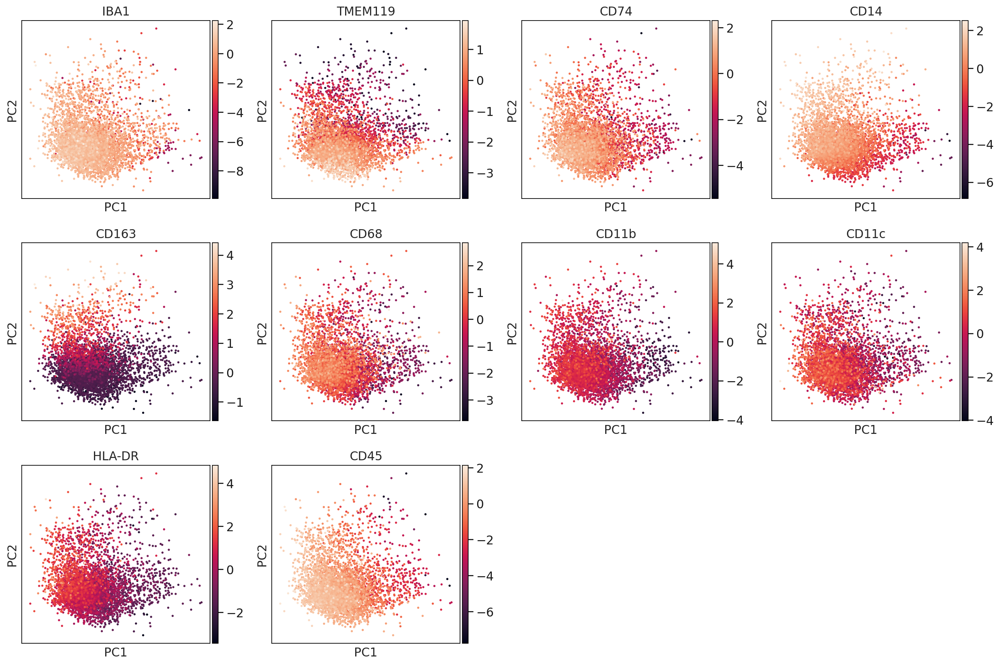

In [38]:
sc.pl.pca(sc.pp.subsample(adataScaled,fraction=0.1, copy=True), color=protDF.columns,use_raw=False)

In [39]:
adataScaled

AnnData object with n_obs × n_vars = 48146 × 10
    obs: 'spatial_X', 'spatial_Y', 'Area', 'Area (µm^2)', 'ImageID', 'ImageType', 'Parent', 'Distance to nearest Plaque (µm)', 'ImageID_CellID', 'numCellCentroids'
    var: 'mean', 'std'
    uns: 'log1p', 'pca'
    obsm: 'X_spatial', 'X_pca'
    varm: 'PCs'

In [40]:
sc.tl.tsne(adataScaled, perplexity=100)
#from cuml.manifold import TSNE
#adataScaled.obsm['X_tsne'] = TSNE(perplexity=30).fit_transform(adataScaled.obsm['X_pca'][:,:20])


computing tSNE
    using data matrix X directly
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:03:08)


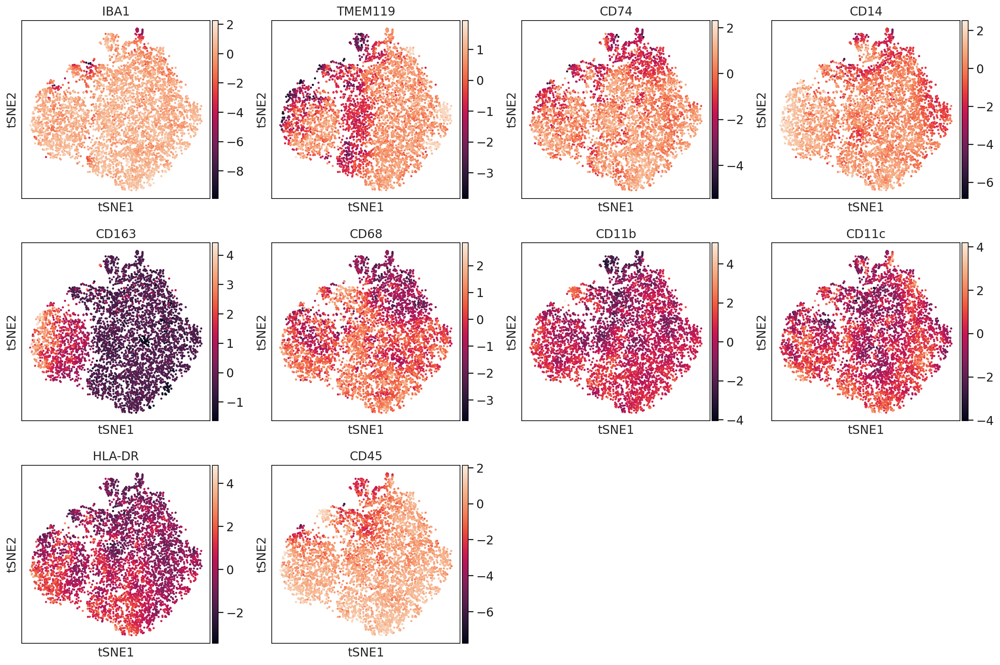

In [41]:
sc.pl.tsne(sc.pp.subsample(adataScaled,fraction=0.1, copy=True), color=protDF.columns,use_raw=False)

In [42]:

#sc.pp.neighbors(adataScaled, n_neighbors=30, n_pcs=20) # Computing the neighborhood graph
sc.pp.neighbors(adataScaled, n_neighbors=100, method='rapids') # Computing the neighborhood graph


computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:24)


In [43]:
adataScaled

AnnData object with n_obs × n_vars = 48146 × 10
    obs: 'spatial_X', 'spatial_Y', 'Area', 'Area (µm^2)', 'ImageID', 'ImageType', 'Parent', 'Distance to nearest Plaque (µm)', 'ImageID_CellID', 'numCellCentroids'
    var: 'mean', 'std'
    uns: 'log1p', 'pca', 'tsne', 'neighbors'
    obsm: 'X_spatial', 'X_pca', 'X_tsne'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [44]:
#sc.tl.umap(adataScaled,method='rapids') # Build a UMAP to visualize the neighbourhood graph


In [45]:
#sc.pl.umap(sc.pp.subsample(adataScaled,fraction=0.5, copy=True), color=protDF.columns, save='xx.png', use_raw=False)
import rapids_scanpy_funcs as rs


In [46]:
#tsne_n_pcs = 10
#adataScaled.obsm['X_tsne'] = TSNE(perplexity=100).fit_transform(adataScaled.X)


In [47]:
#sc.tl.leiden(adataScaled, resolution=0.6)
#sc.tl.leiden(adataScaled, resolution=1.0)
adataScaled.obs['leiden'] = rs.leiden(adataScaled, resolution=1.0)


In [48]:
sc.tl.louvain(adataScaled, resolution=1.0, flavor='rapids')

running Louvain clustering
    using the "louvain" package of rapids
    finished: found 11 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


In [49]:
#sc.tl.leiden(adataScaled, resolution=1.0)

In [50]:
#%%time

#adataScaled.obs['leiden'] = rs.leiden(adataScaled, resolution=1.0)
#adataScaled.obs['leiden_res2'] = rs.leiden(adataScaled, resolution=2)
#adataScaled.obs['leiden_res4'] = rs.leiden(adataScaled, resolution=4)

In [51]:
adataScaled

AnnData object with n_obs × n_vars = 48146 × 10
    obs: 'spatial_X', 'spatial_Y', 'Area', 'Area (µm^2)', 'ImageID', 'ImageType', 'Parent', 'Distance to nearest Plaque (µm)', 'ImageID_CellID', 'numCellCentroids', 'leiden', 'louvain'
    var: 'mean', 'std'
    uns: 'log1p', 'pca', 'tsne', 'neighbors', 'louvain'
    obsm: 'X_spatial', 'X_pca', 'X_tsne'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

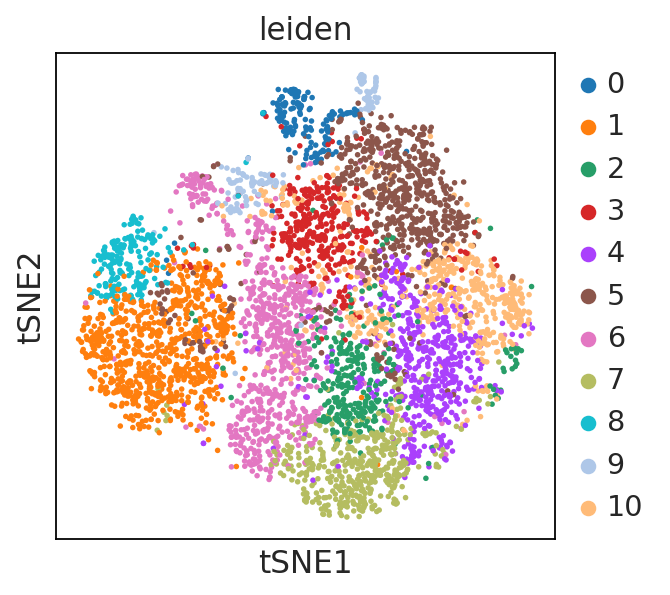

In [52]:
sc.pl.tsne(sc.pp.subsample(adataScaled,fraction=0.1, copy=True), color=['leiden'])

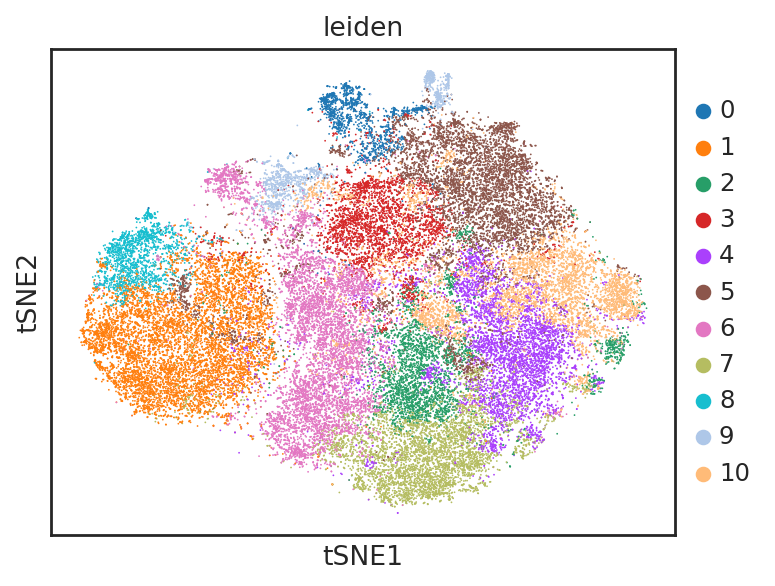

In [178]:
sc.pl.tsne(adataScaled, color=['leiden'])

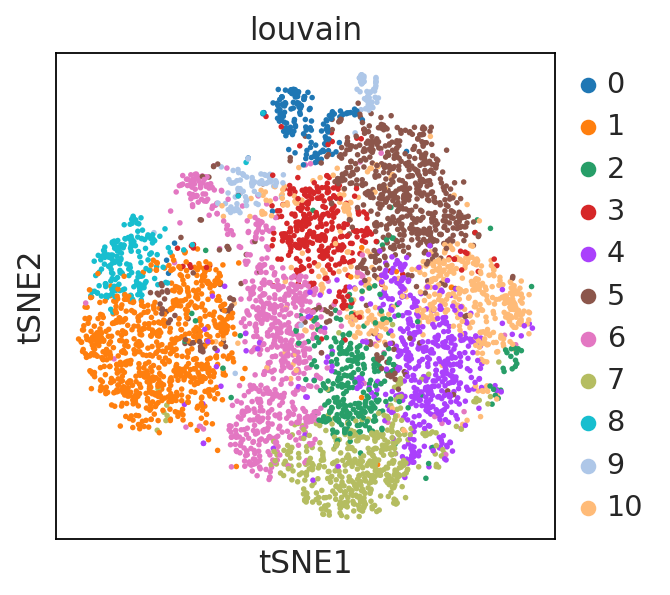

In [53]:
sc.pl.tsne(sc.pp.subsample(adataScaled,fraction=0.1, copy=True), color=['louvain'])

In [ ]:
imageTypeMapQPv2 = {'2997': 'AD-1',
 '3155': 'AD-2',
 '3196': 'AD-3',
 '3280': 'AD-4',
 '1796': 'Ctl-1',
 '3628': 'Ctl-2',
 '3026': 'Ctl-3',
 '1873': 'Ctl-4'}
adataScaled.obs['ImageTypev2'] = adataScaled.obs.ImageID.map(imageTypeMapQPv2)

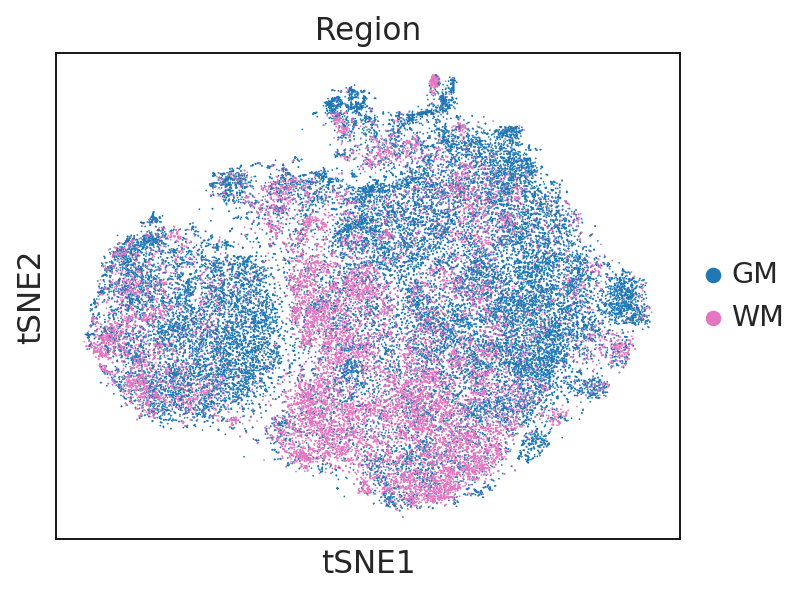

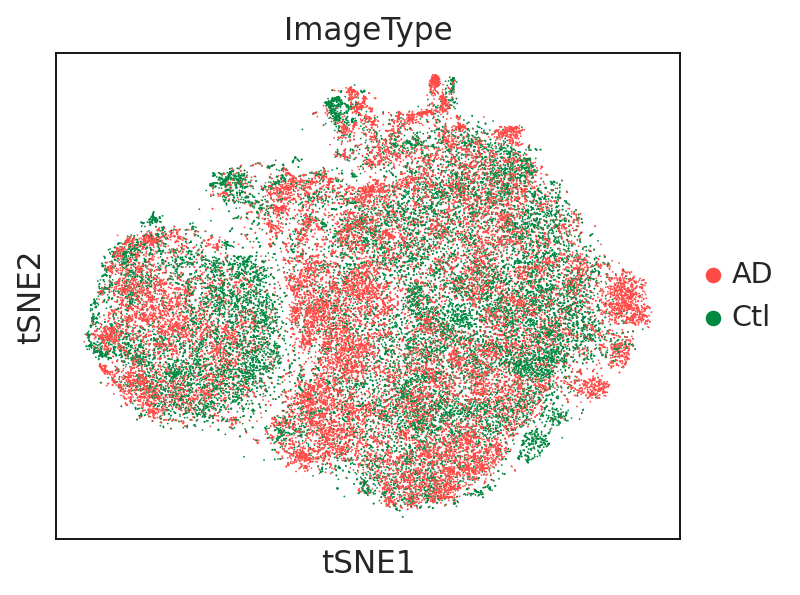

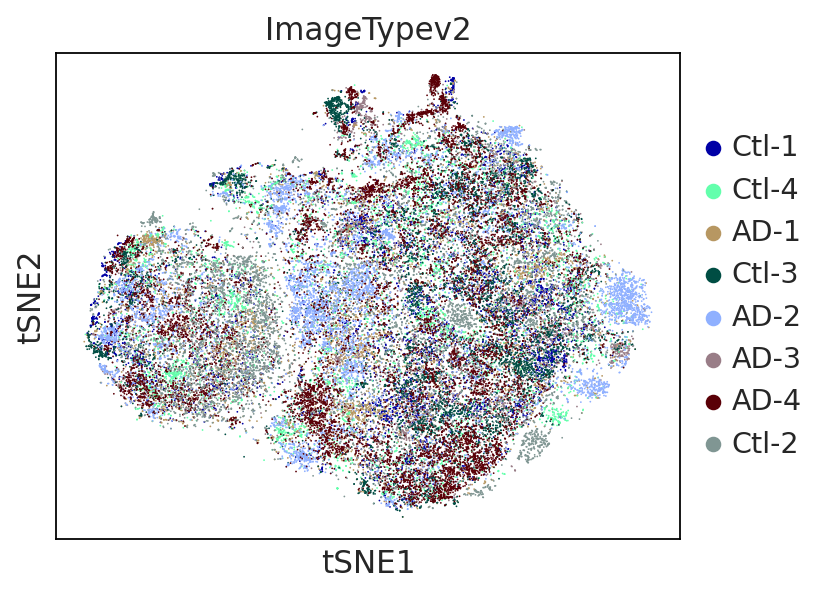

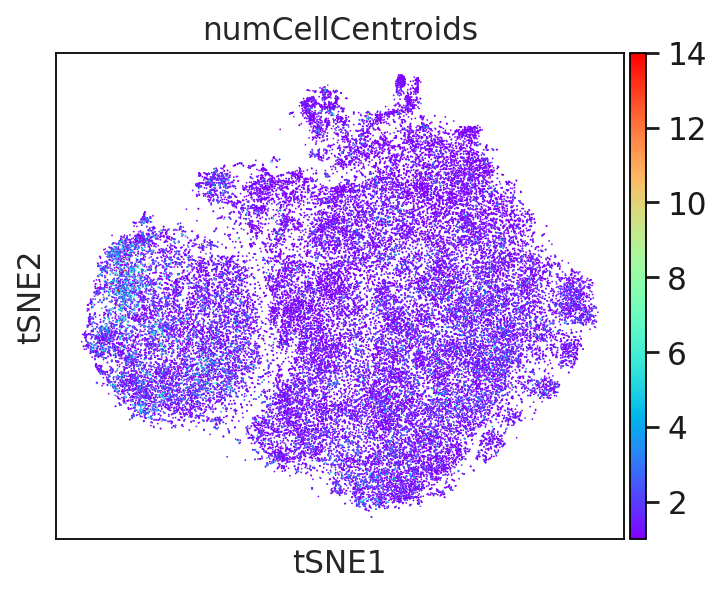

In [119]:
nameMap = {'Grey Matter':'GM','White Matter':'WM'}
adataScaled.obs.loc[:,'Region'] = adataScaled.obs.Parent.map(nameMap)
sc.pl.tsne(adataScaled, color=['Region'], palette=['tab:blue','tab:pink'])
sc.pl.tsne(adataScaled, color=['ImageType'], palette=sc.pl.palettes.godsnot_102[3:5])
sc.pl.tsne(adataScaled, color=['ImageTypev2'], palette=sc.pl.palettes.godsnot_102[9:17])#sns.color_palette('bright', as_cmap=True))#
sc.pl.tsne(adataScaled, color=['numCellCentroids'], cmap='rainbow')

In [113]:
sns.set_style('white')
sns.set(font="Arial")
import matplotlib as mpl
import matplotlib.pyplot as plt
plt.rcParams['mathtext.rm'] = 'Arial'

mpl.rcParams['font.family'] = 'Arial'
adataScaled.obs.groupby('ImageType').ImageID.unique()

ImageType
AD     ['3196', '2997', '3155', '3280']
Categories (8...
Ctl    ['1796', '1873', '3026', '3628']
Categories (8...
Name: ImageID, dtype: object

In [127]:
adataScaled

AnnData object with n_obs × n_vars = 48146 × 10
    obs: 'spatial_X', 'spatial_Y', 'Area', 'Area (µm^2)', 'ImageID', 'ImageType', 'Parent', 'Distance to nearest Plaque (µm)', 'ImageID_CellID', 'numCellCentroids', 'leiden', 'louvain', 'Region', 'ImageTypev2'
    var: 'mean', 'std'
    uns: 'log1p', 'pca', 'tsne', 'neighbors', 'louvain', 'Region_colors', 'ImageType_colors', 'ImageID_colors', 'leiden_colors', 'ImageTypev2_colors'
    obsm: 'X_spatial', 'X_pca', 'X_tsne'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [182]:
ordX = sorted(list(adataScaled.obs['ImageTypev2'].unique()))
cMapDict = {sorted(adataScaled.obs.leiden.unique())[i]: adataScaled.uns['leiden_colors'][i] for i in range(len(adataScaled.obs.leiden.unique()))}
cMapDict

{0: '#1f77b4',
 1: '#ff7f0e',
 2: '#279e68',
 3: '#d62728',
 4: '#aa40fc',
 5: '#8c564b',
 6: '#e377c2',
 7: '#b5bd61',
 8: '#17becf',
 9: '#aec7e8',
 10: '#ffbb78'}

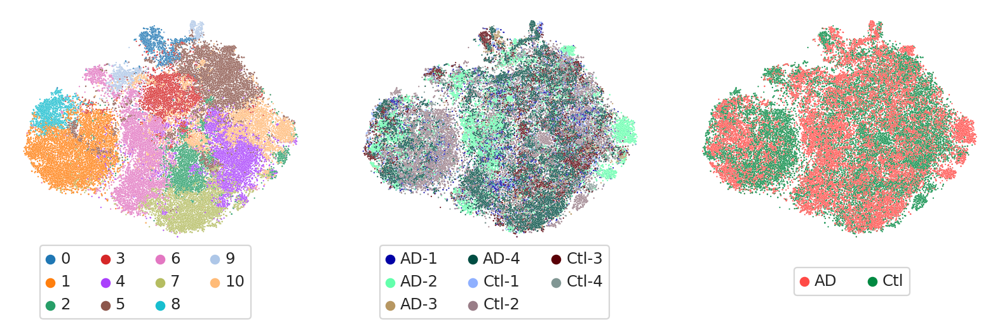

In [214]:
sc.settings.set_figure_params(dpi_save=300, facecolor='white',figsize=(5,4))
sns.set(font="Arial")

sns.set_style('white')
#sc.pl.tsne(adataScaled, color=['leiden','ImageTypev2','ImageType'], size=2,ncols=3,sort_order=False, save='_umapsV4.png')
fig,ax=plt.subplots(1,3, figsize=(10,3.5))
sns.scatterplot(data=adataScaled.obs, x=adataScaled.obsm['X_tsne'][:,0], y=adataScaled.obsm['X_tsne'][:,1],ax=ax[0],
                hue='leiden', palette=cMapDict,s=1,)
ax[0].legend(ncol=4,loc=(0.1,-0.3))
ax[0].axis('off')
ax[0].set_xlabel('tSNE1')
ax[0].set_ylabel('tSNE2')
sns.scatterplot(data=adataScaled.obs, x=adataScaled.obsm['X_tsne'][:,0], y=adataScaled.obsm['X_tsne'][:,1],ax=ax[1],
                hue='ImageTypev2', palette=sc.pl.palettes.godsnot_102[9:17],s=1,  hue_order=ordX)
ax[1].legend(ncol=3,loc=(0.1,-0.3))
ax[1].axis('off')
ax[1].set_xlabel('tSNE1')
ax[1].set_ylabel('tSNE2')

sns.scatterplot(data=adataScaled.obs, x=adataScaled.obsm['X_tsne'][:,0], y=adataScaled.obsm['X_tsne'][:,1],ax=ax[2],
                hue='ImageType', palette=sc.pl.palettes.godsnot_102[3:5],s=1, hue_order=['AD','Ctl'])
ax[2].axis('off')
ax[2].set_xlabel('tSNE1')
ax[2].set_ylabel('tSNE2')

ax[2].legend(ncol=4,loc=(0.35,-0.2))
plt.tight_layout()
plt.savefig('finalFiguresv4/tsne_MG.png', dpi=300)

In [54]:
adataScaled.obs

,spatial_X,spatial_Y,Area,Area (µm^2),ImageID,ImageType,Parent,Distance to nearest Plaque (µm),ImageID_CellID,numCellCentroids,leiden,louvain,Region
1790,13574.364621,11980.732852,277,61.1722,1796,Ctl,Grey Matter,348.1208,1796_1791,1.0,3,3,GM
1794,13491.046358,11876.990066,302,53.9108,1796,Ctl,Grey Matter,308.6889,1796_1795,1.0,3,3,GM
1795,14676.054795,11854.070776,438,82.4693,1796,Ctl,Grey Matter,432.9919,1796_1796,1.0,2,2,GM
1796,13395.029412,11854.349790,952,185.9480,1796,Ctl,Grey Matter,303.5456,1796_1797,1.0,3,3,GM
1797,15292.282609,11814.693237,828,171.9872,1796,Ctl,Grey Matter,353.9196,1796_1798,1.0,2,2,GM
...,...,...,...,...,...,...,...,...,...,...,...,...,...
143982,39.883575,15885.947766,1589,269.7662,3628,Ctl,White Matter,NaN,3628_19351,1.0,6,6,WM
143983,331.334215,15758.689594,1134,204.2505,3628,Ctl,White Matter,NaN,3628_19352,1.0,2,2,WM
143986,140.715271,15603.225616,1015,172.7699,3628,Ctl,White Matter,NaN,3628_19355,1.0,1,1,WM
143987,129.878453,15529.645304,1810,347.2530,3628,Ctl,White Matter,NaN,3628_19356,1.0,6,6,WM


In [55]:
adataScaled.obs.leiden.value_counts(sort=True)

1     7757
6     7272
5     6695
10    5162
4     5131
7     4753
3     3369
2     3258
8     1787
0     1608
9     1354
Name: leiden, dtype: int64

<AxesSubplot:ylabel='Frequency'>

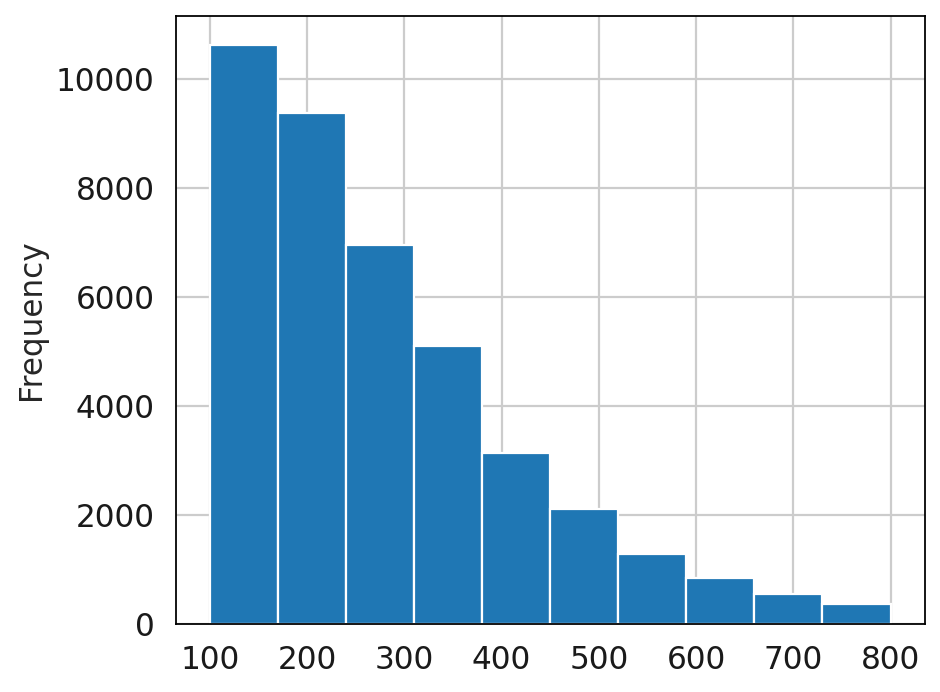

In [56]:
adataScaled.obs['Area (µm^2)'][(adataScaled.obs['Area (µm^2)']>100) & (adataScaled.obs['Area (µm^2)']<800)].plot(kind='hist', bins=10)

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_leiden']`


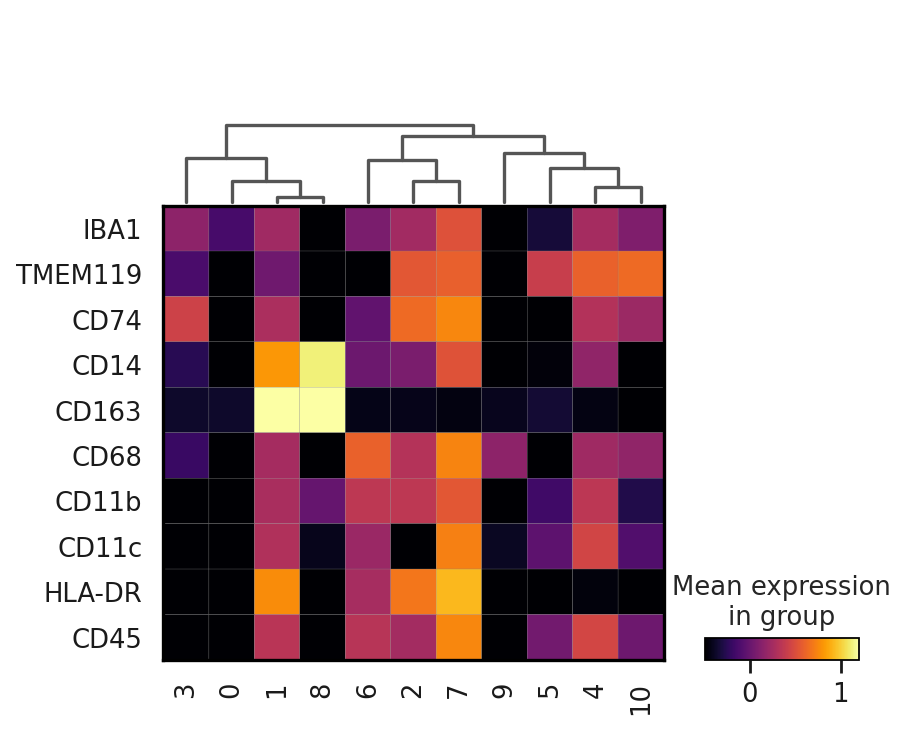

In [57]:
#ss = adataScaled[~adataScaled.obs.leiden.isin([11])]#sc.pp.subsample(adataScaled[adataScaled.obs.leiden!=10],fraction=0.8, copy=True)

sc.tl.dendrogram(adataScaled, groupby='leiden')
#adataScaled.obs['State'] ='c'+adataScaled.obs['smLeiden'].astype('str')
#sc.pl.matrixplot(adataScaled, var_names= rowOrder, groupby='leiden', 
#                 dendrogram=True, use_raw=False, cmap="viridis",standard_scale='var' ,vmin=0.5)
ax2 = sc.pl.matrixplot(adataScaled, var_names = protDF.columns,groupby='leiden', 
                 dendrogram=True, use_raw=False, cmap="inferno",standard_scale=None,vmin=-0.5,vmax=1.5, return_fig=True)
sc.pl.matrixplot(adataScaled, var_names = protDF.columns,groupby='leiden', 
                 dendrogram=True, use_raw=False, cmap="inferno",standard_scale=None,vmin=-0.50,vmax=1.2, return_fig=False,swap_axes=True)
#sc.pl.matrixplot(adataScaled, var_names = protDF.columns,groupby='leiden', 
#                 dendrogram=True, use_raw=False, cmap="inferno",standard_scale='var', return_fig=False,swap_axes=True)

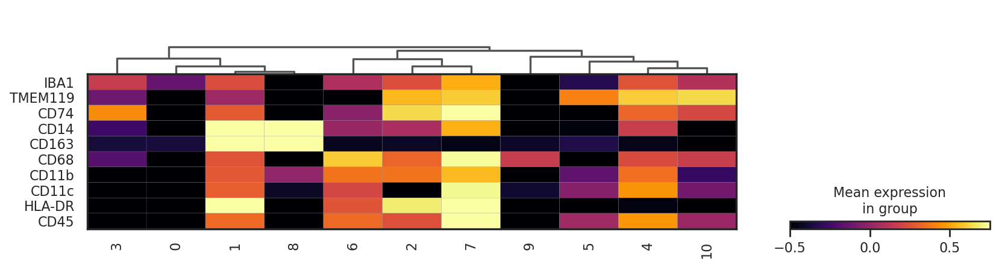

In [241]:
fig,ax=plt.subplots(1,1,figsize=(12,3))
sc.pl.matrixplot(adataScaled, var_names = protDF.columns,groupby='leiden', ax=ax,#figsize=(12,2.8),
                 dendrogram=True, use_raw=False, cmap="inferno",standard_scale=None,var_group_rotation=0,
                 vmin=-0.50,vmax=.75, return_fig=False,swap_axes=True, save='clustv2.png')



In [59]:
#sc.pl.matrixplot(adataScaled, var_names = protDF.columns,groupby='leiden', 
#                 dendrogram=True, use_raw=False, cmap="inferno",standard_scale='var', return_fig=False,swap_axes=True, save='_Clustering100um.png')

In [60]:
corrDF = protDF.corr('spearman')

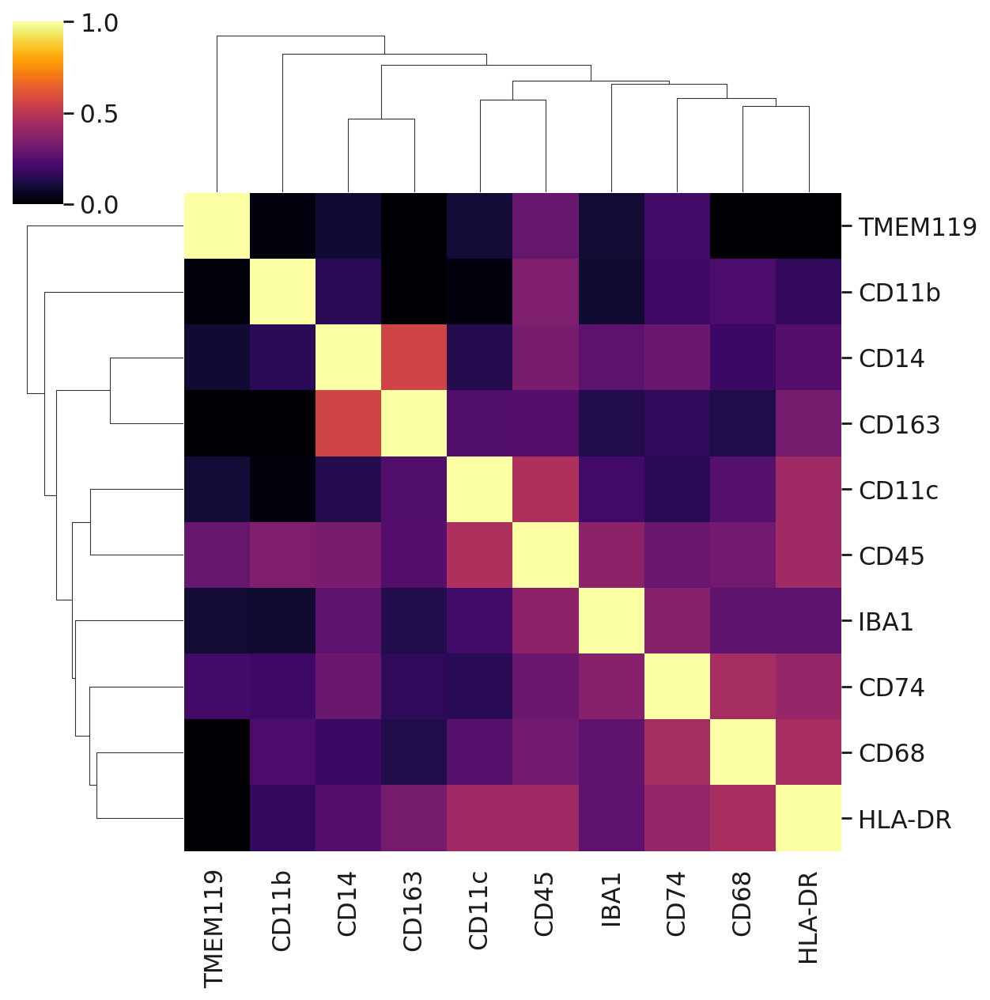

In [61]:
import matplotlib.pyplot as plt
#fig,ax=plt.subplots(1,1,figsize=(20,20))
ax3 = sns.clustermap(corrDF, vmin=0, vmax=1, figsize=(8,8),yticklabels=True, xticklabels=True, cmap='inferno')

In [62]:
adataScaled.obsm['X_spatial'] = adataScaled.obs[['spatial_X','spatial_Y']].values
adataScaled.obsm['X_spatial'][:,1] = -1*adataScaled.obsm['X_spatial'][:,1]
#adataScaled.write('../vitesscePy/QuPathDemo/1796allClusSubsetProt.h5ad')

In [63]:
#adataScaled.write_zarr('../vitesscePy/QuPathDemo/1796_subsetP.zarr')

In [64]:
ad.__version__

'0.7.8'

In [65]:
#ad.read_csv(

In [66]:
adataScaled.obs

,spatial_X,spatial_Y,Area,Area (µm^2),ImageID,ImageType,Parent,Distance to nearest Plaque (µm),ImageID_CellID,numCellCentroids,leiden,louvain,Region
1790,13574.364621,11980.732852,277,61.1722,1796,Ctl,Grey Matter,348.1208,1796_1791,1.0,3,3,GM
1794,13491.046358,11876.990066,302,53.9108,1796,Ctl,Grey Matter,308.6889,1796_1795,1.0,3,3,GM
1795,14676.054795,11854.070776,438,82.4693,1796,Ctl,Grey Matter,432.9919,1796_1796,1.0,2,2,GM
1796,13395.029412,11854.349790,952,185.9480,1796,Ctl,Grey Matter,303.5456,1796_1797,1.0,3,3,GM
1797,15292.282609,11814.693237,828,171.9872,1796,Ctl,Grey Matter,353.9196,1796_1798,1.0,2,2,GM
...,...,...,...,...,...,...,...,...,...,...,...,...,...
143982,39.883575,15885.947766,1589,269.7662,3628,Ctl,White Matter,NaN,3628_19351,1.0,6,6,WM
143983,331.334215,15758.689594,1134,204.2505,3628,Ctl,White Matter,NaN,3628_19352,1.0,2,2,WM
143986,140.715271,15603.225616,1015,172.7699,3628,Ctl,White Matter,NaN,3628_19355,1.0,1,1,WM
143987,129.878453,15529.645304,1810,347.2530,3628,Ctl,White Matter,NaN,3628_19356,1.0,6,6,WM


In [67]:
#adataScaled.obs.to_csv('1796_leiden.csv')
adataScaled.obs.ImageID.unique()

['1796', '3196', '2997', '1873', '3026', '3155', '3280', '3628']
Categories (8, object): ['1796', '1873', '2997', '3026', '3155', '3196', '3280', '3628']

In [68]:
len(adataScaled.uns['leiden_colors'])

11

In [69]:
cMapDict = {sorted(adataScaled.obs.leiden.unique())[i]: adataScaled.uns['leiden_colors'][i] for i in range(len(adataScaled.obs.leiden.unique()))}

In [70]:
cMapDict

{0: '#1f77b4',
 1: '#ff7f0e',
 2: '#279e68',
 3: '#d62728',
 4: '#aa40fc',
 5: '#8c564b',
 6: '#e377c2',
 7: '#b5bd61',
 8: '#17becf',
 9: '#aec7e8',
 10: '#ffbb78'}

In [71]:
#ss.uns['leiden_colors']

Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.


1796 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] 11
3196 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] 11
2997 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] 11
1873 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] 11
3026 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] 11
3155 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] 11


Trying to set attribute `._uns` of view, copying.
Trying to set attribute `._uns` of view, copying.


3280 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] 11
3628 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] 11


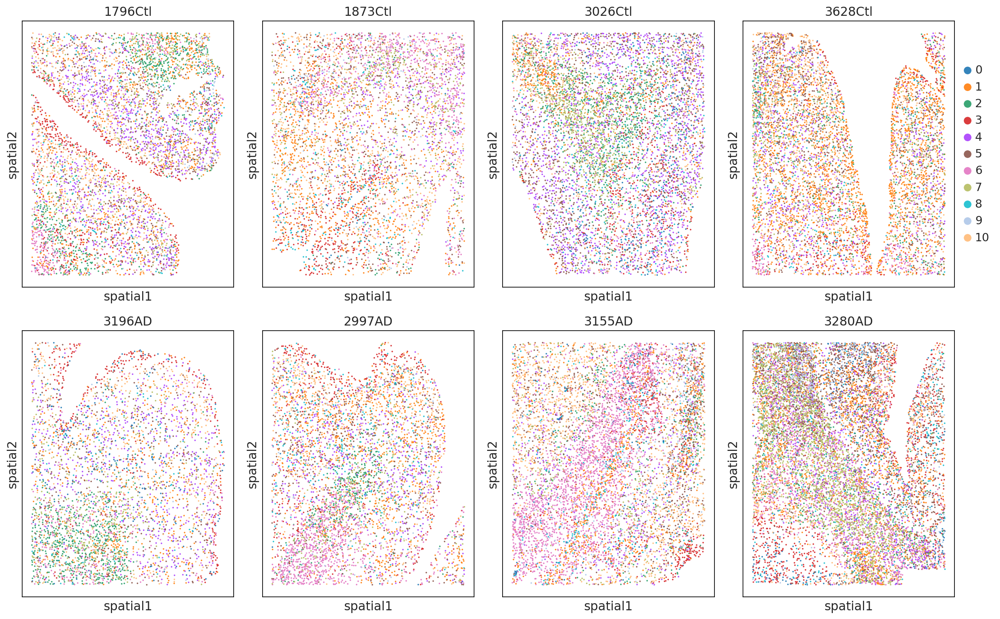

In [72]:
i = 0
j = 0
fig,ax=plt.subplots(2,4,figsize=(16,10))

for im in adataScaled.obs.ImageID.unique():
    ss = adataScaled[(adataScaled.obs.ImageID.isin([im]))]#sc.pp.subsample(adataScaled[adataScaled.obs.leiden!=10],fraction=0.8, copy=True)
    ss.uns['leiden_colors']=[cMapDict[int(x)] for x in range(len(ss.obs.leiden.unique()))]
    print(im, [x for x in sorted(ss.obs.leiden.unique())],len(ss.uns['leiden_colors']))
    if ss.obs.ImageType.values[0] == 'Ctl':
        if i<3:
            sc.pl.scatter(ss, basis='spatial',color=['leiden'],ax=ax[0][i],size=12.0,title=im+ss.obs.ImageType.values[0],alpha=0.9, 
                      show=False,legend_loc='none')
        else:
            sc.pl.scatter(ss, basis='spatial',color=['leiden'],ax=ax[0][i],size=12.0,title=im+ss.obs.ImageType.values[0],alpha=0.9, 
                      show=False)
        i+=1
    else:
        if j<4:
            sc.pl.scatter(ss, basis='spatial',color=['leiden'],ax=ax[1][j],size=12.0,title=im+ss.obs.ImageType.values[0],alpha=0.9,
                          show=False,legend_loc='none')
        else:
            sc.pl.scatter(ss, basis='spatial',color=['leiden'],ax=ax[1][j],size=12.0,title=im+ss.obs.ImageType.values[0],alpha=0.9, show=False)
        j+=1
plt.tight_layout()
plt.savefig('finalFiguresv4/MGClustering_Spatial50umv4.png', dpi=300)

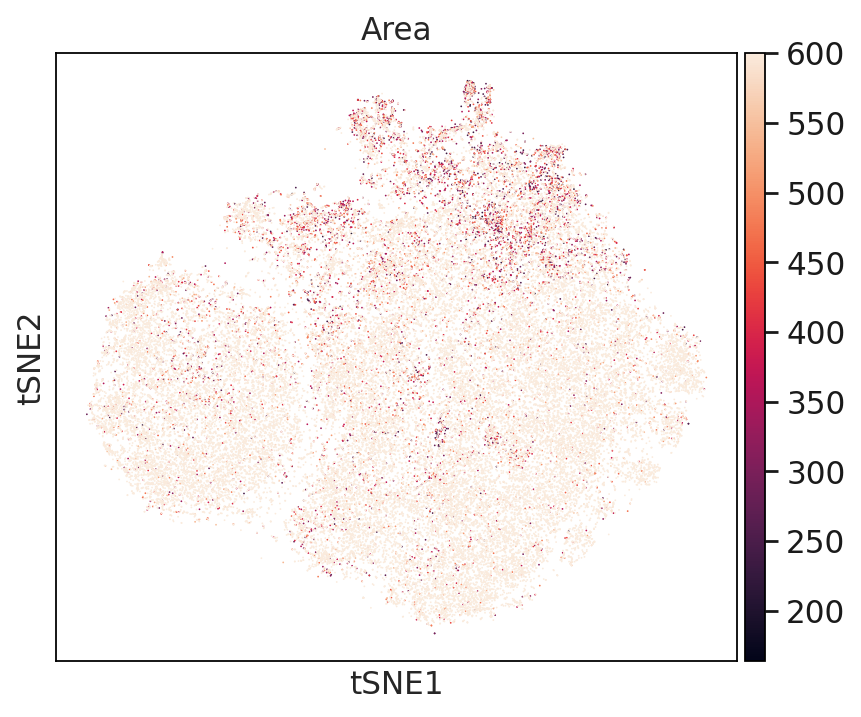

In [73]:
sc.pl.tsne(adataScaled, color=['Area'], vmax=600)#, palette = sc.pl.palettes.vega_20_scanpy)

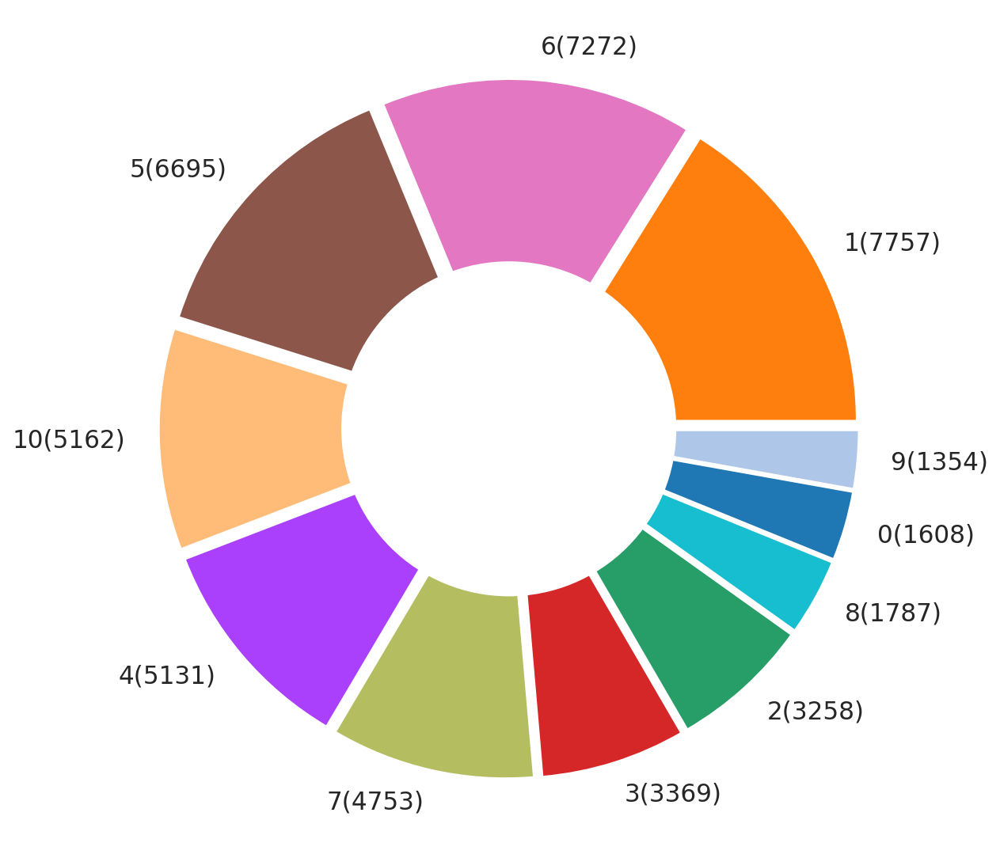

In [74]:
import matplotlib.pyplot as plt
fig,ax=plt.subplots(1,1,figsize=(8,8))
ax.pie(adataScaled.obs.leiden.value_counts(),explode=[0.05]*len(adataScaled.obs.leiden.value_counts().unique()),pctdistance=-0.85,startangle=0,
        labels=[f"{ix}({x})" for ix, x in adataScaled.obs.leiden.value_counts().items()], colors=[cMapDict[c] for c in adataScaled.obs.leiden.value_counts().index],
      textprops = {"fontsize":14})
#plt.set_cmap('Set2')

#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax.add_artist(centre_circle)
plt.tight_layout()


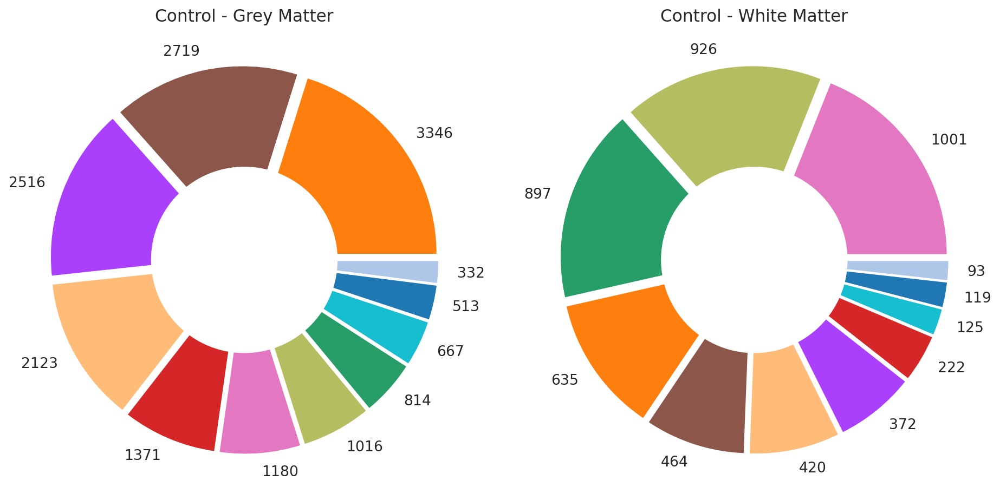

In [75]:
import matplotlib.pyplot as plt
fig,ax=plt.subplots(1,2,figsize=(12,6))
adataScaled2 = adataScaled[adataScaled.obs.ImageType=='Ctl'].copy()

cMapDict = {sorted(adataScaled2.obs.leiden.unique())[i]: adataScaled.uns['leiden_colors'][i] for i in range(len(adataScaled2.obs.leiden.unique()))}
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='Grey Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index
ax[0].pie(count_DF,explode=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
        #labels=[f"{ix}({x})" for ix, x in count_DF.items()], colors=[cMapDict[c] for c in keepOrder],
         labels=[f"{x}" for ix, x in count_DF.items()], colors=[cMapDict[c] for c in keepOrder],
      textprops = {"fontsize":12})
#plt.set_cmap('Set2')
ax[0].set_title('Control - Grey Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[0].add_artist(centre_circle)
plt.tight_layout()
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='White Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index

ax[1].pie(count_DF.loc[keepOrder],explode=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
        #labels=[f"{ix}({x})" for ix, x in count_DF.items()], colors=[cMapDict[c] for c in keepOrder],
          labels=[f"{x}" for ix, x in count_DF.items()], colors=[cMapDict[c] for c in keepOrder],
      textprops = {"fontsize":12})
#plt.set_cmap('Set2')
ax[1].set_title('Control - White Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[1].add_artist(centre_circle)
plt.tight_layout()
plt.savefig('finalFiguresv4/Ctl_GMWM_CellNum50um.png',dpi=600)

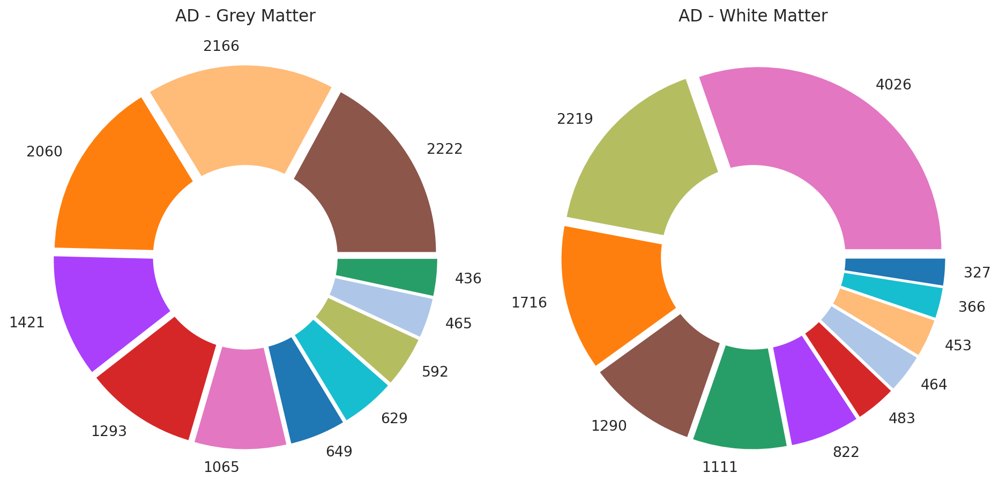

In [76]:
import matplotlib.pyplot as plt
fig,ax=plt.subplots(1,2,figsize=(12,6))
adataScaled2 = adataScaled[adataScaled.obs.ImageType=='AD'].copy()

cMapDict = {sorted(adataScaled2.obs.leiden.unique())[i]: adataScaled.uns['leiden_colors'][i] for i in range(len(adataScaled2.obs.leiden.unique()))}
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='Grey Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index
ax[0].pie(count_DF,explode=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
        labels=[f"{x}" for ix, x in count_DF.items()], colors=[cMapDict[c] for c in keepOrder],
      textprops = {"fontsize":12})
#plt.set_cmap('Set2')
ax[0].set_title('AD - Grey Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[0].add_artist(centre_circle)
plt.tight_layout()
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='White Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index

ax[1].pie(count_DF.loc[keepOrder],explode=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
        labels=[f"{x}" for ix, x in count_DF.items()], colors=[cMapDict[c] for c in keepOrder],
      textprops = {"fontsize":12})
#plt.set_cmap('Set2')
ax[1].set_title('AD - White Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[1].add_artist(centre_circle)
plt.tight_layout()
plt.savefig('finalFiguresv4/AD_GMWM_CellNum100um.png',dpi=600)

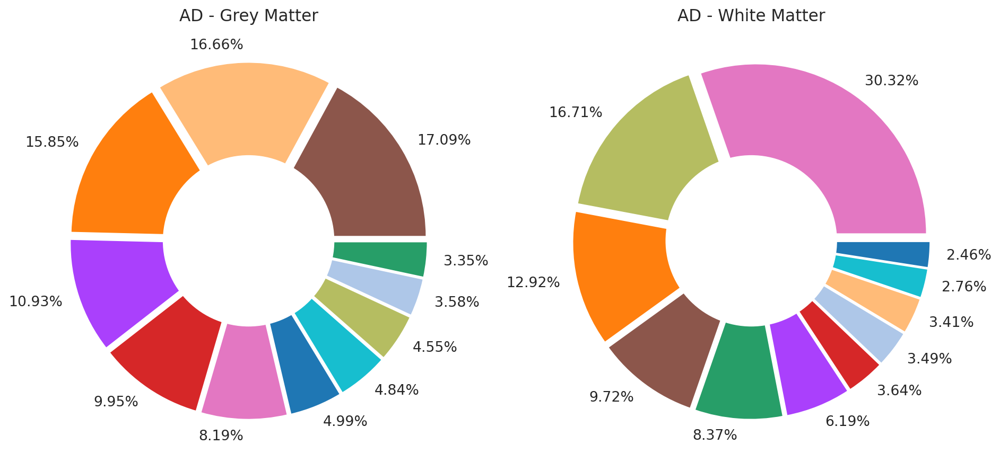

In [77]:
import matplotlib.pyplot as plt
fig,ax=plt.subplots(1,2,figsize=(12,6))
adataScaled2 = adataScaled[adataScaled.obs.ImageType=='AD'].copy()

cMapDict = {sorted(adataScaled2.obs.leiden.unique())[i]: adataScaled.uns['leiden_colors'][i] for i in range(len(adataScaled2.obs.leiden.unique()))}
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='Grey Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index
labels = []
for ix, x in count_DF.items():
    if (100.*x/count_DF.sum())>=1:
        labels.append("{:.2f}%".format(100.*x/count_DF.sum()))
    else:
        if  "< 1%" not in labels:
            labels.append("< 1%")
        else:
            labels.append("")
ax[0].pie(count_DF,explode=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
        labels=labels, colors=[cMapDict[c] for c in keepOrder],
      textprops = {"fontsize":12})
#plt.set_cmap('Set2')
ax[0].set_title('AD - Grey Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[0].add_artist(centre_circle)
plt.tight_layout()
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='White Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index
labels = []
for ix, x in count_DF.items():
    if (100.*x/count_DF.sum())>=1:
        labels.append("{:.2f}%".format(100.*x/count_DF.sum()))
    else:
        if  "< 1%" not in labels:
            labels.append("< 1%")
        else:
            labels.append("")
ax[1].pie(count_DF.loc[keepOrder],explode=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
        labels=labels, colors=[cMapDict[c] for c in keepOrder],
      textprops = {"fontsize":12})
#plt.set_cmap('Set2')
ax[1].set_title('AD - White Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[1].add_artist(centre_circle)
plt.tight_layout()
plt.savefig('finalFiguresv4/AD_GMWM_Percent50um.png',dpi=600)

TypeError: bar() missing 1 required positional argument: 'height'

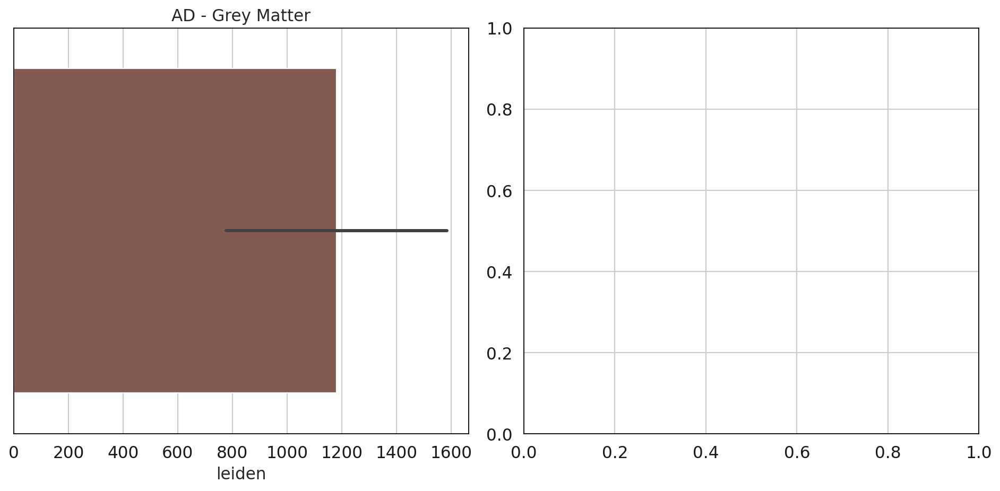

In [78]:
import matplotlib.pyplot as plt
fig,ax=plt.subplots(1,2,figsize=(12,6))
adataScaled2 = adataScaled[adataScaled.obs.ImageType=='AD'].copy()

cMapDict = {sorted(adataScaled2.obs.leiden.unique())[i]: adataScaled.uns['leiden_colors'][i] for i in range(len(adataScaled2.obs.leiden.unique()))}
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='Grey Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index
labels = []
for ix, x in count_DF.items():
    if (100.*x/count_DF.sum())>=1:
        labels.append("{:.2f}%".format(100.*x/count_DF.sum()))
    else:
        if  "< 1%" not in labels:
            labels.append("< 1%")
        else:
            labels.append("")
#ax[0].bar(count_DF,height=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
#        labels=labels, colors=[cMapDict[c] for c in keepOrder],
#      textprops = {"fontsize":12})
sns.barplot(count_DF, palette =[cMapDict[c] for c in keepOrder], ax=ax[0])
#plt.set_cmap('Set2')
ax[0].set_title('AD - Grey Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[0].add_artist(centre_circle)
plt.tight_layout()
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='White Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index
labels = []
for ix, x in count_DF.items():
    if (100.*x/count_DF.sum())>=1:
        labels.append("{:.2f}%".format(100.*x/count_DF.sum()))
    else:
        if  "< 1%" not in labels:
            labels.append("< 1%")
        else:
            labels.append("")
ax[1].bar(count_DF.loc[keepOrder],explode=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
        labels=labels, colors=[cMapDict[c] for c in keepOrder],
      textprops = {"fontsize":12})
#plt.set_cmap('Set2')
ax[1].set_title('AD - White Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[1].add_artist(centre_circle)
plt.tight_layout()
#plt.savefig('finalFiguresv3/AD_GMWM_Percent50um.png',dpi=600)

In [79]:
count_DF

6     4026
7     2219
1     1716
5     1290
2     1111
4      822
3      483
9      464
10     453
8      366
0      327
Name: leiden, dtype: int64

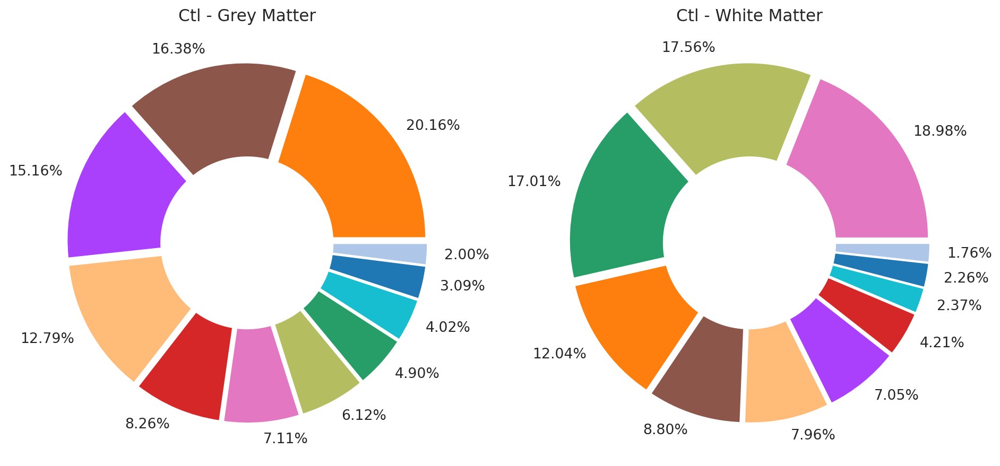

In [80]:
import matplotlib.pyplot as plt
fig,ax=plt.subplots(1,2,figsize=(12,6))
adataScaled2 = adataScaled[adataScaled.obs.ImageType=='Ctl'].copy()

cMapDict = {sorted(adataScaled2.obs.leiden.unique())[i]: adataScaled.uns['leiden_colors'][i] for i in range(len(adataScaled2.obs.leiden.unique()))}
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='Grey Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index
labels = []
for ix, x in count_DF.items():
    if (100.*x/count_DF.sum())>=1:
        labels.append("{:.2f}%".format(100.*x/count_DF.sum()))
    else:
        if  "< 1%" not in labels:
            labels.append("< 1%")
        else:
            labels.append("")
    
ax[0].pie(count_DF,explode=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
        labels=labels, colors=[cMapDict[c] for c in keepOrder],
      textprops = {"fontsize":12})
#plt.set_cmap('Set2')
ax[0].set_title('Ctl - Grey Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[0].add_artist(centre_circle)
plt.tight_layout()
count_DF  = adataScaled2.obs[adataScaled2.obs.Parent=='White Matter'].sample(frac=1).leiden.value_counts()
keepOrder = count_DF.index
labels = []
for ix, x in count_DF.items():
    if (100.*x/count_DF.sum())>=1:
        labels.append("{:.2f}%".format(100.*x/count_DF.sum()))
    else:
        if  "< 1%" not in labels:
            labels.append("< 1%")
        else:
            labels.append("")
ax[1].pie(count_DF.loc[keepOrder],explode=[0.05]*len(adataScaled2.obs.leiden.unique()),pctdistance=-0.85,startangle=0,
        labels=labels, colors=[cMapDict[c] for c in keepOrder],
      textprops = {"fontsize":12})
#plt.set_cmap('Set2')
ax[1].set_title('Ctl - White Matter')
#draw circle
centre_circle = plt.Circle((0,0),0.50,fc='white')
#fig = plt.gcf()
ax[1].add_artist(centre_circle)
plt.tight_layout()
plt.savefig('finalFiguresv4/Ctl_GMWM_Percent50um.png',dpi=600)

Trying to set attribute `._uns` of view, copying.


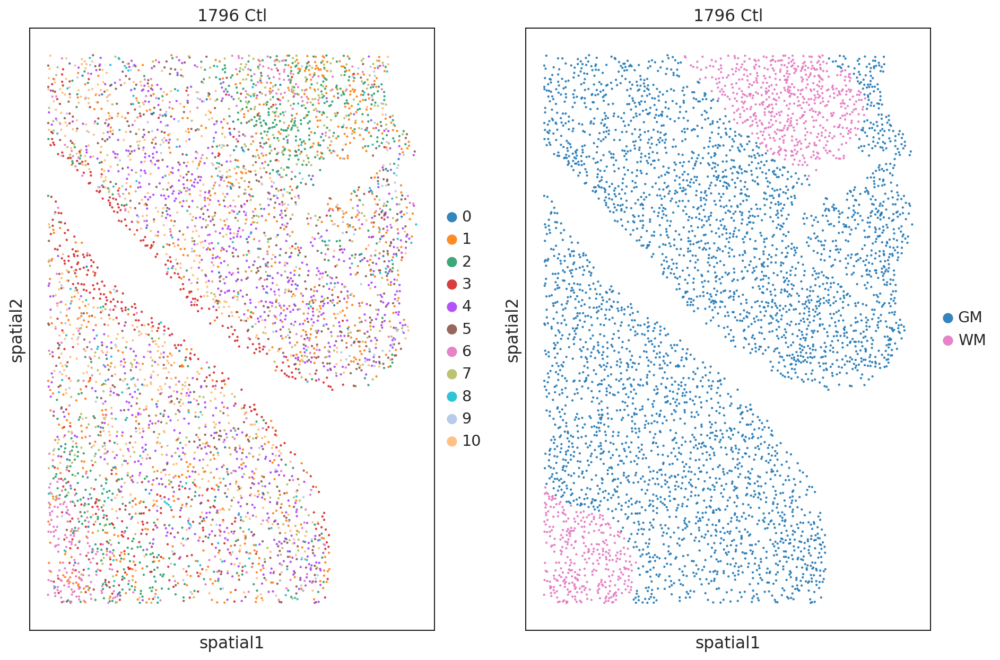

In [81]:

fig,ax=plt.subplots(1,2,figsize=(12,8))
ss = adataScaled[(adataScaled.obs.ImageID.isin(['1796']))]
ss.uns['leiden_colors']=[cMapDict[x] for x in range(len(ss.obs.leiden.unique()))]
sc.pl.scatter(ss, basis='spatial',color=['leiden'],ax=ax[0],size=15.0,title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0],alpha=0.9, 
                  show=False)
sc.pl.scatter(ss, basis='spatial',color=['Region'],ax=ax[1],size=15.0,title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0],alpha=0.9, 
                  show=False, legend_loc='right margin')
plt.tight_layout()
plt.savefig('finalFiguresv4/1796Ctl_Spatial50um.png', dpi=300)

Trying to set attribute `._uns` of view, copying.


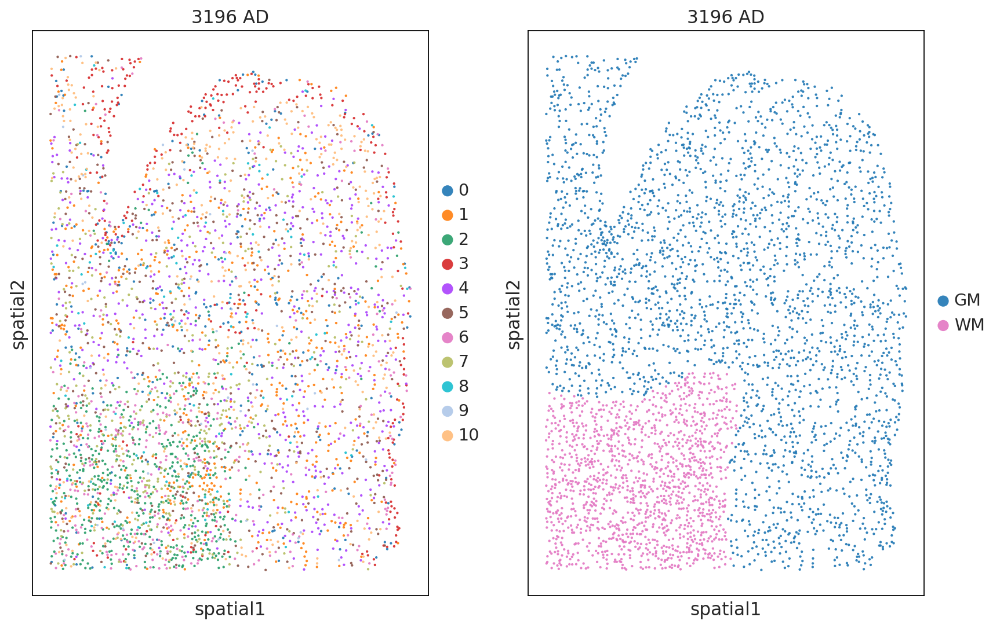

In [83]:

fig,ax=plt.subplots(1,2,figsize=(11,7))
ss = adataScaled[(adataScaled.obs.ImageID.isin(['3196']))]
ss.uns['leiden_colors']=[cMapDict[int(x)] for x in range(len(ss.obs.leiden.unique()))]

sc.pl.scatter(ss, basis='spatial',color=['leiden'],ax=ax[0],size=15.0,alpha=0.9, 
                  show=False, title=ss.obs.ImageID.values[0]+' '+ss.obs.ImageType.values[0])
sc.pl.scatter(ss, basis='spatial',color=['Region'],ax=ax[1],size=15.0,alpha=0.9, 
                  show=False, legend_loc='right margin', title=ss.obs.ImageID.values[0]+' '+ss.obs.ImageType.values[0])
plt.tight_layout()
plt.savefig('finalFiguresv4/3196_Spatial50um.png', dpi=300)

Trying to set attribute `._uns` of view, copying.


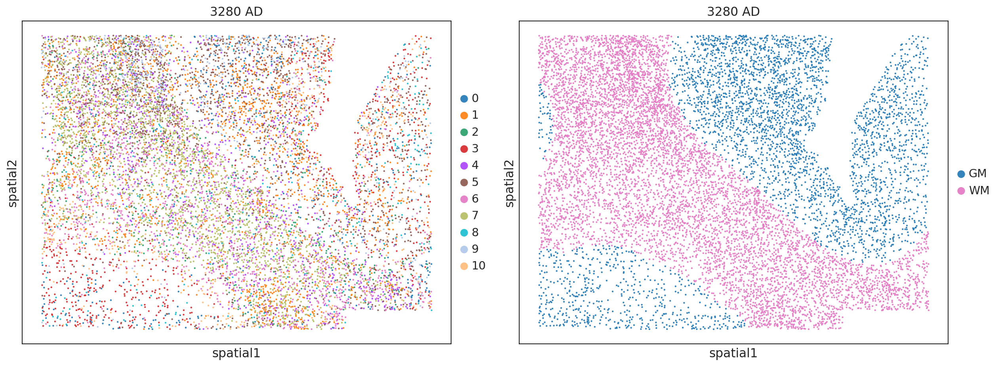

In [84]:

fig,ax=plt.subplots(1,2,figsize=(16,6))
ss = adataScaled[(adataScaled.obs.ImageID.isin(['3280']))]
ss.uns['leiden_colors']=[cMapDict[x] for x in range(len(ss.obs.leiden.unique()))]

sc.pl.scatter(ss, basis='spatial',color=['leiden'],ax=ax[0],size=15.0,alpha=0.9, 
                  show=False, title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0])
sc.pl.scatter(ss, basis='spatial',color=['Region'],ax=ax[1],size=15.0,alpha=0.9, 
                  show=False, legend_loc='right margin', title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0])
plt.tight_layout()
plt.savefig('finalFiguresv4/3280_Spatial50um.png', dpi=300)

In [245]:
dt = 'Distance to nearest Plaque (µm)'
ss.obs

,spatial_X,spatial_Y,Area,Area (µm^2),ImageID,ImageType,Parent,Distance to nearest Plaque (µm),ImageID_CellID,numCellCentroids,leiden,louvain,Region,ImageTypev2
16301,7790.367781,19398.203647,329,74.1369,3196,AD,Grey Matter,55.2005,3196_335,1.0,5,5,GM,AD-3
16304,7764.883775,18910.125255,3433,596.2264,3196,AD,Grey Matter,0.0000,3196_338,3.0,7,7,GM,AD-3
16306,13814.380240,18633.796407,334,59.1087,3196,AD,Grey Matter,9.7759,3196_340,1.0,3,3,GM,AD-3
16307,7699.488281,18645.269531,512,95.9289,3196,AD,Grey Matter,91.4866,3196_341,1.0,5,5,GM,AD-3
16308,7680.746047,18475.045455,1012,176.8999,3196,AD,Grey Matter,77.3920,3196_342,1.0,2,2,GM,AD-3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124623,191.987261,3835.969890,1727,307.8676,3280,AD,Grey Matter,8.8959,3280_28639,1.0,4,4,GM,AD-4
124624,79.415482,3923.362928,8087,1350.7576,3280,AD,Grey Matter,18.9643,3280_28640,2.0,1,1,GM,AD-4
124627,105.768392,3668.969119,1101,184.7346,3280,AD,Grey Matter,8.8173,3280_28643,1.0,1,1,GM,AD-4
124630,38.633252,3501.946210,409,78.4090,3280,AD,Grey Matter,57.7208,3280_28646,1.0,5,5,GM,AD-4


(0.0, 350.0)

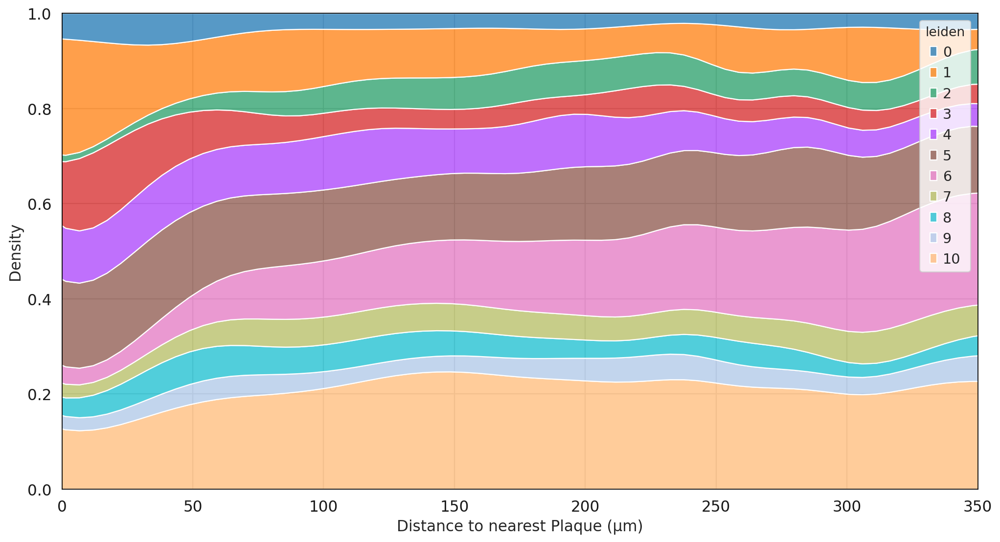

In [86]:
import matplotlib.pyplot as plt
fig,ax=plt.subplots(1,1,figsize=(15,8))
ss = adataScaled[(adataScaled.obs.ImageType =='AD')]
sns.kdeplot(data=ss.obs[ss.obs.Parent=='Grey Matter' ], x=dt,hue='leiden',multiple="fill",ax=ax)
ax.set_xlim(0,350)

(0.0, 1000.0)

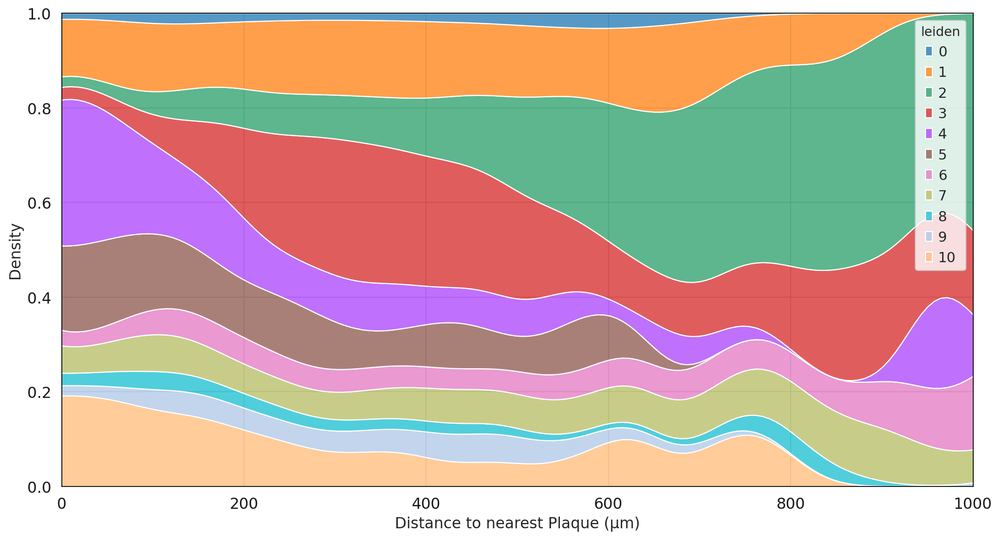

In [87]:
import matplotlib.pyplot as plt
fig,ax=plt.subplots(1,1,figsize=(15,8))
ss = adataScaled[(adataScaled.obs.ImageID =='1796')]
sns.kdeplot(data=ss.obs[ss.obs.Parent=='Grey Matter' ], x=dt,hue='leiden',multiple="fill",ax=ax)
ax.set_xlim(0,1000)

In [246]:
ss = adataScaled[(adataScaled.obs.ImageType =='AD')]
ss = ss[ss.obs.Parent=='Grey Matter']
BINS  =[-1,0,5,10,20,30,40,50,75,100,150,200,300,500]#,750,1000]
out = pd.cut(ss.obs[dt],bins=BINS, right=True)
ss.obs['Quantile'] = out.values

Trying to set attribute `.obs` of view, copying.


In [247]:
#ss.obs[dt][ss.obs[dt]!=0].min()

In [248]:
ss.obs

,spatial_X,spatial_Y,Area,Area (µm^2),ImageID,ImageType,Parent,Distance to nearest Plaque (µm),ImageID_CellID,numCellCentroids,leiden,louvain,Region,ImageTypev2,Quantile
16301,7790.367781,19398.203647,329,74.1369,3196,AD,Grey Matter,55.2005,3196_335,1.0,5,5,GM,AD-3,"(50, 75]"
16304,7764.883775,18910.125255,3433,596.2264,3196,AD,Grey Matter,0.0000,3196_338,3.0,7,7,GM,AD-3,"(-1, 0]"
16306,13814.380240,18633.796407,334,59.1087,3196,AD,Grey Matter,9.7759,3196_340,1.0,3,3,GM,AD-3,"(5, 10]"
16307,7699.488281,18645.269531,512,95.9289,3196,AD,Grey Matter,91.4866,3196_341,1.0,5,5,GM,AD-3,"(75, 100]"
16308,7680.746047,18475.045455,1012,176.8999,3196,AD,Grey Matter,77.3920,3196_342,1.0,2,2,GM,AD-3,"(75, 100]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124623,191.987261,3835.969890,1727,307.8676,3280,AD,Grey Matter,8.8959,3280_28639,1.0,4,4,GM,AD-4,"(5, 10]"
124624,79.415482,3923.362928,8087,1350.7576,3280,AD,Grey Matter,18.9643,3280_28640,2.0,1,1,GM,AD-4,"(10, 20]"
124627,105.768392,3668.969119,1101,184.7346,3280,AD,Grey Matter,8.8173,3280_28643,1.0,1,1,GM,AD-4,"(5, 10]"
124630,38.633252,3501.946210,409,78.4090,3280,AD,Grey Matter,57.7208,3280_28646,1.0,5,5,GM,AD-4,"(50, 75]"


In [249]:
import matplotlib as mpl
#[255*x for x in mpl.colors.hex2color('#00dbf2')]
cMP =mpl.colors.LinearSegmentedColormap.from_list("", ["#444948","#ffffff","#0000ff"])

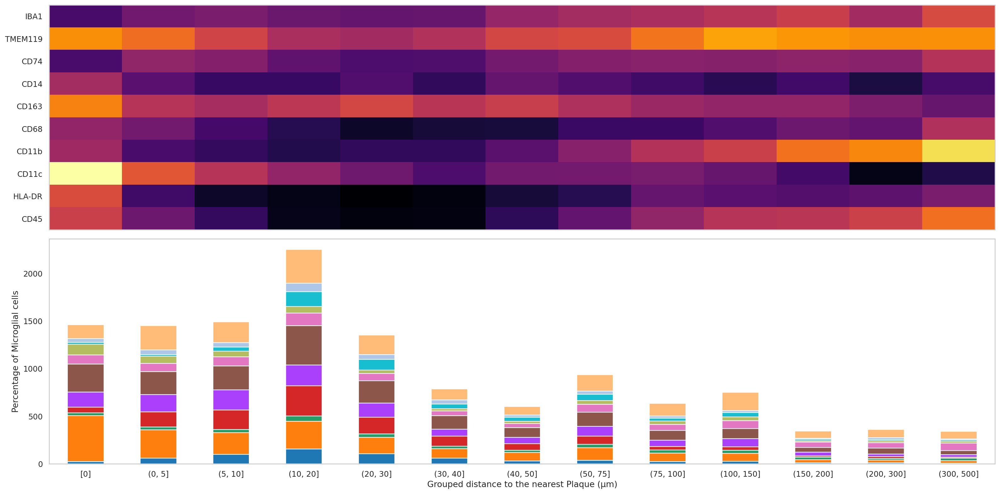

In [259]:


#sc.tl.dendrogram(adataScaled2, groupby='Decile')
fig,ax = plt.subplots(2,1,figsize=(20,10))

matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',show=False,vmin=-0.25, vmax=0.5,vcenter=0,
                 dendrogram=False, use_raw=False, cmap="inferno",standard_scale='None',return_fig=True,swap_axes=True)
#matpl.legend(show=False)
#ax[0]=matpl.get_axes()
#ax[0]['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
#ax[0]['mainplot_ax'].set_xticklabels([])
#ax[0]['mainplot_ax'].set_ylabel(f'Protein')
#ax[0]['mainplot_ax'].set_xlabel(f'Grouped {dt}')
import numpy as np
sns.set_style("whitegrid", {'axes.grid' : False})

#sns.barplot(y=out.value_counts().values, x=out.value_counts().index,ax=ax[1],j orient='v', color='tab:purple')
#ss.obs[['leiden','Quantile']].set_index('Quantile').plot(kind='bar',stacked=True)
#ax[1].set_ylabel('No. of cells')
oDF =ss.obs.groupby(['Quantile','leiden']).size()
#oDF.columns = ['value']
oDF = oDF.unstack(level=-1)
#oDFPct = 100*oDF.T/oDF.sum(axis=1)
oDFPct =oDF.T#/oDF.sum(axis=1)
oDFPct
#oDF.pivot(index='Quantile',columns='leiden')
#oDF.plot(kind='bar',stacked=True)
ax[0].pcolor(matpl.values_df.T, cmap='inferno')
ax[0].set_xticks([])
ax[0].set_yticks(np.arange(0.5, len(matpl.values_df.T.index), 1), matpl.values_df.T.index)
ax[0].set_yticklabels(matpl.values_df.T.index.values)
ax[0].invert_yaxis()
oDFPct.T.plot(kind='bar',stacked=True,ax=ax[1],color=cMapDict, legend=False)
ax[1].set_ylabel('Percentage of Microglial cells')
ax[1].set_xlabel('Grouped distance to the nearest Plaque (µm)')
ax[1].set_xticklabels(['[0]']+ax[1].get_xticklabels()[1:],rotation = 0)

plt.tight_layout()
plt.savefig('finalFiguresv4/AD_Distance_Avg_Expression50um.png')

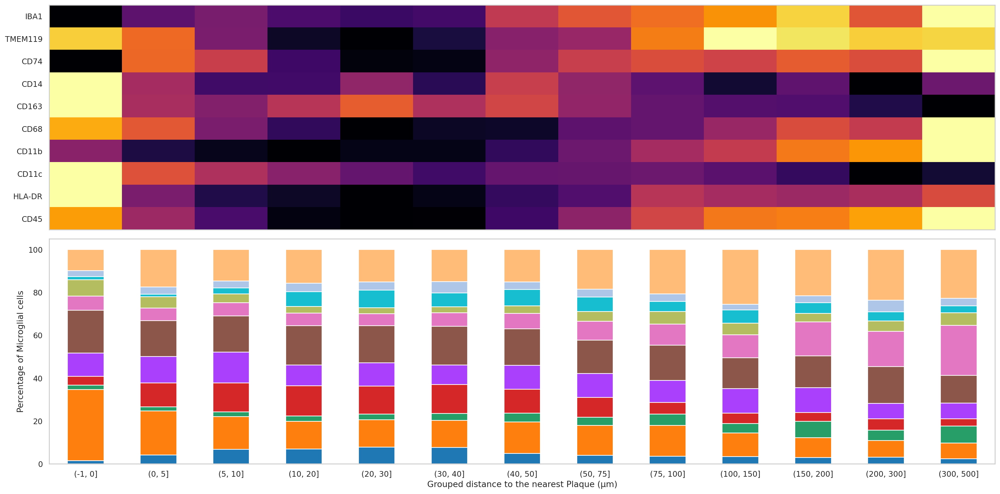

In [260]:


#sc.tl.dendrogram(adataScaled2, groupby='Decile')
fig,ax = plt.subplots(2,1,figsize=(20,10))

matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',show=False,
                 dendrogram=False, use_raw=False, cmap="inferno",standard_scale='var',return_fig=True,swap_axes=True)
#matpl.legend(show=False)
#ax[0]=matpl.get_axes()
#ax[0]['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
#ax[0]['mainplot_ax'].set_xticklabels([])
#ax[0]['mainplot_ax'].set_ylabel(f'Protein')
#ax[0]['mainplot_ax'].set_xlabel(f'Grouped {dt}')
import numpy as np
sns.set_style("whitegrid", {'axes.grid' : False})

#sns.barplot(y=out.value_counts().values, x=out.value_counts().index,ax=ax[1],j orient='v', color='tab:purple')
#ss.obs[['leiden','Quantile']].set_index('Quantile').plot(kind='bar',stacked=True)
#ax[1].set_ylabel('No. of cells')
oDF =ss.obs.groupby(['Quantile','leiden']).size()
#oDF.columns = ['value']
oDF = oDF.unstack(level=-1)
oDFPct = 100*oDF.T/oDF.sum(axis=1)
oDFPct
#oDF.pivot(index='Quantile',columns='leiden')
#oDF.plot(kind='bar',stacked=True)
ax[0].pcolor(matpl.values_df.T, cmap='inferno')
ax[0].set_xticks([])
ax[0].set_yticks(np.arange(0.5, len(matpl.values_df.T.index), 1), matpl.values_df.T.index)
ax[0].set_yticklabels(matpl.values_df.T.index.values)
ax[0].invert_yaxis()
oDFPct.T.plot(kind='bar',stacked=True,ax=ax[1],color=cMapDict, legend=False)
ax[1].set_ylabel('Percentage of Microglial cells')
ax[1].set_xlabel('Grouped distance to the nearest Plaque (µm)')
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation = 0)

plt.tight_layout()
plt.savefig('finalFiguresv4/AD_Distance_Avg_Expression50um.png')

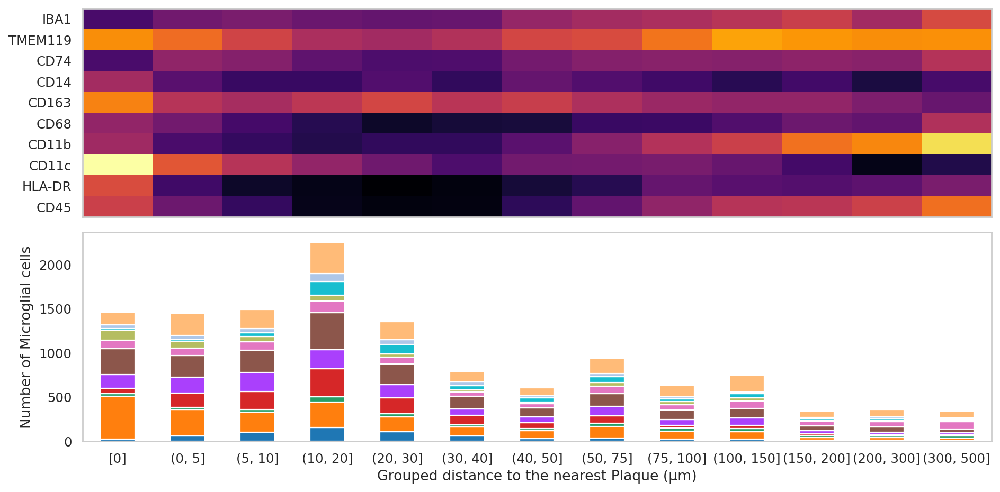

In [268]:


#sc.tl.dendrogram(adataScaled2, groupby='Decile')
fig,ax = plt.subplots(2,1,figsize=(12,6))

matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',show=False,vmin=-0.25, vmax=0.5,vcenter=0,
                 dendrogram=False, use_raw=False, cmap="inferno",standard_scale=None,return_fig=True,swap_axes=True)
matpl.legend(show=False)
#ax[0]=matpl.get_axes()
#ax[0]['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
#ax[0]['mainplot_ax'].set_xticklabels([])
#ax[0]['mainplot_ax'].set_ylabel(f'Protein')
#ax[0]['mainplot_ax'].set_xlabel(f'Grouped {dt}')
import numpy as np
sns.set_style("whitegrid", {'axes.grid' : False})

#sns.barplot(y=out.value_counts().values, x=out.value_counts().index,ax=ax[1],j orient='v', color='tab:purple')
#ss.obs[['leiden','Quantile']].set_index('Quantile').plot(kind='bar',stacked=True)
#ax[1].set_ylabel('No. of cells')
oDF =ss.obs.groupby(['Quantile','leiden']).size()
#oDF.columns = ['value']
oDF = oDF.unstack(level=-1)
oDFPct = oDF.T#/oDF.sum(axis=1)
oDFPct
#oDF.pivot(index='Quantile',columns='leiden')
#oDF.plot(kind='bar',stacked=True)
ax[0].pcolor(matpl.values_df.T, cmap='inferno')
ax[0].set_xticks([])
ax[0].set_yticks(np.arange(0.5, len(matpl.values_df.T.index), 1), matpl.values_df.T.index)
ax[0].set_yticklabels(matpl.values_df.T.index.values)
ax[0].invert_yaxis()
oDFPct.T.plot(kind='bar',stacked=True,ax=ax[1],color=cMapDict, legend=False)
ax[1].set_ylabel('Number of Microglial cells')
ax[1].set_xlabel('Grouped distance to the nearest Plaque (µm)')
ax[1].set_xticklabels(['[0]']+ax[1].get_xticklabels()[1:],rotation = 0)

plt.tight_layout()
plt.savefig('finalFiguresv4/FIN_AD_Distance_Avg_Expression_NumCells50um.png')

In [97]:
ss

AnnData object with n_obs × n_vars = 12998 × 10
    obs: 'spatial_X', 'spatial_Y', 'Area', 'Area (µm^2)', 'ImageID', 'ImageType', 'Parent', 'Distance to nearest Plaque (µm)', 'ImageID_CellID', 'numCellCentroids', 'leiden', 'louvain', 'Region', 'Quantile'
    var: 'mean', 'std'
    uns: 'log1p', 'pca', 'tsne', 'neighbors', 'louvain', 'Region_colors', 'ImageType_colors', 'ImageID_colors', 'leiden_colors', 'dendrogram_leiden'
    obsm: 'X_spatial', 'X_pca', 'X_tsne'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

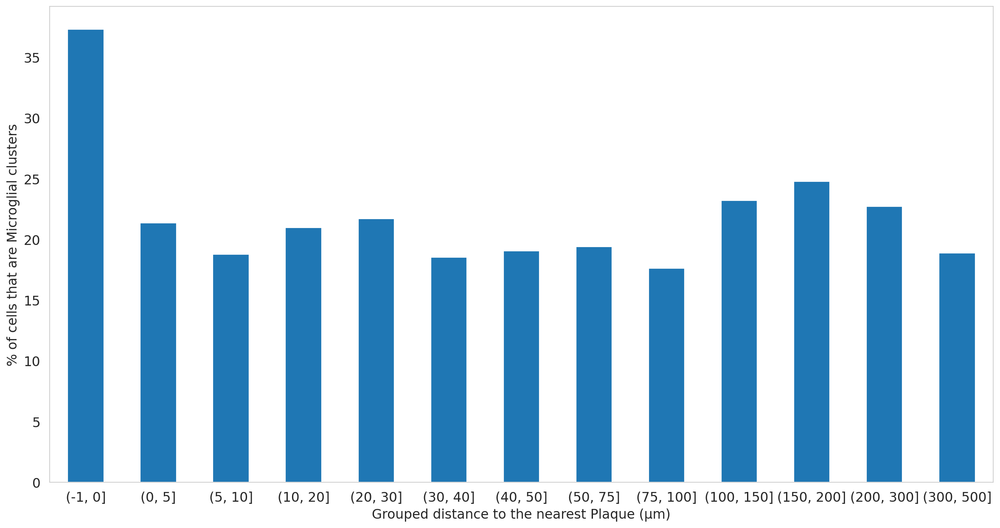

In [98]:


#sc.tl.dendrogram(adataScaled2, groupby='Decile')
fig,ax = plt.subplots(1,1,figsize=(15,8))

matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',show=False,
                 dendrogram=False, use_raw=False, cmap="inferno",standard_scale='var',return_fig=True,swap_axes=True)
matpl.legend(show=False)
#ax[0]=matpl.get_axes()
#ax[0]['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
#ax[0]['mainplot_ax'].set_xticklabels([])
#ax[0]['mainplot_ax'].set_ylabel(f'Protein')
#ax[0]['mainplot_ax'].set_xlabel(f'Grouped {dt}')
import numpy as np
sns.set_style("whitegrid", {'axes.grid' : False})

#sns.barplot(y=out.value_counts().values, x=out.value_counts().index,ax=ax[1],j orient='v', color='tab:purple')
#ss.obs[['leiden','Quantile']].set_index('Quantile').plot(kind='bar',stacked=True)
#ax[1].set_ylabel('No. of cells')

oDF =100.*ss.obs[ss.obs['Area (µm^2)']>600].groupby(['Quantile'])[['Area (µm^2)']].size()/ss.obs[ss.obs['Area (µm^2)']>0].groupby(['Quantile'])[['Area (µm^2)']].size()
oDF =100.*ss.obs[ss.obs['numCellCentroids']>1].groupby(['Quantile'])[['numCellCentroids']].size()/ss.obs[ss.obs['numCellCentroids']>0].groupby(['Quantile'])[['numCellCentroids']].size()

#oDF.columns = ['value']
#oDF = oDF.unstack(level=-1)
oDFPct = oDF.T#/oDF.sum(axis=1)

#print(oDFPct)
#oDFPct.reset_index(inplace=True)
#oDFPct.columns =
#oDF.pivot(index='Quantile',columns='leiden')
#oDF.plot(kind='bar',stacked=True)
'''
ax[0].pcolor(matpl.values_df.T, cmap='inferno')
ax[0].set_xticks([])
ax[0].set_yticks(np.arange(0.5, len(matpl.values_df.T.index), 1), matpl.values_df.T.index)
ax[0].set_yticklabels(matpl.values_df.T.index.values)
'''
oDFPct.T.plot(kind='bar',stacked=True,ax=ax, legend=False)
#sns.regplot(data=oDFPct,x='Distance to nearest Plaque (µm)',y=oDFPct.values,x_bins=BINS, x_estimator=np.mean,ax=ax[1])
ax.set_ylabel('% of cells that are Microglial clusters')
ax.set_xlabel('Grouped distance to the nearest Plaque (µm)')
ax.set_xticklabels(ax.get_xticklabels(),rotation = 0)
#ax[1].set_ylim(0,2000)

plt.tight_layout()
plt.savefig('finalFiguresv4/AD_Distance_Avg_Expression_Area_50um.png')

In [99]:
cMapDict = {int(k):cMapDict[k] for k in cMapDict.keys()}

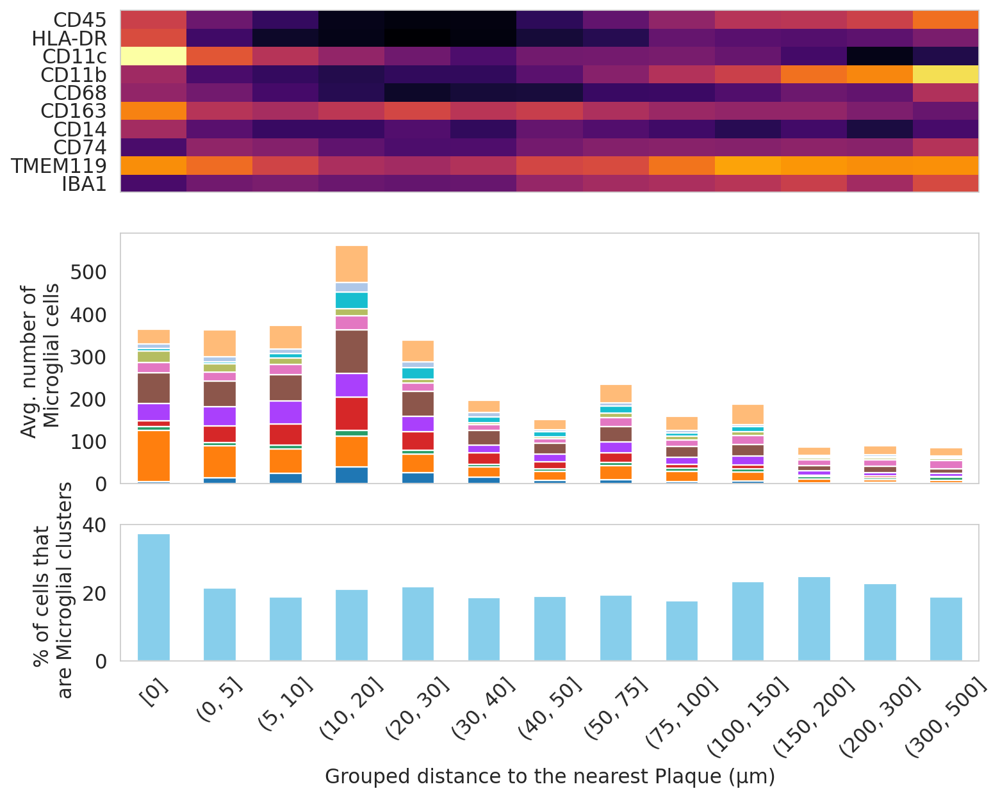

In [114]:


#sc.tl.dendrogram(adataScaled2, groupby='Decile')
fig,ax = plt.subplots(3,1,figsize=(10,8),gridspec_kw={'height_ratios': [1.6, 2.2 ,1.2]})

matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',show=False,vmin=-0.25, vmax=0.25,vcenter=0,
                 dendrogram=False, use_raw=False, cmap="inferno",standard_scale=None,return_fig=True,swap_axes=True)
matpl.legend(show=False)
#ax[0]=matpl.get_axes()
#ax[0]['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
#ax[0]['mainplot_ax'].set_xticklabels([])
#ax[0]['mainplot_ax'].set_ylabel(f'Protein')
#ax[0]['mainplot_ax'].set_xlabel(f'Grouped {dt}')
import numpy as np
sns.set_style("whitegrid", {'axes.grid' : False})

#sns.barplot(y=out.value_counts().values, x=out.value_counts().index,ax=ax[1],j orient='v', color='tab:purple')
#ss.obs[['leiden','Quantile']].set_index('Quantile').plot(kind='bar',stacked=True)
#ax[1].set_ylabel('No. of cells')

#oDF.pivot(index='Quantile',columns='leiden')
#oDF.plot(kind='bar',stacked=True)
ax[0].pcolor(matpl.values_df.T, cmap='inferno')
ax[0].set_xticks([])
ax[0].set_yticks(np.arange(0.5, len(matpl.values_df.T.index), 1), matpl.values_df.T.index)
ax[0].set_yticklabels(matpl.values_df.T.index.values)

oDFPct = ss.obs.groupby(['Quantile','leiden','ImageID']).size().T.reset_index().groupby(['Quantile','leiden']).mean().unstack(level=1).T.reset_index(drop=True)

oDFPct.T.plot(kind='bar',stacked=True,ax=ax[1],color=cMapDict, legend=False)
ax[1].set_ylabel('Avg. number of \n Microglial cells')
#ax[1].set_xlabel('Grouped distance to the nearest Plaque (µm)')
ax[1].set_xlabel('')
#ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation = 0)
ax[1].set_xticks([])



#oDF =100.*ss.obs[ss.obs['Area (µm^2)']>500].groupby(['Quantile'])[['Area (µm^2)']].size()/ss.obs[ss.obs['Area (µm^2)']>0].groupby(['Quantile'])[['Area (µm^2)']].size()
oDF =100.*ss.obs[ss.obs['numCellCentroids']>1].groupby(['Quantile'])[['numCellCentroids']].size()/ss.obs.groupby(['Quantile'])[['numCellCentroids']].size()

oDFPct = oDF.T#/oDF.sum(axis=1)
oDFPct.T.plot(kind='bar',stacked=True,ax=ax[2], legend=False, color='skyblue')
#sns.regplot(data=oDFPct,x='Distance to nearest Plaque (µm)',y=oDFPct.values,x_bins=BINS, x_estimator=np.mean,ax=ax[1])
ax[2].set_ylabel('% of cells that \n are Microglial clusters')
ax[2].set_xlabel('Grouped distance to the nearest Plaque (µm)')
ax[2].set_xticklabels(['[0]']+ax[2].get_xticklabels()[1:],rotation = 45)
ax[2].set_ylim(0,40)

plt.tight_layout()
plt.savefig('finalFiguresv4/AD_Distance_Avg_Expression_NumCells50um_Pct.png', dpi=300)

In [161]:
oDFPct

Quantile
(-1, 0]       37.328767
(0, 5]        21.379310
(5, 10]       18.766756
(10, 20]      20.968458
(20, 40]      20.551144
(40, 60]      18.988550
(60, 80]      20.124805
(80, 100]     16.666667
(100, 250]    23.694466
(250, 500]    19.803922
dtype: float64

<AxesSubplot:xlabel='Distance to nearest Plaque (µm)', ylabel='Area (µm^2)'>

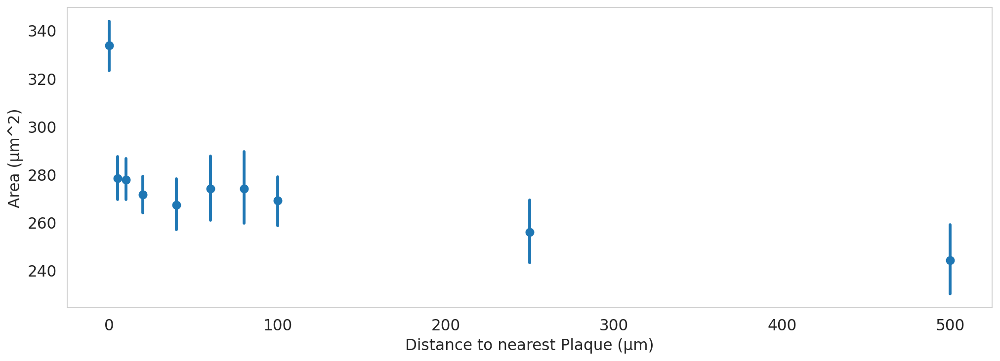

In [162]:
plt.figure(figsize=(15,5))
sns.regplot(data=ss.obs,x='Distance to nearest Plaque (µm)',y='Area (µm^2)',x_bins=BINS,logx=True, x_estimator=np.mean)

<AxesSubplot:xlabel='Quantile', ylabel='Area (µm^2)'>

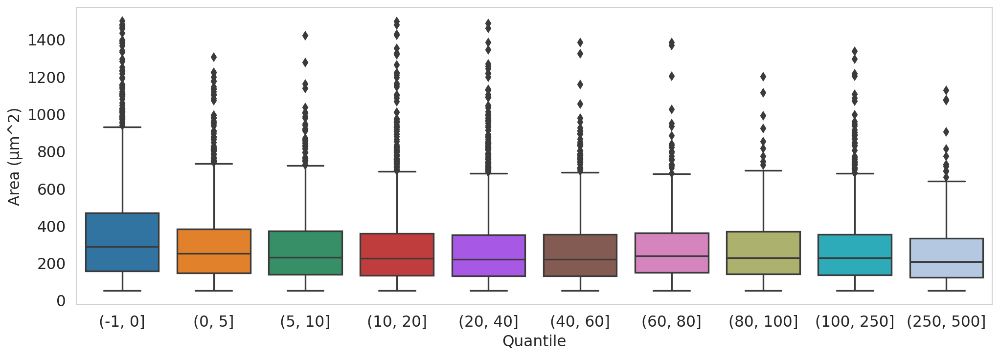

In [163]:
plt.figure(figsize=(15,5))
sns.boxplot(data=ss.obs,x='Quantile',y='Area (µm^2)',  )#.set(ylim=(100,1000),)

In [164]:
ss.obs.groupby(['Quantile','leiden','ImageID']).size().T.reset_index().groupby(['Quantile','leiden']).mean().unstack(level=1).T.reset_index(drop=True)

Quantile,"(-1, 0]","(0, 5]","(5, 10]","(10, 20]","(20, 40]","(40, 60]","(60, 80]","(80, 100]","(100, 250]","(250, 500]"
0,5.50,14.75,25.00,39.00,41.50,11.75,5.75,4.50,10.00,3.50
1,121.00,74.50,57.00,72.50,68.00,36.50,24.25,17.25,31.50,10.50
2,7.75,7.25,8.50,14.00,15.25,10.25,7.25,6.00,17.25,8.75
3,14.75,40.25,50.50,79.25,71.00,28.25,13.25,5.50,15.75,4.25
4,39.75,45.00,53.50,54.75,54.50,29.50,17.25,12.50,35.50,8.75
5,73.00,60.50,63.00,103.75,94.25,43.50,25.00,20.00,48.25,18.00
6,24.00,21.25,23.25,32.75,31.75,22.50,11.75,12.75,40.00,28.25
7,28.00,19.25,15.00,17.50,14.50,9.00,8.50,7.75,15.75,7.50
8,5.00,4.00,10.75,38.50,41.00,20.25,8.75,6.00,17.50,4.75
9,10.25,12.25,11.75,22.50,23.00,8.00,7.00,4.50,11.25,4.50


In [165]:
ss.obs.groupby(['Quantile','leiden','ImageID']).size().T.reset_index()

,Quantile,leiden,ImageID,0
0,"(-1, 0]",0,2997,0
1,"(-1, 0]",0,3155,1
2,"(-1, 0]",0,3196,7
3,"(-1, 0]",0,3280,14
4,"(-1, 0]",1,2997,174
...,...,...,...,...
435,"(250, 500]",9,3280,0
436,"(250, 500]",10,2997,1
437,"(250, 500]",10,3155,113
438,"(250, 500]",10,3196,0


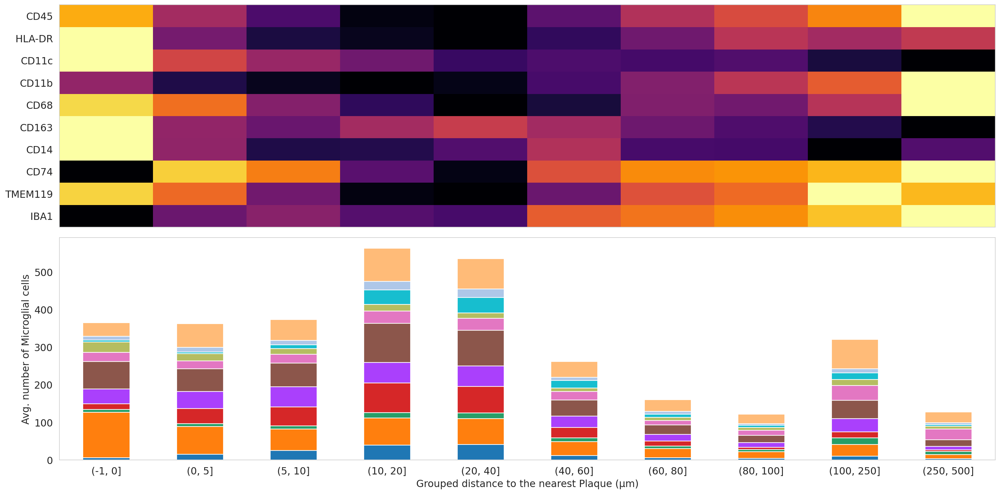

In [166]:


#sc.tl.dendrogram(adataScaled2, groupby='Decile')
fig,ax = plt.subplots(2,1,figsize=(20,10))

matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',show=False,
                 dendrogram=False, use_raw=False, cmap="inferno",standard_scale='var',return_fig=True,swap_axes=True)
matpl.legend(show=False)
#ax[0]=matpl.get_axes()
#ax[0]['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
#ax[0]['mainplot_ax'].set_xticklabels([])
#ax[0]['mainplot_ax'].set_ylabel(f'Protein')
#ax[0]['mainplot_ax'].set_xlabel(f'Grouped {dt}')
import numpy as np
sns.set_style("whitegrid", {'axes.grid' : False})

#sns.barplot(y=out.value_counts().values, x=out.value_counts().index,ax=ax[1],j orient='v', color='tab:purple')
#ss.obs[['leiden','Quantile']].set_index('Quantile').plot(kind='bar',stacked=True)
#ax[1].set_ylabel('No. of cells')
oDFPct = ss.obs.groupby(['Quantile','leiden','ImageID']).size().T.reset_index().groupby(['Quantile','leiden']).mean().unstack(level=1).T.reset_index(drop=True)
#oDF.pivot(index='Quantile',columns='leiden')
#oDF.plot(kind='bar',stacked=True)
ax[0].pcolor(matpl.values_df.T, cmap='inferno')
ax[0].set_xticks([])
ax[0].set_yticks(np.arange(0.5, len(matpl.values_df.T.index), 1), matpl.values_df.T.index)
ax[0].set_yticklabels(matpl.values_df.T.index.values)

oDFPct.T.plot(kind='bar',stacked=True,ax=ax[1],color=cMapDict, legend=False)
ax[1].set_ylabel('Avg. number of Microglial cells')
ax[1].set_xlabel('Grouped distance to the nearest Plaque (µm)')
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation = 0)

plt.tight_layout()
plt.savefig('finalFiguresv3/AD_Distance_Avg_Expression_AvgNumCells100um.png')

In [167]:
ss = adataScaled[(adataScaled.obs.ImageID =='1796')]
ss = ss[ss.obs.Parent=='Grey Matter']
BINS  =[-1,0,5,10,20,40,60,80,100,250,500]#,1000,2000]

out = pd.cut(ss.obs[dt],bins=BINS, right=True)
ss.obs['Quantile'] = out.values

Trying to set attribute `.obs` of view, copying.


In [168]:
ss.obs['leiden'] = ss.obs.leiden.astype(int)

In [169]:
cMapDict

{0: '#1f77b4',
 1: '#ff7f0e',
 2: '#279e68',
 3: '#d62728',
 4: '#aa40fc',
 5: '#8c564b',
 6: '#e377c2',
 7: '#b5bd61',
 8: '#17becf',
 9: '#aec7e8',
 10: '#ffbb78'}

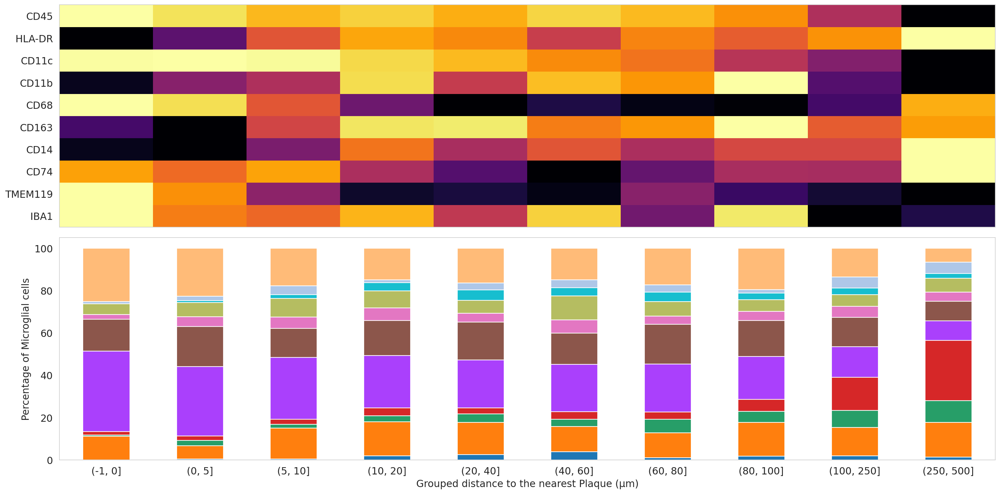

In [170]:


#sc.tl.dendrogram(adataScaled2, groupby='Decile')
fig,ax = plt.subplots(2,1,figsize=(20,10))

matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',show=False,
                 dendrogram=False, use_raw=False, cmap="inferno",standard_scale='var',return_fig=True,swap_axes=True)
matpl.legend(show=False)
#ax[0]=matpl.get_axes()
#ax[0]['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
#ax[0]['mainplot_ax'].set_xticklabels([])
#ax[0]['mainplot_ax'].set_ylabel(f'Protein')
#ax[0]['mainplot_ax'].set_xlabel(f'Grouped {dt}')
import numpy as np
sns.set_style("whitegrid", {'axes.grid' : False})

#sns.barplot(y=out.value_counts().values, x=out.value_counts().index,ax=ax[1],j orient='v', color='tab:purple')
#ss.obs[['leiden','Quantile']].set_index('Quantile').plot(kind='bar',stacked=True)
#ax[1].set_ylabel('No. of cells')
oDF =ss.obs.groupby(['Quantile','leiden']).size()
#oDF.columns = ['value']
oDF = oDF.unstack(level=-1)
oDFPct = 100*oDF.T/oDF.sum(axis=1)
oDFPct
#oDF.pivot(index='Quantile',columns='leiden')
#oDF.plot(kind='bar',stacked=True)
ax[0].pcolor(matpl.values_df.T, cmap='inferno')
ax[0].set_xticks([])
ax[0].set_yticks(np.arange(0.5, len(matpl.values_df.T.index), 1), matpl.values_df.T.index)
ax[0].set_yticklabels(matpl.values_df.T.index.values)

oDFPct.T.plot(kind='bar',stacked=True,ax=ax[1],color=cMapDict, legend=False)
ax[1].set_ylabel('Percentage of Microglial cells')
ax[1].set_xlabel('Grouped distance to the nearest Plaque (µm)')
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation = 0)

plt.tight_layout()
plt.savefig('finalFiguresv4/1796_DiffPlaques_Distance_Avg_Expression100um.png')

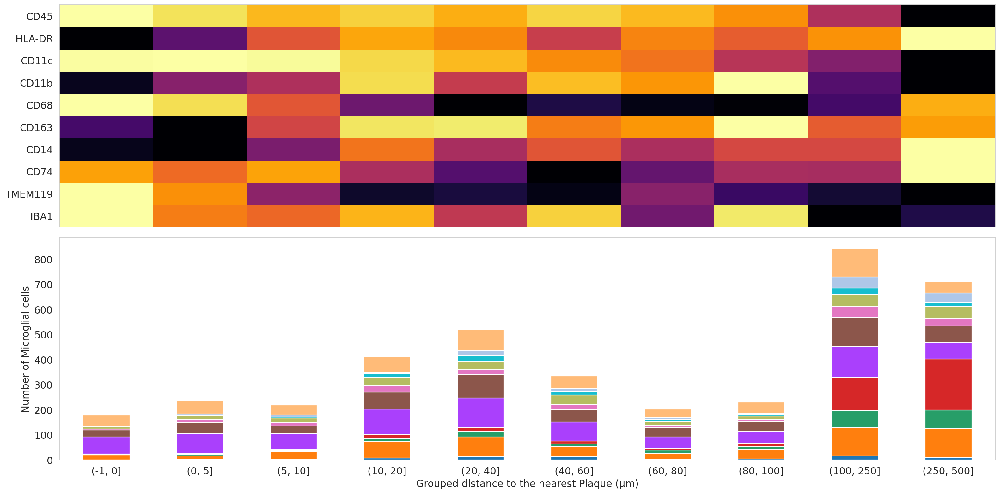

In [171]:


#sc.tl.dendrogram(adataScaled2, groupby='Decile')
fig,ax = plt.subplots(2,1,figsize=(20,10))

matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',show=False,
                 dendrogram=False, use_raw=False, cmap="inferno",standard_scale='var',return_fig=True,swap_axes=True)
matpl.legend(show=False)
#ax[0]=matpl.get_axes()
#ax[0]['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
#ax[0]['mainplot_ax'].set_xticklabels([])
#ax[0]['mainplot_ax'].set_ylabel(f'Protein')
#ax[0]['mainplot_ax'].set_xlabel(f'Grouped {dt}')
import numpy as np
sns.set_style("whitegrid", {'axes.grid' : False})

#sns.barplot(y=out.value_counts().values, x=out.value_counts().index,ax=ax[1],j orient='v', color='tab:purple')
#ss.obs[['leiden','Quantile']].set_index('Quantile').plot(kind='bar',stacked=True)
#ax[1].set_ylabel('No. of cells')
oDF =ss.obs.groupby(['Quantile','leiden']).size()
#oDF.columns = ['value']
oDF = oDF.unstack(level=-1)
oDFPct = oDF.T#/oDF.sum(axis=1)
oDFPct
#oDF.pivot(index='Quantile',columns='leiden')
#oDF.plot(kind='bar',stacked=True)
ax[0].pcolor(matpl.values_df.T, cmap='inferno')
ax[0].set_xticks([])
ax[0].set_yticks(np.arange(0.5, len(matpl.values_df.T.index), 1), matpl.values_df.T.index)
ax[0].set_yticklabels(matpl.values_df.T.index.values)

oDFPct.T.plot(kind='bar',stacked=True,ax=ax[1],color=cMapDict, legend=False)
ax[1].set_ylabel('Number of Microglial cells')
ax[1].set_xlabel('Grouped distance to the nearest Plaque (µm)')
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation = 0)

plt.tight_layout()
plt.savefig('finalFiguresv4/1796_DiffPlaques_Distance_Avg_Expression_NumCells100um.png')

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


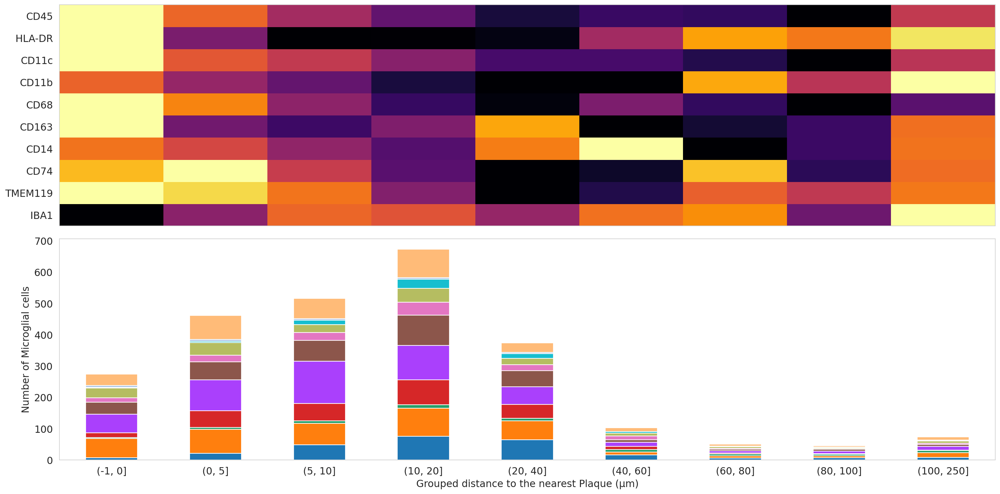

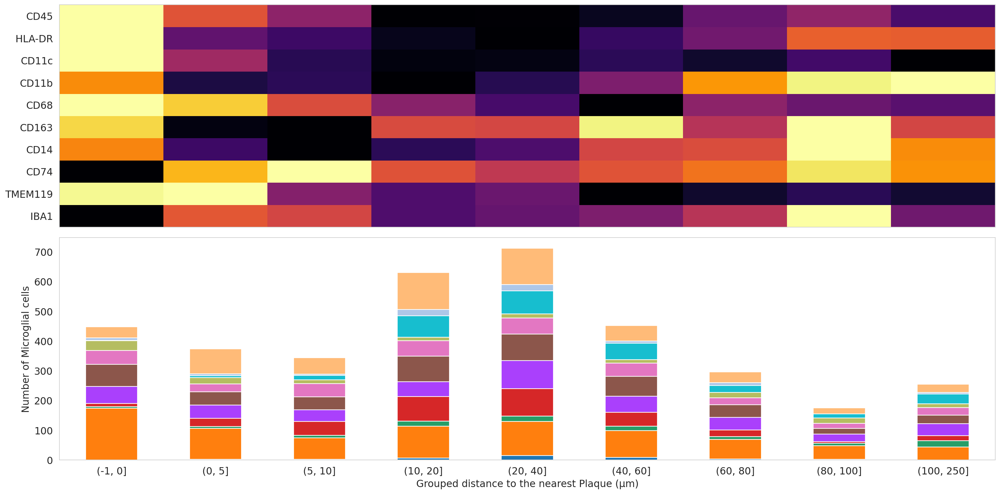

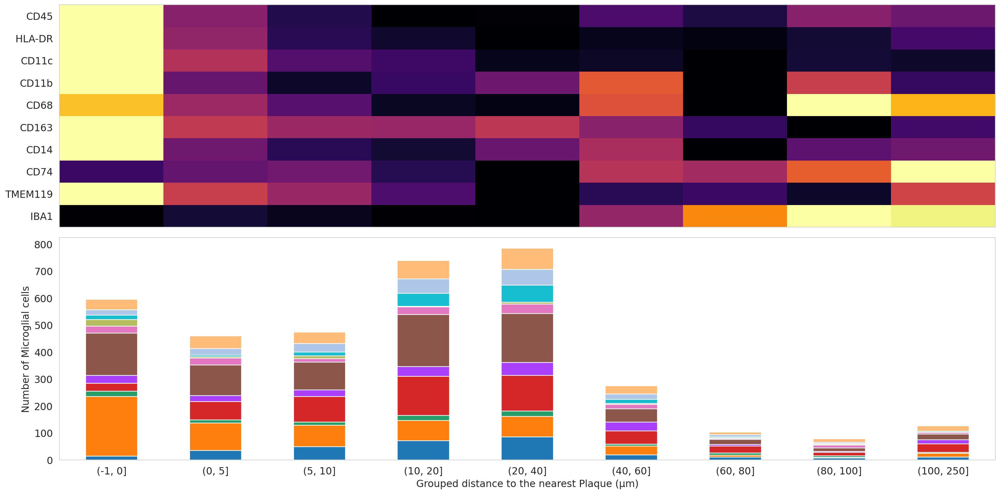

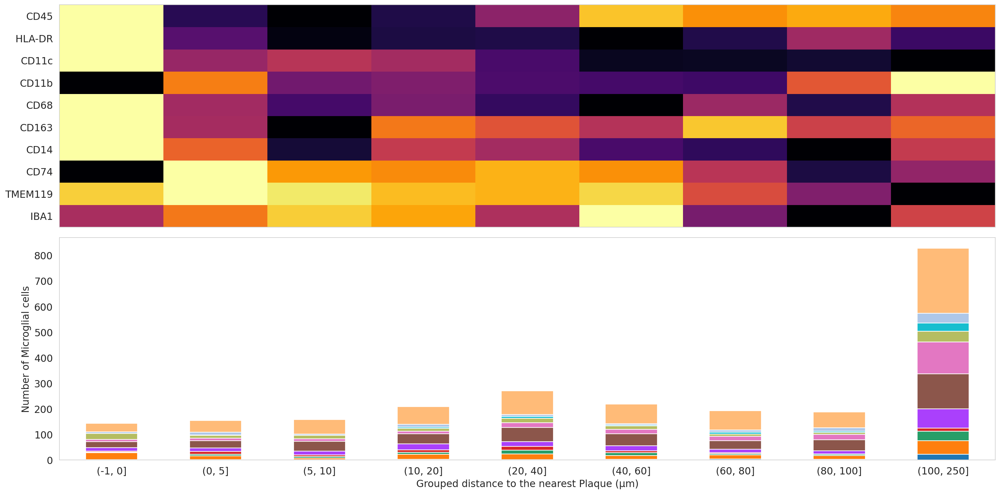

In [172]:
for im in ['3196','2997','3280','3155']:
    ss = adataScaled[(adataScaled.obs.ImageID ==im)]
    ss = ss[ss.obs.Parent=='Grey Matter']
    BINS  =[-1,0,5,10,20,40,60,80,100,250]#,500]#,750,1000]
    out = pd.cut(ss.obs[dt],bins=BINS, right=True)
    ss.obs['Quantile'] = out.values
    ss.obs['leiden'] = ss.obs.leiden.astype(int)

    #sc.tl.dendrogram(adataScaled2, groupby='Decile')
    fig,ax = plt.subplots(2,1,figsize=(20,10))

    matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',show=False,
                     dendrogram=False, use_raw=False, cmap="inferno",standard_scale='var',return_fig=True,swap_axes=True)
    matpl.legend(show=False)
    #ax[0]=matpl.get_axes()
    #ax[0]['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
    #ax[0]['mainplot_ax'].set_xticklabels([])
    #ax[0]['mainplot_ax'].set_ylabel(f'Protein')
    #ax[0]['mainplot_ax'].set_xlabel(f'Grouped {dt}')
    import numpy as np
    sns.set_style("whitegrid", {'axes.grid' : False})

    #sns.barplot(y=out.value_counts().values, x=out.value_counts().index,ax=ax[1],j orient='v', color='tab:purple')
    #ss.obs[['leiden','Quantile']].set_index('Quantile').plot(kind='bar',stacked=True)
    #ax[1].set_ylabel('No. of cells')
    oDF =ss.obs.groupby(['Quantile','leiden']).size()
    #oDF.columns = ['value']
    oDF = oDF.unstack(level=-1)
    oDFPct = oDF.T#/oDF.sum(axis=1)
    oDFPct
    #oDF.pivot(index='Quantile',columns='leiden')
    #oDF.plot(kind='bar',stacked=True)
    ax[0].pcolor(matpl.values_df.T, cmap='inferno')
    ax[0].set_xticks([])
    ax[0].set_yticks(np.arange(0.5, len(matpl.values_df.T.index), 1), matpl.values_df.T.index)
    ax[0].set_yticklabels(matpl.values_df.T.index.values)

    oDFPct.T.plot(kind='bar',stacked=True,ax=ax[1],color=cMapDict, legend=False)
    ax[1].set_ylabel('Number of Microglial cells')
    ax[1].set_xlabel('Grouped distance to the nearest Plaque (µm)')
    ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation = 0)

    plt.tight_layout()
    plt.savefig(f'finalFiguresv4/{im}_Distance_Avg_Expression_NumCells50um.png')

In [173]:
ss.obs['Quantile'].value_counts()

(100, 250]    828
(20, 40]      270
(40, 60]      218
(10, 20]      209
(60, 80]      192
(80, 100]     188
(5, 10]       158
(0, 5]        154
(-1, 0]       143
Name: Quantile, dtype: int64

In [174]:
ax[1].get_xticks()

array([0, 1, 2, 3, 4, 5, 6, 7, 8])

Trying to set attribute `.obs` of view, copying.


Text(0.5, 0, 'Grouped Distance to nearest Plaque (µm)')

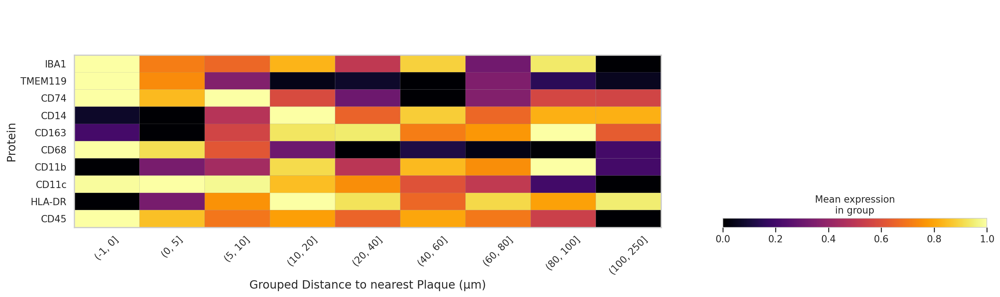

In [175]:
ss = adataScaled[(adataScaled.obs.ImageID =='1796')]
ss = ss[ss.obs.Parent=='Grey Matter']

out = pd.cut(ss.obs[dt],bins=BINS)
ss.obs['Quantile'] = out.values

#sc.tl.dendrogram(adataScaled2, groupby='Decile')
fig,ax = plt.subplots(1,1,figsize=(20,5))

matpl=sc.pl.matrixplot(ss, var_names = protDF.columns,groupby='Quantile',
                 dendrogram=False, use_raw=False, cmap="inferno",standard_scale='var',return_fig=True,swap_axes=True,ax=ax)
ax=matpl.get_axes()
ax['mainplot_ax'].set_xticklabels(out.cat.categories, rotation=45)
ax['mainplot_ax'].set_ylabel(f'Protein')
ax['mainplot_ax'].set_xlabel(f'Grouped {dt}')

Trying to set attribute `.obs` of view, copying.


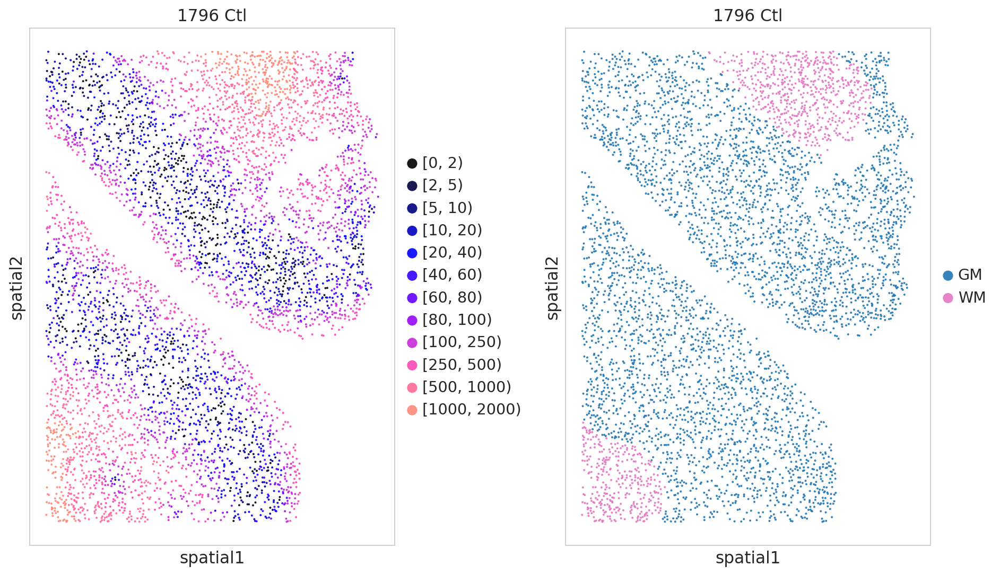

In [111]:
#ss = adataScaled[(adataScaled.obs.ImageType =='AD')]
#ss = ss[ss.obs.Parent=='Grey Matter']
ss = adataScaled[(adataScaled.obs.ImageID.isin(['1796']))]
#ss = ss[ss.obs.Parent=='Grey Matter']
from matplotlib.colors import Colormap as CM
from pylab import *
cmap = cm.get_cmap('gnuplot2', 17)    
cList = [matplotlib.colors.rgb2hex(cmap(i)) for i in range(cmap.N)]
BINS  =[0,2,5,10,20,40,60,80,100,250,500,1000,2000]

out = pd.cut(ss.obs[dt],bins=BINS, right=False)
ss.obs['Quantile'] = out.values
ss.obs['QuantileC'] = out.cat.codes.values

fig,ax=plt.subplots(1,2,figsize=(12,7))
sc.pl.scatter(ss, basis='spatial',color=['Quantile'],ax=ax[0],size=13.0,alpha=0.9,palette=cList,
                  show=False, title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0])
sc.pl.scatter(ss, basis='spatial',color=['Region'],ax=ax[1],size=13.0,alpha=0.9, 
                  show=False, legend_loc='right margin', title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0])
plt.tight_layout()
plt.savefig('finalFiguresv3/1796_Distance50um.png', dpi=300)

Trying to set attribute `.obs` of view, copying.


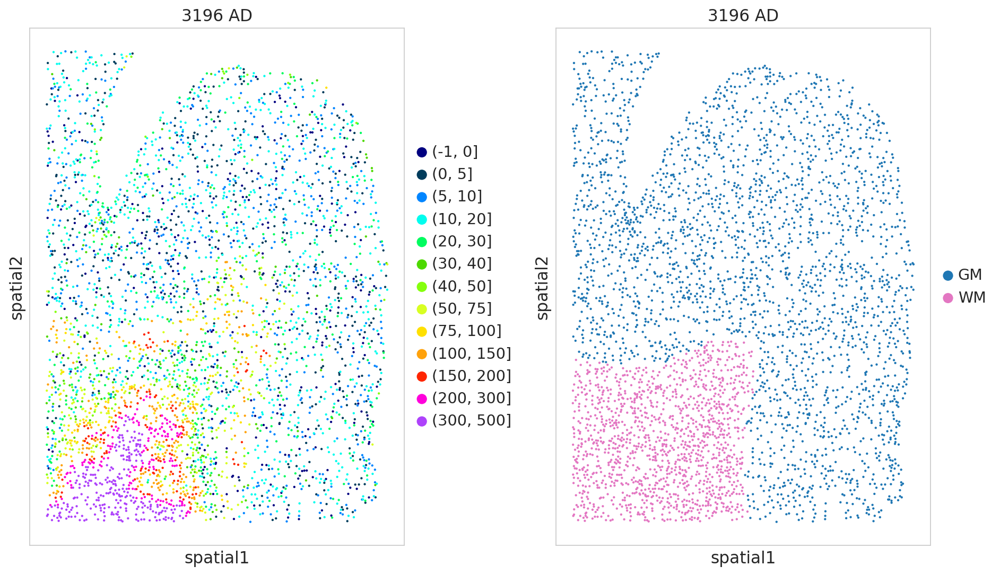

In [130]:
#ss = adataScaled[(adataScaled.obs.ImageType =='AD')]
#ss = ss[ss.obs.Parent=='Grey Matter']
IMList = ['3196']#,'2997','3155','3280','1796']
BINS  =[-1, 0,5,10,20,30,40,50,75,100,150,200,300,500]#[0,2,5,10,20,40,60,80,100,250,500,750,1000]

for im in IMList:
    ss = adataScaled[(adataScaled.obs.ImageID.isin([im]))]
    from matplotlib.colors import Colormap as CM
    from pylab import *
    cmap = cm.get_cmap('gist_ncar', 15)    
    cList = [matplotlib.colors.rgb2hex(cmap(i)) for i in range(cmap.N)]

    out = pd.cut(ss.obs[dt].clip(0,499),bins=BINS, right=True)
    ss.obs['Quantile'] = out.values
    ss.obs['QuantileC'] = out.cat.codes.values

    fig,ax=plt.subplots(1,2,figsize=(12,7))
    sc.pl.scatter(ss, basis='spatial',color=['Quantile'],ax=ax[0],size=15.0,alpha=1,palette=cList,
                      show=False, title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0])
    sc.pl.scatter(ss, basis='spatial',color=['Region'],ax=ax[1],size=15.0,alpha=1, 
                      show=False, legend_loc='right margin', title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0])
    plt.tight_layout()
    plt.savefig(f'finalFiguresv4/{im}_Distance50um.png', dpi=300)

Trying to set attribute `.obs` of view, copying.


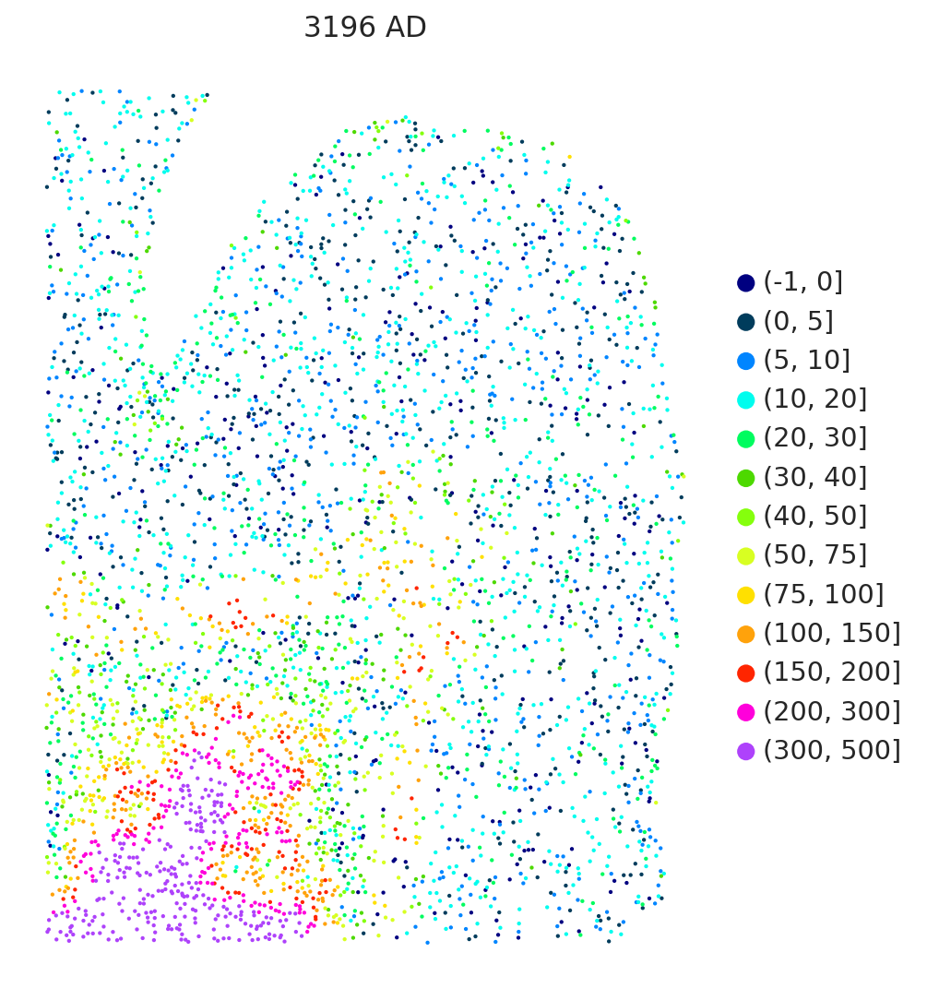

In [144]:
#ss = adataScaled[(adataScaled.obs.ImageType =='AD')]
#ss = ss[ss.obs.Parent=='Grey Matter']
IMList = ['3196']#,'2997','3155','3280','1796']
BINS  =[-1, 0,5,10,20,30,40,50,75,100,150,200,300,500]#[0,2,5,10,20,40,60,80,100,250,500,750,1000]

for im in IMList:
    ss = adataScaled[(adataScaled.obs.ImageID.isin([im]))]
    from matplotlib.colors import Colormap as CM
    from pylab import *
    cmap = cm.get_cmap('gist_ncar', 15)    
    cList = [matplotlib.colors.rgb2hex(cmap(i)) for i in range(cmap.N)]

    out = pd.cut(ss.obs[dt].clip(0,499),bins=BINS, right=True)
    ss.obs['Quantile'] = out.values
    ss.obs['QuantileC'] = out.cat.codes.values

    fig,ax=plt.subplots(1,1,figsize=(6.5,7))
    sc.pl.scatter(ss, basis='spatial',color=['Quantile'],ax=ax,size=15.0,alpha=1,palette=cList,
                      show=False, title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0])
    #sc.pl.scatter(ss, basis='spatial',color=['Region'],ax=ax[1],size=15.0,alpha=1, 
    #                  show=False, legend_loc='right margin', title=ss.obs.ImageID[0]+' '+ss.obs.ImageType[0])
    plt.axis('off')
    #plt.legend(['[0]']+ax.get_legend_handles_labels()[1:][0][1:])
    plt.tight_layout()
    plt.savefig(f'finalFiguresv4/{im}_Distance50um_p1.png', dpi=300)

In [146]:
for x in ax.get_legend_handles_labels()[1:][0][1:]:
    print(x)

(0, 5]
(5, 10]
(10, 20]
(20, 30]
(30, 40]
(40, 50]
(50, 75]
(75, 100]
(100, 150]
(150, 200]
(200, 300]
(300, 500]


In [113]:
out.value_counts().sort()

AttributeError: 'Series' object has no attribute 'sort'

In [ ]:
ss = adataScaled[(adataScaled.obs.ImageType =='AD')]
out = pd.cut(ss.obs[dt],bins=[0,5,10,20,30,40,50,60,70,80,100,250,500,1000])
ss.obs['Quantile'] = out.values

outDF = pd.DataFrame(ss.X,columns=ss.var_names)
outDF[ss.obs.columns] = ss.obs.values
outDF
for iD in sorted(ss.var_names):
    fig,ax = plt.subplots(1,1,figsize=(15,5))
    sns.barplot(data=outDF,x='Quantile', y=iD,ax=ax, color='r')
    ax.set_xticklabels(out.cat.categories, rotation=45)
    ax.set_ylabel(f'Avg. {iD} expression')
    ax.set_xlabel('Quantile of ' + dt)
    plt.tight_layout()
    plt.savefig(f'finalFiguresv3/{iD}.png')

In [ ]:
combinedDF['CollagenIV'].hist(bins=100)

In [ ]:
adataScaled

In [ ]:
Annot3026 = adataScaled[adataScaled.obs.ImageID.isin(['3026'])]
print(Annot3026.obs.spatial_X.max(), Annot3026.obs.spatial_Y.max())
Annot3026 = Annot3026[(16604 < Annot3026.obs.spatial_X) &( Annot3026.obs.spatial_X < 21913) & (8611 < Annot3026.obs.spatial_Y) &( Annot3026.obs.spatial_Y < 10618)]

Annot3026.obs

In [ ]:
fig,ax=plt.subplots(1,2,figsize=(10,4))
sc.pl.scatter(Annot3026, basis='spatial',color=['louvain'],ax=ax[0],size=14.0,alpha=0.9,palette=cList,
                  show=False, title=Annot3026.obs.ImageID[0]+' '+Annot3026.obs.ImageType[0])
sc.pl.scatter(Annot3026, basis='spatial',color=['Region'],ax=ax[1],size=14.0,alpha=0.9, 
                  show=False, legend_loc='right margin', title=Annot3026.obs.ImageID[0]+' '+Annot3026.obs.ImageType[0])

In [114]:
Annot3155 = adataScaled[adataScaled.obs.ImageID.isin(['3155'])]
print(Annot3155.obs.spatial_X.max(), Annot3155.obs.spatial_Y.max())
Annot3155 = Annot3155[(5 < Annot3155.obs.spatial_X) &( Annot3155.obs.spatial_X < 5297) & (0 < Annot3155.obs.spatial_Y) &( Annot3155.obs.spatial_Y < 1991) ]

Annot3155.obs

26095.4217585693 17557.375652173912


,spatial_X,spatial_Y,Area,Area (µm^2),ImageID,ImageType,Parent,Distance to nearest Plaque (µm),ImageID_CellID,numCellCentroids,louvain,leiden,Region
92709,1072.364188,1987.723824,659,126.9785,3155,AD,Grey Matter,41.4139,3155_15829,2.0,3,3,GM
92715,3607.885856,1978.509926,1612,278.3129,3155,AD,Grey Matter,68.7604,3155_15835,2.0,7,7,GM
92718,2191.417655,1978.357049,759,141.2216,3155,AD,Grey Matter,45.8410,3155_15838,1.0,9,9,GM
92742,5053.541993,1969.197088,893,173.1269,3155,AD,Grey Matter,98.6396,3155_15862,1.0,4,4,GM
92757,3178.457367,1945.144432,3448,608.6143,3155,AD,Grey Matter,18.5654,3155_15877,2.0,5,5,GM
...,...,...,...,...,...,...,...,...,...,...,...,...,...
93893,5263.604773,83.557044,4777,835.7925,3155,AD,Grey Matter,0.0000,3155_17013,3.0,6,6,GM
93894,5167.402364,56.379753,1946,338.9889,3155,AD,Grey Matter,0.0000,3155_17014,1.0,8,8,GM
93895,4142.937282,39.933798,287,60.4626,3155,AD,Grey Matter,20.1903,3155_17015,1.0,3,3,GM
93897,3129.372193,49.236364,935,165.4352,3155,AD,Grey Matter,0.0000,3155_17017,1.0,3,3,GM


In [115]:
(0.3774)*adataScaled.obs.groupby('ImageID')['Area'].min()

ImageID
1796    70.1964
1873    76.2348
2997    61.8936
3026    75.8574
3155    74.3478
3196    69.8190
3280    76.2348
3628    83.0280
Name: Area, dtype: float64

In [116]:
adataScaled.obs.spatial_X.max()

26100.31279620853

In [105]:
gliaDF[gliaDF['Area µm^2']>=100].groupby('ImageID').size()

ImageID
1796    5116
1873    4358
2997    4855
3026    6852
3155    6610
3196    3697
3280    9245
3628    6087
dtype: int64

In [106]:
gliaDF[gliaDF['Area µm^2']>=0].groupby('ImageID').size()

ImageID
1796     6151
1873     5410
2997     5670
3026     8391
3155     8166
3196     4231
3280    10594
3628     7011
dtype: int64

In [107]:
#sns.barplot(data=adataScaled.obs[adataScaled.obs['Area (µm^2)']>=600].groupby('ImageType').size(),x='ImageType')

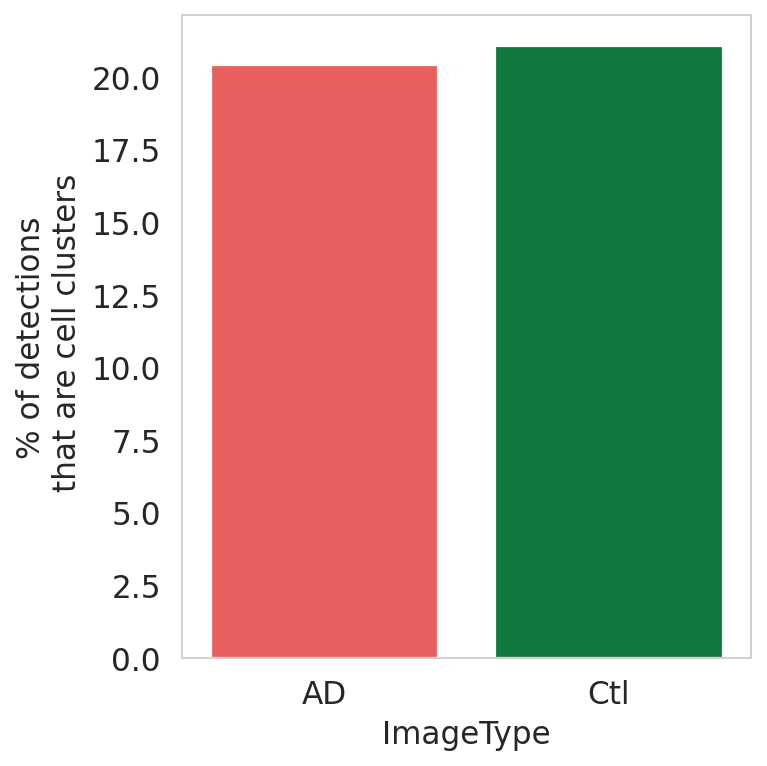

In [131]:
#sizeDF = pd.DataFrame(adataScaled.obs[adataScaled.obs['Area (µm^2)']>=600].groupby('ImageType').size())
sizeDF = pd.DataFrame(100*adataScaled.obs[adataScaled.obs['numCellCentroids']>1].groupby('ImageType').size()/adataScaled.obs.groupby('ImageType').size())
sizeDF.columns=['% of detections\n that are cell clusters']
#fig,ax=plt.subplots(1,1,figsize=(4,5))
#sns.catplot(x=sizeDF.index.values,y=sizeDF['Number of cells'],kind='bar', orient='vertical')
g = sns.catplot(data=sizeDF.reset_index(),x='ImageType',y='% of detections\n that are cell clusters', kind='bar',  palette=sc.pl.palettes.godsnot_102[3:5])
g.despine(bottom = False, left = False, right=False, top=False)
plt.savefig('finalFiguresv3/ADCTL_Clusters_50um.png',dpi=300)

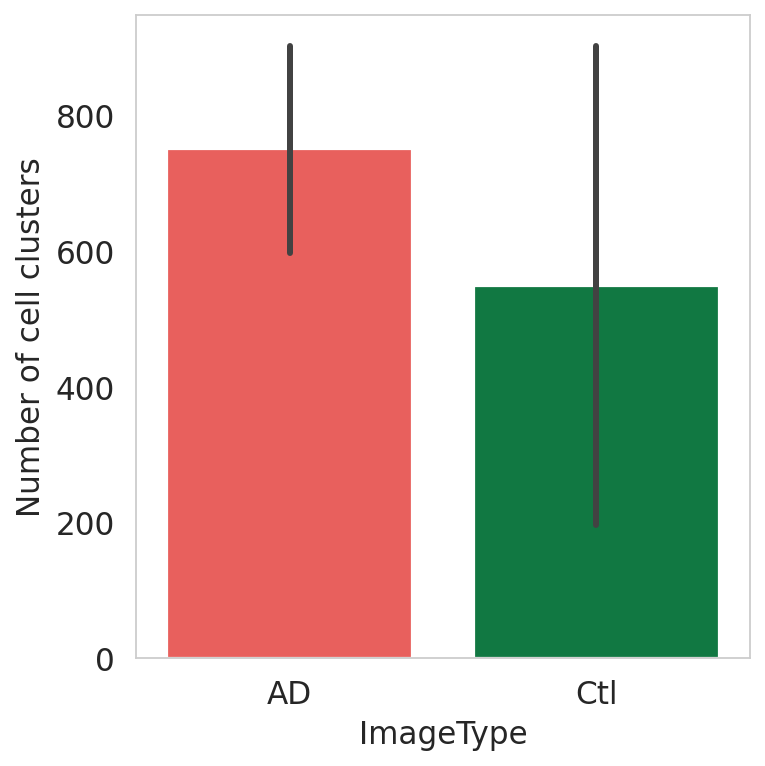

In [132]:
sizeDF = pd.DataFrame(adataScaled.obs[adataScaled.obs['Area (µm^2)']>=600].groupby(['ImageType','Parent']).size())
sizeDF.columns=['Number of cell clusters']

#sns.catplot(x=sizeDF.index.values,y=sizeDF['Number of cells'],kind='bar', orient='vertical')
g = sns.catplot(data=sizeDF.reset_index(),x='ImageType',y='Number of cell clusters', kind='bar', palette=sc.pl.palettes.godsnot_102[3:5])
g.despine(bottom = False, left = False, right=False, top=False)
plt.savefig('finalFiguresv3/ADCTL_Clusters.png',dpi=300)

In [133]:
sizeDF.index.values

array([('AD', 'Grey Matter'), ('AD', 'White Matter'),
       ('Ctl', 'Grey Matter'), ('Ctl', 'White Matter')], dtype=object)

In [134]:
adataScaled.obs

,spatial_X,spatial_Y,Area,Area (µm^2),ImageID,ImageType,Parent,Distance to nearest Plaque (µm),ImageID_CellID,numCellCentroids,louvain,leiden,Region
1790,13574.364621,11980.732852,277,61.1722,1796,Ctl,Grey Matter,348.1208,1796_1791,1.0,0,0,GM
1794,13491.046358,11876.990066,302,53.9108,1796,Ctl,Grey Matter,308.6889,1796_1795,1.0,0,0,GM
1795,14676.054795,11854.070776,438,82.4693,1796,Ctl,Grey Matter,432.9919,1796_1796,1.0,8,8,GM
1796,13395.029412,11854.349790,952,185.9480,1796,Ctl,Grey Matter,303.5456,1796_1797,1.0,0,0,GM
1797,15292.282609,11814.693237,828,171.9872,1796,Ctl,Grey Matter,353.9196,1796_1798,1.0,7,7,GM
...,...,...,...,...,...,...,...,...,...,...,...,...,...
143982,39.883575,15885.947766,1589,269.7662,3628,Ctl,White Matter,NaN,3628_19351,1.0,9,9,WM
143983,331.334215,15758.689594,1134,204.2505,3628,Ctl,White Matter,NaN,3628_19352,1.0,7,7,WM
143986,140.715271,15603.225616,1015,172.7699,3628,Ctl,White Matter,NaN,3628_19355,1.0,6,6,WM
143987,129.878453,15529.645304,1810,347.2530,3628,Ctl,White Matter,NaN,3628_19356,1.0,9,9,WM


In [135]:
annotDF = pd.read_csv('data/annotation_measurements_all.tsv',sep='\t')
annotDF.head()

,Image,Name,Class,Parent,ROI,Centroid X µm,Centroid Y µm,Num Detections,Num Cells,Num Glia,Num Neurons,Num Plaques,Area µm^2,Perimeter µm
0,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,Grey Matter,Image,Geometry,3988.7,3801.2,84527,49062,9946,16356,9163.0,46863945.1,38996.7
1,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,White Matter,White Matter,Image,Polygon,2456.7,6326.9,22607,18043,3432,745,387.0,9861732.5,14238.7
2,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,Grey Matter,Image,Polygon,8106.1,7266.9,4696,2637,567,852,640.0,2920030.3,8591.5
3,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Geometry,3846.9,3829.4,56007,47727,6704,1011,565.0,23064150.6,27546.8
4,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,Grey Matter,Grey Matter,Image,Geometry,7436.1,4080.5,41896,26756,4976,7035,3129.0,18417035.2,40181.6


In [136]:
annotDF.loc[:,'ImageID'] = annotDF.Image.map(imageIDMapQP)
#annotDF.ID = annotDF.ID
annotDF.loc[:,'IDParent'] = annotDF.ImageID+'_'+annotDF.Class
areaParentDict = annotDF[['IDParent','Area µm^2']].groupby('IDParent').sum()['Area µm^2'].to_dict()
annotDF[['IDParent','Area µm^2']].groupby('IDParent').sum()

,Area µm^2
IDParent,
1796_Grey Matter,32907133.6
1796_White Matter,5384738.1
1873_Grey Matter,31681339.2
1873_White Matter,11054063.5
2997_Grey Matter,49783975.4
2997_White Matter,9861732.5
3026_Grey Matter,40413128.5
3026_White Matter,14004157.3
3155_Grey Matter,34857765.8


In [137]:
imageTypeMap = {'2997':'AD',
       '3155':'AD',
       '3196':'AD',
       '3280':'AD',
       '1796':'Ctl',
       '3628':'Ctl',
       '3026':'Ctl',
       '1873':'Ctl'}

In [138]:
Ar = 50
ClustersDF = pd.DataFrame(adataScaled.obs[adataScaled.obs['Area (µm^2)']>=Ar].groupby(['ImageID','Parent']).size()).reset_index()
ClustersDF.columns = [ 'ImageID','Parent','Number of Clusters']
ClustersDF.loc[:,'IDParent'] = ClustersDF.ImageID.astype(str)+'_'+ClustersDF.Parent.astype(str)
ClustersDF.loc[:,'ImageType'] = ClustersDF.ImageID.map(imageTypeMap)
ClustersDF.loc[:,'Region'] = ClustersDF.Parent.map({'Grey Matter':'GM','White Matter':'WM'})

ClustersDF.loc[:,'Area µm^2'] = ClustersDF.IDParent.map(areaParentDict)
ClustersDF.loc[:,'Density'] = 10**6*ClustersDF['Number of Clusters']/ClustersDF['Area µm^2']
ClustersDF

,ImageID,Parent,Number of Clusters,IDParent,ImageType,Region,Area µm^2,Density
0,1796,Grey Matter,4154,1796_Grey Matter,Ctl,GM,32907133.6,126.234027
1,1796,White Matter,917,1796_White Matter,Ctl,WM,5384738.1,170.296119
2,1873,Grey Matter,2922,1873_Grey Matter,Ctl,GM,31681339.2,92.230950
3,1873,White Matter,1599,1873_White Matter,Ctl,WM,11054063.5,144.652688
4,2997,Grey Matter,3692,2997_Grey Matter,AD,GM,49783975.4,74.160409
5,2997,White Matter,1292,2997_White Matter,AD,WM,9861732.5,131.011463
6,3026,Grey Matter,3764,3026_Grey Matter,Ctl,GM,40413128.5,93.138050
7,3026,White Matter,2436,3026_White Matter,Ctl,WM,14004157.3,173.948346
8,3155,Grey Matter,3099,3155_Grey Matter,AD,GM,34857765.8,88.904149
9,3155,White Matter,4086,3155_White Matter,AD,WM,28653050.5,142.602617


[Text(0.5, 1.0, 'Area cutoff >=50 mm$^2$'),
 Text(0, 0.5, 'Microglial cluster density (#/mm$^2$)')]

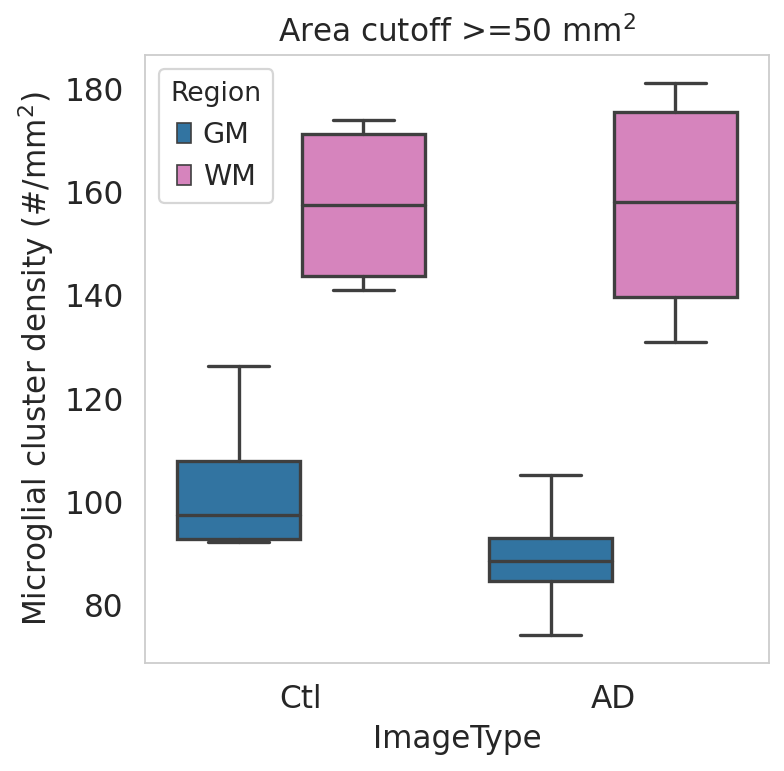

In [139]:
sns.boxplot(data=ClustersDF,x='ImageType',y='Density',hue='Region', palette=['tab:blue','tab:pink'],).set(title=f'Area cutoff >={Ar} mm$^2$',ylabel='Microglial cluster density (#/mm$^2$)')
#sns.boxplot(data=ClustersDF,x='ImageType',y='Density',hue='Parent', palette=['tab:blue','tab:pink'], title='1000 um2')

[Text(0.5, 1.0, 'Area cutoff >=1000 um2')]

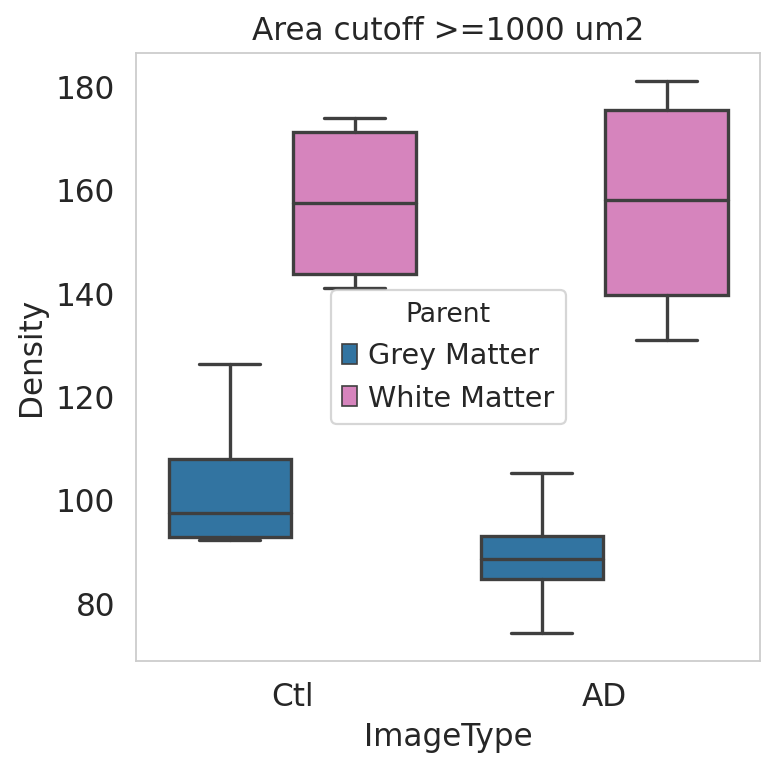

In [140]:
sns.boxplot(data=ClustersDF,x='ImageType',y='Density',hue='Parent', palette=['tab:blue','tab:pink'],).set(title='Area cutoff >=1000 um2')

In [141]:
detectDF = pd.read_csv('McmExport/detection_measurements_post_threshold_IDs.tsv',sep='\t')
plaqueDF = detectDF[detectDF.Class=='Plaques']
plaqueDF

,Image,Name,Class,Parent,ROI,Centroid X µm,Centroid Y µm,Distance to annotation PlaquesA µm,Area µm^2,Length µm,...,ROI: 0.38 µm per pixel: ApoE: Mean,ROI: 0.38 µm per pixel: P2Rx7: Mean,ROI: 0.38 µm per pixel: S100B: Mean,ROI: 0.38 µm per pixel: Trem2: Mean,ROI: 0.38 µm per pixel: GalMac3: Mean,Distance to annotation Other µm,ROI: 0.38 µm per pixel: E5: Mean,Distance to annotation Cells µm,ROI: 0.38 µm per pixel: Olig-2: Mean,ROI: 0.38 µm per pixel: PSD95: Mean
0,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,7977.7,3020.70,0.0,36.6754,31.7712,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,7321.6,6200.20,0.0,111.0254,81.4677,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,5551.9,245.48,0.0,759.0207,270.2663,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,2838.1,856.15,0.0,401.0899,134.0395,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Plaques,Plaques,Image,Polygon,6927.1,598.48,0.0,91.2984,51.7777,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
618087,10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.q...,Plaques,Plaques,Grey Matter,Polygon,2914.9,5622.90,0.0,65.6599,48.5751,...,40.9312,NaN,35.1204,0.0925,9.3204,NaN,NaN,NaN,NaN,NaN
618088,10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.q...,Plaques,Plaques,Grey Matter,Polygon,3984.8,5788.30,0.0,509.3384,179.1532,...,41.8383,NaN,28.0333,5.2543,11.6385,NaN,NaN,NaN,NaN,NaN
618089,10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.q...,Plaques,Plaques,Grey Matter,Polygon,2692.4,7315.60,0.0,26.4917,20.9293,...,65.3422,NaN,24.0749,0.0000,7.8235,NaN,NaN,NaN,NaN,NaN
618090,10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.q...,Plaques,Plaques,Grey Matter,Polygon,3195.8,5068.90,0.0,33.7564,28.0880,...,57.3745,NaN,34.8170,2.7064,12.5787,NaN,NaN,NaN,NaN,NaN


In [142]:
plaqueDF['ImageID'] = plaqueDF.Image.map(imageIDMapQP)
plaqueDF['ImageType'] = plaqueDF.Image.map(imageTypeMapQP)
plDF = plaqueDF[['Image','Parent','Area µm^2','ImageID','ImageType']]#.groupby('ImageID').Parent.value_counts()
plDF = plDF[plDF.Parent !='Image']
plDF

,Image,Parent,Area µm^2,ImageID,ImageType
9142,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,21.1507,2997,AD
9148,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,23.9976,2997,AD
9149,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,29.6268,2997,AD
9150,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,101.4118,2997,AD
9151,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,20.8663,2997,AD
...,...,...,...,...,...
618087,10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.q...,Grey Matter,65.6599,1796,Ctl
618088,10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.q...,Grey Matter,509.3384,1796,Ctl
618089,10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.q...,Grey Matter,26.4917,1796,Ctl
618090,10122021_BaharehNP_1-CtlCortex1796_EDTA_MKT6.q...,Grey Matter,33.7564,1796,Ctl


In [143]:
glDF = adataScaled.obs.groupby(['Parent','ImageID']).size().reset_index()
glDF.columns = ['Parent','ImageID','Num Glia']
glDF.loc[:,'IDParent'] = glDF.ImageID.astype(str)+'_'+glDF.Parent.astype(str)
glDF.index = glDF.IDParent
gliaCountDict = glDF[['Num Glia']].to_dict()['Num Glia']


In [144]:
#annotDF.loc[:,'IDParent'] = annotDF.ImageID.astype(str)+'_'+annotDF.Class.astype(str)
#annotDF.loc[:,'Num Glia'] = annotDF.IDParent.map(gliaCountDict)
annotDF

,Image,Name,Class,Parent,ROI,Centroid X µm,Centroid Y µm,Num Detections,Num Cells,Num Glia,Num Neurons,Num Plaques,Area µm^2,Perimeter µm,ImageID,IDParent
0,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,Grey Matter,Image,Geometry,3988.70,3801.20,84527,49062,9946,16356,9163.0,46863945.1,38996.7,2997,2997_Grey Matter
1,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,White Matter,White Matter,Image,Polygon,2456.70,6326.90,22607,18043,3432,745,387.0,9861732.5,14238.7,2997,2997_White Matter
2,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,Grey Matter,Image,Polygon,8106.10,7266.90,4696,2637,567,852,640.0,2920030.3,8591.5,2997,2997_Grey Matter
3,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Geometry,3846.90,3829.40,56007,47727,6704,1011,565.0,23064150.6,27546.8,3155,3155_White Matter
4,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,Grey Matter,Grey Matter,Image,Geometry,7436.10,4080.50,41896,26756,4976,7035,3129.0,18417035.2,40181.6,3155,3155_Grey Matter
5,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,Grey Matter,Grey Matter,Image,Geometry,2212.60,1678.50,33912,23554,4908,5103,347.0,16440730.6,18498.2,3155,3155_Grey Matter
6,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Polygon,9034.90,1747.50,11276,9055,1455,505,261.0,3732911.4,10854.8,3155,3155_White Matter
7,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Polygon,6311.20,5497.10,2555,2020,329,176,30.0,1128267.2,4889.5,3155,3155_White Matter
8,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Polygon,8815.00,5648.80,1759,985,301,85,388.0,727721.3,3522.2,3155,3155_White Matter
9,10122021_BaharehNP_ADCortex_EDTA.qptiff - reso...,Grey Matter,Grey Matter,Image,Geometry,3085.20,3410.20,77242,39402,6390,14674,16776.0,29138380.3,32031.7,3196,3196_Grey Matter


In [145]:
densityDF = pd.DataFrame(index=[x for x in range(16)],columns = ['ImageID','ImageType','Parent','Glia Density','Neuron Density','Cell Density','Plaque Density'])
annotDF.loc[:,'ImageType'] = annotDF.ImageID.map(imageTypeMap)

nRow = 0
for imID in annotDF.ImageID.unique():
    nDF = annotDF[annotDF.ImageID == imID][['Class','Num Glia','Num Plaques','Num Neurons','Num Cells','Area µm^2']].groupby('Class').sum()
    nDF.loc[:,'IDParent'] = imID+'_'+nDF.index.astype(str)
    nDF.loc[:,'Num Glia']= nDF.IDParent.map(gliaCountDict)
    iT = annotDF[annotDF.ImageID == imID].ImageType.values[0]
    plArea = plDF[plDF.ImageID == imID][['Parent','Area µm^2']].groupby('Parent').sum()
    
    for ix, row in nDF.iterrows():
        try:
            densityDF.iloc[nRow] =  [imID, iT, ix, 10**6 *row['Num Glia']/row['Area µm^2'],10**6 *row['Num Neurons']/row['Area µm^2'],
                                 10**6 *row['Num Cells']/row['Area µm^2'],plArea.loc[ix]['Area µm^2'] /row['Area µm^2']]
        except KeyError:
            densityDF.iloc[nRow] =  [imID, iT, ix, 10**6 *row['Num Glia']/row['Area µm^2'],10**6 *row['Num Neurons']/row['Area µm^2'],
                                 10**6 *row['Num Cells']/row['Area µm^2'],0.0/row['Area µm^2']]
        nRow+=1
densityDF

,ImageID,ImageType,Parent,Glia Density,Neuron Density,Cell Density,Plaque Density
0,2997,AD,Grey Matter,74.160409,345.653393,1038.466687,0.041392
1,2997,AD,White Matter,131.011463,75.544535,1829.597386,0.005907
2,3155,AD,Grey Matter,88.904149,348.215088,1443.293879,0.035431
3,3155,AD,White Matter,142.602617,62.017829,2086.584114,0.005881
4,3196,AD,Grey Matter,88.234143,503.596969,1352.237139,0.111806
5,3196,AD,White Matter,173.652138,89.20125,2226.732398,0.015784
6,3280,AD,Grey Matter,105.171032,423.576619,1200.066264,0.068363
7,3280,AD,White Matter,181.186425,26.03712,2552.545983,0.003423
8,1796,Ctl,Grey Matter,126.234027,424.892674,1273.887921,0.051382
9,1796,Ctl,White Matter,170.296119,115.697363,1895.171095,0.000056


In [146]:
nameMap = {'Grey Matter':'GM','White Matter':'WM'}
densityDF.loc[:,'Region'] = densityDF.Parent.map(nameMap)

In [147]:
#!pip install statannot

In [148]:
from statannot import add_stat_annotation


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WM_AD v.s. WM_Ctl: t-test independent samples with Bonferroni correction, P_val=4.796e-01 stat=1.305e+00
GM_AD v.s. GM_Ctl: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=-2.883e-02
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WM_AD v.s. WM_Ctl: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=-2.663e-02
GM_AD v.s. GM_Ctl: t-test independent samples with Bonferroni correction, P_val=4.214e-01 stat=-1.401e+00


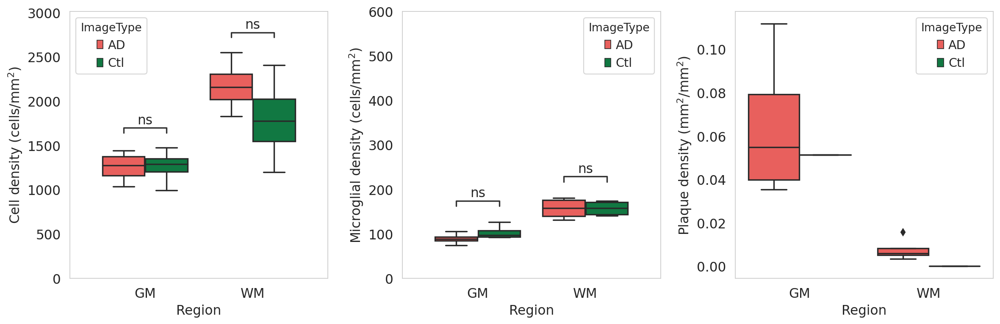

In [149]:
import seaborn as sns
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1,3,figsize=(15,5))
sns.boxplot(data=densityDF, y='Cell Density',x='Region',hue='ImageType',ax=ax[0],palette=sc.pl.palettes.godsnot_102[3:5])
ax[0].set_ylabel('Cell density ($\mathrm{cells/mm^2}$)')
ax[0].set_ylim(0,2800)#('Cell density ($\mathrm{cells/mm^2}$)')

add_stat_annotation(ax[0], data=densityDF, y='Cell Density',x='Region',hue='ImageType',
                                   box_pairs=[(("GM","AD"),("GM", "Ctl")), (("WM","AD"),("WM", "Ctl"))],
                                   test='t-test_ind', text_format='star',
                                   loc='inside', verbose=2)
sns.boxplot(data=densityDF, y='Glia Density',x='Region',hue='ImageType',ax=ax[1],palette=sc.pl.palettes.godsnot_102[3:5])
ax[1].set_ylabel('Microglial density ($\mathrm{cells/mm^2}$)')
#ax[1].set_ylim(0,500)
ax[1].set_ylim(0,600)
add_stat_annotation(ax[1], data=densityDF, y='Glia Density',x='Region',hue='ImageType',
                                   box_pairs=[(("GM","AD"),("GM", "Ctl")), (("WM","AD"),("WM", "Ctl"))],
                                   test='t-test_ind', text_format='star',
                                   loc='inside', verbose=2)
sns.boxplot(data=densityDF[densityDF['Plaque Density']!=0], y='Plaque Density',x='Region',hue='ImageType',ax=ax[2],palette=sc.pl.palettes.godsnot_102[3:5])
ax[2].set_ylabel('Plaque density ($\mathrm{mm^2/mm^2}$)')
#ax[2].set_ylim(0,600)

plt.tight_layout()
plt.savefig('finalFiguresv3/Densities_50um.png',dpi=300)

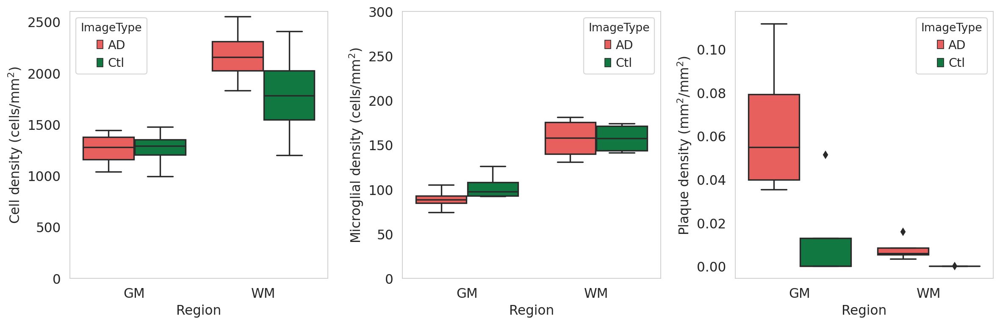

In [150]:
import seaborn as sns
import matplotlib.pyplot as plt
fig,ax = plt.subplots(1,3,figsize=(15,5))
sns.boxplot(data=densityDF, y='Cell Density',x='Region',hue='ImageType',ax=ax[0],palette=sc.pl.palettes.godsnot_102[3:5])
ax[0].set_ylabel('Cell density ($\mathrm{cells/mm^2}$)')
ax[0].set_ylim(0,2600)#('Cell density ($\mathrm{cells/mm^2}$)')
#ax[0].set_xlabel('')

sns.boxplot(data=densityDF, y='Glia Density',x='Region',hue='ImageType',ax=ax[1],palette=sc.pl.palettes.godsnot_102[3:5])
ax[1].set_ylabel('Microglial density ($\mathrm{cells/mm^2}$)')
ax[1].set_ylim(0,300)
#ax[1].set_xlabel('')

sns.boxplot(data=densityDF[densityDF['Plaque Density']>-1], y='Plaque Density',x='Region',hue='ImageType',ax=ax[2],palette=sc.pl.palettes.godsnot_102[3:5])
ax[2].set_ylabel('Plaque density ($\mathrm{mm^2/mm^2}$)')
#ax[2].set_ylim(0,600)
#ax[0].set_xlabel('')

plt.tight_layout()
plt.savefig('finalFiguresv3/Densities_50um_zerosManual.png',dpi=300)

In [151]:
adataScaled.obs

,spatial_X,spatial_Y,Area,Area (µm^2),ImageID,ImageType,Parent,Distance to nearest Plaque (µm),ImageID_CellID,numCellCentroids,louvain,leiden,Region
1790,13574.364621,11980.732852,277,61.1722,1796,Ctl,Grey Matter,348.1208,1796_1791,1.0,0,0,GM
1794,13491.046358,11876.990066,302,53.9108,1796,Ctl,Grey Matter,308.6889,1796_1795,1.0,0,0,GM
1795,14676.054795,11854.070776,438,82.4693,1796,Ctl,Grey Matter,432.9919,1796_1796,1.0,8,8,GM
1796,13395.029412,11854.349790,952,185.9480,1796,Ctl,Grey Matter,303.5456,1796_1797,1.0,0,0,GM
1797,15292.282609,11814.693237,828,171.9872,1796,Ctl,Grey Matter,353.9196,1796_1798,1.0,7,7,GM
...,...,...,...,...,...,...,...,...,...,...,...,...,...
143982,39.883575,15885.947766,1589,269.7662,3628,Ctl,White Matter,NaN,3628_19351,1.0,9,9,WM
143983,331.334215,15758.689594,1134,204.2505,3628,Ctl,White Matter,NaN,3628_19352,1.0,7,7,WM
143986,140.715271,15603.225616,1015,172.7699,3628,Ctl,White Matter,NaN,3628_19355,1.0,6,6,WM
143987,129.878453,15529.645304,1810,347.2530,3628,Ctl,White Matter,NaN,3628_19356,1.0,9,9,WM


(0.0, 200.0)

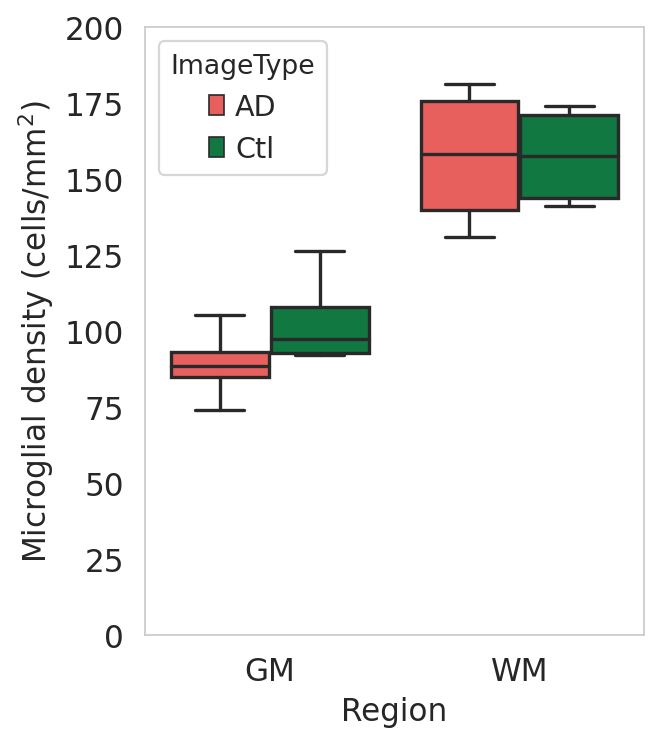

In [155]:
fig,ax = plt.subplots(1,1,figsize=(4,5))

sns.boxplot(data=densityDF, y='Glia Density',x='Region',hue='ImageType',ax=ax,palette=sc.pl.palettes.godsnot_102[3:5])
ax.set_ylabel('Microglial density ($\mathrm{cells/mm^2}$)')
ax.set_ylim(0,200)
#ax[1].set_xlabel('')

In [129]:
densityDF.to_csv("Density_data_50um.csv")

In [130]:
densityDF

,ImageID,ImageType,Parent,Glia Density,Neuron Density,Cell Density,Plaque Density,Region
0,2997,AD,Grey Matter,74.160409,345.653393,1038.466687,0.041392,GM
1,2997,AD,White Matter,131.011463,75.544535,1829.597386,0.005907,WM
2,3155,AD,Grey Matter,88.904149,348.215088,1443.293879,0.035431,GM
3,3155,AD,White Matter,142.602617,62.017829,2086.584114,0.005881,WM
4,3196,AD,Grey Matter,88.234143,503.596969,1352.237139,0.111806,GM
5,3196,AD,White Matter,173.652138,89.20125,2226.732398,0.015784,WM
6,3280,AD,Grey Matter,105.171032,423.576619,1200.066264,0.068363,GM
7,3280,AD,White Matter,181.186425,26.03712,2552.545983,0.003423,WM
8,1796,Ctl,Grey Matter,126.234027,424.892674,1273.887921,0.051382,GM
9,1796,Ctl,White Matter,170.296119,115.697363,1895.171095,0.000056,WM


In [154]:
annDF = pd.read_csv('McmExport/annots_all.tsv', sep='\t')
annDF

,Image,Name,Class,Parent,ROI,Centroid X µm,Centroid Y µm,Num Detections,Num Cells,Num Glia,Num Neurons,Num Plaques,Area µm^2,Perimeter µm
0,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,Grey Matter,Image,Geometry,3988.70,3800.90,84526,49060,9947,16356,9163.0,46863945.1,38996.70
1,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,White Matter,White Matter,Image,Polygon,2456.70,6326.90,22607,18043,3432,745,387.0,9861732.5,14238.70
2,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,Grey Matter,Image,Polygon,8106.10,7266.90,4696,2637,567,852,640.0,2920030.3,8591.50
3,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,PathAnnotationObject,NaN,Image,Rectangle,4317.30,3840.80,24,18,2,2,2.0,15356.2,497.42
4,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Geometry,3846.90,3829.40,56007,47727,6704,1011,565.0,23064150.6,27546.80
5,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,Grey Matter,Grey Matter,Image,Geometry,7436.10,4080.50,41896,26756,4976,7035,3129.0,18417035.2,40181.60
6,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,Grey Matter,Grey Matter,Image,Geometry,2212.60,1678.50,33912,23554,4908,5103,347.0,16440730.6,18498.20
7,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Polygon,9034.90,1747.50,11276,9055,1455,505,261.0,3732911.4,10854.80
8,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Polygon,6311.20,5497.10,2555,2020,329,176,30.0,1128267.2,4889.50
9,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Polygon,8815.00,5648.80,1759,985,301,85,388.0,727721.3,3522.20


In [155]:
annDF['ImageType'] = annDF.Image.map(imageTypeMapQP)
annDF['ImageID'] = annDF.Image.map(imageIDMapQP)
annDF

,Image,Name,Class,Parent,ROI,Centroid X µm,Centroid Y µm,Num Detections,Num Cells,Num Glia,Num Neurons,Num Plaques,Area µm^2,Perimeter µm,ImageType,ImageID
0,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,Grey Matter,Image,Geometry,3988.70,3800.90,84526,49060,9947,16356,9163.0,46863945.1,38996.70,AD,2997
1,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,White Matter,White Matter,Image,Polygon,2456.70,6326.90,22607,18043,3432,745,387.0,9861732.5,14238.70,AD,2997
2,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,Grey Matter,Grey Matter,Image,Polygon,8106.10,7266.90,4696,2637,567,852,640.0,2920030.3,8591.50,AD,2997
3,10202021_BaharehNP_2997-ADCortex_EDTA.qptiff -...,PathAnnotationObject,NaN,Image,Rectangle,4317.30,3840.80,24,18,2,2,2.0,15356.2,497.42,AD,2997
4,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Geometry,3846.90,3829.40,56007,47727,6704,1011,565.0,23064150.6,27546.80,AD,3155
5,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,Grey Matter,Grey Matter,Image,Geometry,7436.10,4080.50,41896,26756,4976,7035,3129.0,18417035.2,40181.60,AD,3155
6,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,Grey Matter,Grey Matter,Image,Geometry,2212.60,1678.50,33912,23554,4908,5103,347.0,16440730.6,18498.20,AD,3155
7,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Polygon,9034.90,1747.50,11276,9055,1455,505,261.0,3732911.4,10854.80,AD,3155
8,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Polygon,6311.20,5497.10,2555,2020,329,176,30.0,1128267.2,4889.50,AD,3155
9,11162021_Bahareh-3155_EDTA.qptiff - resolution #1,White Matter,White Matter,Image,Polygon,8815.00,5648.80,1759,985,301,85,388.0,727721.3,3522.20,AD,3155


In [168]:
(annDF[['ImageType','Num Cells','Num Glia','Num Neurons', 'Num Plaques']].groupby(['ImageType']).sum())/4

,Num Cells,Num Glia,Num Neurons,Num Plaques
ImageType,,,,
AD,92594.0,17207.75,15737.50,11063.0
Ctl,62832.5,16158.00,17820.25,1220.5


In [165]:
combinedDF.groupby(['ImageType']).size()/4

ImageType
AD     6568.75
Ctl    5467.75
dtype: float64

In [170]:
133463/8

16682.875

In [172]:
6000/92000


0.06521739130434782

In [173]:
combinedDF

,CellID,DAPI_1,Neurofilament,Vimentin,CD31,Claudin5,SMA,AQP4,A-Beta,Trem2,...,E2,E6,E10,ImageID,ImageType,ImageID_CellID,Parent,Distance to nearest Plaque (µm),Area (µm^2),numCellCentroids
1790,1791,28.877256,0.000000,1.400722,5.963899,2.140794,0.238267,10.574007,0.487365,11.162455,...,NaN,NaN,NaN,1796,Ctl,1796_1791,Grey Matter,348.1208,61.1722,1.0
1794,1795,112.546358,0.000000,1.963576,7.473510,3.784768,0.397351,42.903974,0.413907,37.440397,...,NaN,NaN,NaN,1796,Ctl,1796_1795,Grey Matter,308.6889,53.9108,1.0
1795,1796,19.378995,0.000000,7.027397,18.422374,3.525114,0.301370,19.662100,1.310502,21.894977,...,NaN,NaN,NaN,1796,Ctl,1796_1796,Grey Matter,432.9919,82.4693,1.0
1796,1797,53.852941,0.000000,6.658613,10.142857,3.817227,0.370798,16.794118,0.843487,21.373950,...,NaN,NaN,NaN,1796,Ctl,1796_1797,Grey Matter,303.5456,185.9480,1.0
1797,1798,27.753623,0.963768,21.805556,7.724638,3.913043,0.210145,61.521739,1.298309,23.170290,...,NaN,NaN,NaN,1796,Ctl,1796_1798,Grey Matter,353.9196,171.9872,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143982,19351,47.276274,48.823789,1.743864,11.042794,NaN,1.516048,59.017621,NaN,NaN,...,19.049717,32.503461,36.577093,3628,Ctl,3628_19351,White Matter,NaN,269.7662,1.0
143983,19352,28.329806,35.658730,5.673721,3.654321,NaN,0.490300,50.979718,NaN,NaN,...,10.513228,25.935626,27.813051,3628,Ctl,3628_19352,White Matter,NaN,204.2505,1.0
143986,19355,21.517241,10.405911,41.570443,31.878818,NaN,1.089655,92.309360,NaN,NaN,...,20.633498,27.257143,22.902463,3628,Ctl,3628_19355,White Matter,NaN,172.7699,1.0
143987,19356,13.464088,52.393923,3.587845,18.771823,NaN,2.417127,77.316022,NaN,NaN,...,29.188398,37.003867,40.835359,3628,Ctl,3628_19356,White Matter,NaN,347.2530,1.0
